# CHILD Asthma Prediction 
    - Pipeline for multiple time points: Birth, 6m, 1y, 2y, 3y 
    - Identification of critical, stable predictors
    - Identification of minimal set of features 
    - Asthma Risk Stratification Model (0 - No risk, 1 - Minimal risk, 2 - Intermediate risk, 3 - High risk)

In [1]:
# Preferences of autoformatting & Multiple Output
%load_ext nb_black

from IPython.core.interactiveshell import InteractiveShell

InteractiveShell.ast_node_interactivity = "all"

import warnings

warnings.filterwarnings("ignore")

import researchpy as rp  # For auto-statistics/EDA of dataframe
from tqdm.notebook import tqdm  # For process display
import pingouin as pg

import sys

sys.path.append("../src")

from data import *
from utils import *
from conf import *
from tools import *

import utils as UT
import tools as TS

import random

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go

from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline, make_pipeline, FeatureUnion

from sklearn import set_config

set_config(display="diagram")

pd.set_option("display.max_colwidth", 200)

<IPython.core.display.Javascript object>

In [2]:
# df_raw = generate_raw_xlsx()
# df_child = load_child_with_more()
!ls "../output/"
df_child = pd.read_excel("../output/CHILD_with_addon.xlsx", index_col="Subject_Number")
df_child_backup = df_child.copy()

5y_Modelling.xlsx                   CHILD_with_addon.xlsx
CHILD_ml_sample_dataset.xlsx        targeted_raw_child.xlsx
CHILD_raw.xlsx                      unprocessed_targeted_raw_child.xlsx


<IPython.core.display.Javascript object>

In [3]:
# Restore df_child
df_child = df_child_backup.copy()
df_child.shape

(3455, 179)

<IPython.core.display.Javascript object>

#### View Missingness and Peform Stats Testing

------------------------------------------------------
The available grouped feature can be one of: 
 dict_keys(['1_weight', '2_mother_condition', '3_first10min', '4_breastfeeding', '5_home', '6_mental', '7_parental', '8_smoke', '9_wheeze', '10_resp', '11_antibiotic', '1_11', '12_misc', '13_remainder'])
------------------------------------------------------
The available time-points for features can be one of: 
 dict_keys(['3m', '6m', '12m', '18m', '24m', '36m', '48m', '60m', '1_9m_2hy', 'after_birth', 'at_birth'])
------------------------------------------------------
Note: Target variable can be one of: 
 {'Recurrent_Wheeze_5y', 'Viral_Asthma_3yCLA', 'Recurrent_Wheeze_1y', 'Triggered_Asthma_3yCLA', 'Asthma_Diagnosis_3yCLA', 'Wheeze_Traj_Type', 'Medicine_for_Wheeze_5yCLA', 'Viral_Asthma_5yCLA', 'Triggered_Asthma_5yCLA', 'Asthma_Diagnosis_5yCLA', 'Recurrent_Wheeze_3y'}
------------------------------------------------------
The dimension of original dataframe for process is (3455, 179)


0.0    2234
1.0     165
Name: y, dtype: int64

A total of 13 / 165 (7.9%) for asthma positive are dropped due to more than 40 missing value in the sample.

The total number of dropped samples is 143
************************************************************************
An excel file has been written to /output/unprocessed_targeted_raw_child.xlsx


0.0    2104
1.0     152
Name: y, dtype: int64

Pipeline(steps=[('apgar', ApgarTransformer()), ('birth', BirthTransformer()),
                ('log1p', Log1pTransformer(cols=[])),
                ('resp', RespiratoryTransformer(first_18m_divide=True)),
                ('pss', DiscretizePSS()),
                ('collinear', CollinearRemover(collinear_level=0.99))])

The output columns will be: RIfrequency_earlier_report, RIseverity_earlier_report, RIfrequency_later_report, RIseverity_later_report
********************************************************************************
Given the correlation threshhold of 0.99, the columns that will be removed are:['Mom_Inhalant', 'Dad_Inhalant']. Please see the following correlation:{'Dad_Inhalant <> Dad_Atopy': 1.0, 'Mom_Inhalant <> Mom_Atopy': 0.9981589863929236}


<AxesSubplot:>

,test,lambda,chi2,dof,pval,cramer,power
Child_Atopy_1y,pearson,1.0,59.686441,1.0,1.112403e-14,0.162655,1.000000
Child_Food_1y,pearson,1.0,55.037026,1.0,1.182805e-13,0.156192,1.000000
Wheeze_1y,pearson,1.0,50.348867,1.0,1.287044e-12,0.149391,1.000000
Number_of_AntibioticsCourse,pearson,1.0,66.252933,7.0,8.418133e-12,0.171369,1.000000
Parental_Asthma,pearson,1.0,42.682001,1.0,6.440216e-11,0.137548,0.999998
Epi_Noncold_Wheeze_3m,pearson,1.0,48.910954,5.0,2.314223e-09,0.147243,0.999977
Recurrent_Wheeze_1y,pearson,1.0,30.705156,1.0,3.003659e-08,0.116664,0.999829
Antibiotics_Usage,pearson,1.0,25.071287,1.0,5.524943e-07,0.105419,0.998845
Father_Asthma,pearson,1.0,23.537907,1.0,1.224768e-06,0.102144,0.998084
Asthma_Father,pearson,1.0,21.308280,1.0,3.910389e-06,0.097186,0.996048


,T,dof,alternative,p-val,diff,CI95%,cohen-d,BF10,power
Cumulative_Wheeze_30m,-7.106162,155.787542,two-sided,4.022303e-11,2.486892,"[-3.18, -1.8]",1.117440,3.931e+09,1.000000
RIseverity_later_report,-4.744038,154.292035,two-sided,4.735851e-06,0.102116,"[-0.14, -0.06]",0.600652,5308.958,1.000000
Time_of_AntibioticsUsage,-3.901671,163.567717,two-sided,1.392958e-04,38.279668,"[-57.65, -18.91]",0.418740,153.68,0.998751
Cumulative_Wheeze_12m,-3.810377,161.073111,two-sided,1.970844e-04,0.688413,"[-1.05, -0.33]",0.448108,109.166,0.999628
RIseverity_earlier_report,-3.506877,161.357952,two-sided,5.873632e-04,0.057014,"[-0.09, -0.02]",0.407723,37.107,0.998089
Home_DEHP_3m,-3.481445,160.817414,two-sided,6.422389e-04,125.303632,"[-196.38, -54.23]",0.406334,37.521,0.974577
Gest_Days,2.674442,166.169988,two-sided,8.233280e-03,-2.439967,"[0.64, 4.24]",0.259586,3.049,0.868249
Cumulative_Wheeze_6m,-2.497452,163.199449,two-sided,1.350012e-02,0.359140,"[-0.64, -0.08]",0.271372,1.947,0.897900
Cumulative_Wheeze_3m,-1.790663,205.462087,two-sided,7.481949e-02,0.114944,"[-0.24, 0.01]",0.105046,0.446,0.239579
Weight_for_age_0m,1.664815,168.914292,two-sided,9.780353e-02,-0.144967,"[-0.03, 0.32]",0.148046,0.363,0.416853


{'AD_Father',
 'Anesthetic_delivery',
 'Antibiotics_Usage',
 'Asthma_Father',
 'Asthma_Mother',
 'BF_Status_3m',
 'CSED_18week',
 'Child_Atopy_1y',
 'Child_Ethinicity',
 'Child_Food_1y',
 'Child_Inhalant_1y',
 'Crackles_1yCLA',
 'Cumulative_Wheeze_12m',
 'Cumulative_Wheeze_30m',
 'Cumulative_Wheeze_3m',
 'Cumulative_Wheeze_6m',
 'Epi_Noncold_Wheeze_1y',
 'Epi_Noncold_Wheeze_3m',
 'Epi_Noncold_Wheeze_6m',
 'FAllergies_Mother',
 'Father_Asthma',
 'Father_Caucasian',
 'Gender',
 'Gest_Days',
 'Hayfever_Father',
 'Hayfever_Mother',
 'Home_DEHP_3m',
 'Mode_of_delivery',
 'Mom_Atopy',
 'Mother_Asthma',
 'Mother_Caucasian',
 'Noncold_Wheeze_1y',
 'Noncold_Wheeze_3m',
 'Noncold_Wheeze_6m',
 'Number_of_AntibioticsCourse',
 'PSS_18week',
 'Parental_Asthma',
 'Pollentress_Father',
 'Pollentress_Mother',
 'Prolonged_Expiration_1yCLA',
 'RIfrequency_earlier_report',
 'RIfrequency_later_report',
 'RIseverity_earlier_report',
 'RIseverity_later_report',
 'Recurrent_Wheeze_1y',
 'Time_of_AntibioticsUs

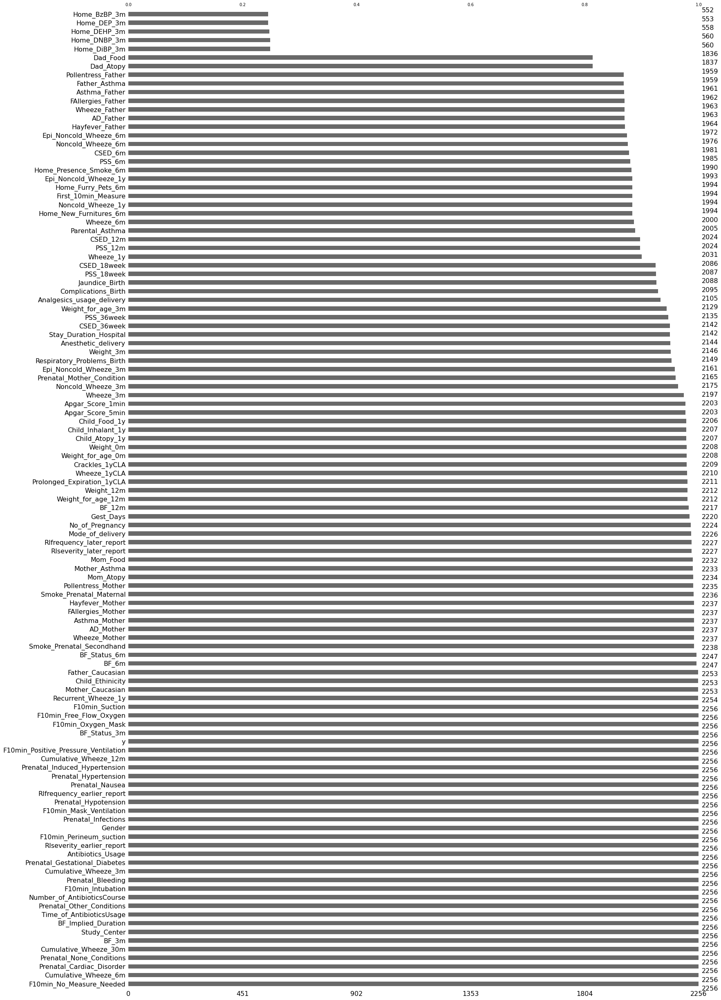

<IPython.core.display.Javascript object>

In [4]:
# Restore df_child
df_child = df_child_backup.copy()

feature_dict, time_dict, feature_ov, time_ov = grouped_feature_generator(df_child)

df_targeted = df_target_selector(
    df_child, target_name="Asthma_Diagnosis_5yCLA", target_mapping={2: np.nan}
)
df_targeted.y.value_counts()

df_shrunk, X, y, _ = sample_selector(
    df_targeted, max_nan_per_sample=40, differentiate=False
)


features_collection = (
    time_dict["at_birth"] | time_dict["3m"] | time_dict["6m"] | time_dict["12m"]
)
df_for_ml = df_shrunk[features_collection | {"y"}]
df_for_ml_backup = df_for_ml.copy()
df_for_ml.y.value_counts(normalize=False)


# Restore df_for_ml
df_for_ml = df_for_ml_backup.copy()

# Basic Engineering without Imputation
preprocessor = Pipeline(
    steps=[
        ("apgar", ApgarTransformer(engineer_type="Ordinal")),
        (
            "birth",
            BirthTransformer(
                bimode_delivery=True,
                binary_pregnancy_conditions=True,
                signal_suction=True,
            ),
        ),
        ("log1p", Log1pTransformer(cols=[]),),
        (
            "resp",
            RespiratoryTransformer(first_18m_divide=True, minimal_value_presence=1),
        ),
        ("pss", DiscretizePSS(discretize="Ordinal")),
        #         (
        #             "colfilter",
        #             ColumnFilter(
        #                 repetition_standard=0.99,
        #                 corr_threshold=0.99,
        #                 feature_missingness=0.2,
        #                 corr_and_missing=True,
        #             ),
        #         ),
        #         (
        #             "imp",
        #             ImputerStrategizer(strategy="all_imputation", selective_threshold=100),
        #         ),
        #         (
        #             "catimp",
        #             CatNaNImputer(NaN_signal_thresh=2000, NaN_imputation_strategy="ignore"),
        #         ),
        #         (
        #             "numimp",
        #             NumNaNimputer(
        #                 add_indicator_threshold=2000, imputing_correlated_subset="KNN"
        #             ),
        #         ),
        ("collinear", CollinearRemover(collinear_level=0.99)),
    ]
)

preprocessor

preprocessor.fit_transform(df_for_ml)

# View Missingness

import missingno as msno

msno.bar(df_for_ml, sort="descending")


# Do stats

numeric_stats, categorical_stats = df_feature_stats(df_for_ml)


categorical_stats.head(30)

numeric_stats.head(30)

# Pick your columns for imputation and modelling
feature_selected = set(numeric_stats[numeric_stats["p-val"] < 0.1].index) | set(
    categorical_stats[categorical_stats.pval < 0.1].index
)

feature_selected

## ONLY KEEP THOSE WITH HOME DUST SAMPLE

In [5]:
df_for_ml

,Home_Presence_Smoke_6m,Home_DNBP_3m,Prenatal_Nausea,Weight_12m,F10min_Mask_Ventilation,Stay_Duration_Hospital,Wheeze_1y,PSS_12m,Asthma_Mother,Pollentress_Father,...,Weight_for_age_3m,CSED_12m,Wheeze_3m,Analgesics_usage_delivery,Prenatal_Hypotension,Crackles_1yCLA,RIfrequency_earlier_report,RIfrequency_later_report,RIseverity_earlier_report,RIseverity_later_report
Subject_Number,,,,,,,,,,,,,,,,,,,,,
20059,0.0,NaN,1.0,NaN,0.0,1.0,0.0,Low_Stress,0.0,0.0,...,0.39,Low_Depression,0.0,1.0,0.0,0.0,0,3.0,0.0,0.3
20061,0.0,NaN,0.0,9.30,0.0,3.0,0.0,Low_Stress,0.0,0.0,...,-0.14,Low_Depression,0.0,1.0,0.0,0.0,1,3.0,0.1,0.8
20062,0.0,24.193006,1.0,8.18,0.0,3.0,NaN,Low_Stress,1.0,0.0,...,-0.36,Low_Depression,0.0,0.0,0.0,0.0,1,2.0,0.1,0.3
20063,NaN,20.379467,1.0,NaN,0.0,NaN,0.0,Low_Stress,1.0,0.0,...,-0.98,Low_Depression,0.0,NaN,0.0,NaN,0,0.0,0.0,0.0
20064,1.0,5.666667,1.0,9.45,0.0,4.0,0.0,Moderate_Stress,0.0,0.0,...,0.97,High_Depression,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50859,0.0,NaN,0.0,8.50,0.0,1.0,NaN,NaN,0.0,1.0,...,-1.20,NaN,0.0,0.0,0.0,0.0,0,3.0,0.0,0.3
50861,NaN,14.554733,0.0,9.20,0.0,3.0,NaN,NaN,0.0,NaN,...,-1.41,NaN,0.0,1.0,0.0,0.0,0,0.0,0.0,0.0
50862,0.0,3.108867,0.0,9.70,0.0,2.0,0.0,Low_Stress,0.0,1.0,...,0.52,Low_Depression,0.0,0.0,0.0,0.0,1,2.0,0.2,0.8


<IPython.core.display.Javascript object>

In [6]:
df_for_ml.RIfrequency_earlier_report.value_counts()
df_for_ml.RIseverity_later_report.value_counts()
df_for_ml.RIseverity_earlier_report.value_counts()

0    1010
1     780
2     370
3      80
4      14
5       2
Name: RIfrequency_earlier_report, dtype: int64

0.1    598
0.2    502
0.0    466
0.3    339
0.4    165
0.5     69
0.6     35
0.7     28
0.8     11
0.9      9
1.0      3
1.2      1
1.3      1
Name: RIseverity_later_report, dtype: int64

0.0    822
0.1    773
0.2    435
0.3    119
0.4     46
0.5     17
0.6     16
0.7     13
0.8      8
0.9      3
1.2      1
1.3      1
1.0      1
1.8      1
Name: RIseverity_earlier_report, dtype: int64

<IPython.core.display.Javascript object>

In [8]:
a_0 = view_y_proportions(
    df_for_ml, df_for_ml.columns[df_for_ml.columns.str.contains("RIs")], 0.0
)
a_1 = view_y_proportions(
    df_for_ml, df_for_ml.columns[df_for_ml.columns.str.contains("RIs")], 0.1
)
a_2 = view_y_proportions(
    df_for_ml, df_for_ml.columns[df_for_ml.columns.str.contains("RIs")], 0.2
)
a_3 = view_y_proportions(
    df_for_ml, df_for_ml.columns[df_for_ml.columns.str.contains("RIs")], 0.3
)
a_4 = view_y_proportions(
    df_for_ml, df_for_ml.columns[df_for_ml.columns.str.contains("RIs")], 0.4
)
a_5 = view_y_proportions(
    df_for_ml, df_for_ml.columns[df_for_ml.columns.str.contains("RIs")], 0.5
)
a_6 = view_y_proportions(
    df_for_ml, df_for_ml.columns[df_for_ml.columns.str.contains("RIs")], 0.6
)
a_7 = view_y_proportions(
    df_for_ml, df_for_ml.columns[df_for_ml.columns.str.contains("RIs")], 0.7
)
a_8 = view_y_proportions(
    df_for_ml, df_for_ml.columns[df_for_ml.columns.str.contains("RIs")], 0.8
)
a_9 = view_y_proportions(
    df_for_ml, df_for_ml.columns[df_for_ml.columns.str.contains("RIs")], 0.9
)
a_10 = view_y_proportions(
    df_for_ml, df_for_ml.columns[df_for_ml.columns.str.contains("RIs")], 1.0
)

pd.concat([a_0, a_1, a_2, a_3, a_4, a_5, a_6, a_7, a_8, a_9, a_10]).drop(
    index=["*****GENERAL*****"]
).reset_index().sort_values(by=["index", "Thresh"], ascending=[False, True]).rename(
    columns={"index": "RI"}
)

The proportion of definite asthma outcome for general cohorts is 6.74%
The proportion of definite asthma outcome for general cohorts is 6.74%
The proportion of definite asthma outcome for general cohorts is 6.74%
The proportion of definite asthma outcome for general cohorts is 6.74%
The proportion of definite asthma outcome for general cohorts is 6.74%
The proportion of definite asthma outcome for general cohorts is 6.74%
The proportion of definite asthma outcome for general cohorts is 6.74%
The proportion of definite asthma outcome for general cohorts is 6.74%
The proportion of definite asthma outcome for general cohorts is 6.74%
The proportion of definite asthma outcome for general cohorts is 6.74%
The proportion of definite asthma outcome for general cohorts is 6.74%


,RI,Asthma_Proportion_over_thresh,Asthma_Outcome_over_thresh,Total_Number_over_thresh,Thresh
0,RIseverity_later_report,7.44,131.0,1761.0,0.0
3,RIseverity_later_report,7.82,91.0,1163.0,0.1
5,RIseverity_later_report,9.38,62.0,661.0,0.2
7,RIseverity_later_report,13.35,43.0,322.0,0.3
8,RIseverity_later_report,19.75,31.0,157.0,0.4
10,RIseverity_later_report,27.27,24.0,88.0,0.5
12,RIseverity_later_report,30.19,16.0,53.0,0.6
14,RIseverity_later_report,36.00,9.0,25.0,0.7
16,RIseverity_later_report,42.86,6.0,14.0,0.8
18,RIseverity_later_report,60.00,3.0,5.0,0.9


<IPython.core.display.Javascript object>

In [9]:
df_for_ml_mb = df_for_ml[df_for_ml.Home_DEHP_3m.notna()]

<IPython.core.display.Javascript object>

In [10]:
CatNaNImputer(NaN_signal_thresh=2000, NaN_imputation_strategy="ignore").fit_transform(
    df_for_ml_mb
)
NumNaNimputer(
    add_indicator_threshold=2000, imputing_correlated_subset="KNN"
).fit_transform(df_for_ml_mb)

,Home_Presence_Smoke_6m,Home_DNBP_3m,Prenatal_Nausea,Weight_12m,F10min_Mask_Ventilation,Stay_Duration_Hospital,Wheeze_1y,Asthma_Mother,Pollentress_Father,Weight_for_age_0m,...,PSS_6m_Low_Stress,PSS_6m_Moderate_Stress,CSED_36week_Low_Depression,PSS_36week_High_Stress,PSS_36week_Low_Stress,PSS_36week_Moderate_Stress,BF_Status_3m_Exclusive,BF_Status_3m_Partial,BF_Status_3m_Zero,CSED_12m_Low_Depression
Subject_Number,,,,,,,,,,,,,,,,,,,,,
20062,0.0,24.193006,1.0,8.18,0.0,3.0,NaN,1.0,0.0,-0.39,...,0,1,1,0,0,1,1,0,0,1
20063,NaN,20.379467,1.0,NaN,0.0,NaN,0.0,1.0,0.0,0.28,...,1,0,1,0,1,0,1,0,0,1
20064,1.0,5.666667,1.0,9.45,0.0,4.0,0.0,0.0,0.0,1.15,...,0,1,1,0,0,1,0,0,1,0
20067,0.0,15.215133,0.0,9.00,0.0,1.0,0.0,1.0,0.0,-0.52,...,0,1,1,0,0,1,1,0,0,1
20073,0.0,17.475298,0.0,10.50,0.0,2.0,0.0,0.0,0.0,1.00,...,1,0,1,0,1,0,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50852,0.0,4.720000,0.0,9.10,0.0,3.0,0.0,1.0,0.0,0.47,...,1,0,1,0,1,0,0,1,0,1
50855,0.0,21.017533,0.0,10.20,0.0,2.0,NaN,0.0,1.0,1.04,...,0,0,0,0,0,1,1,0,0,0
50861,NaN,14.554733,0.0,9.20,0.0,3.0,NaN,0.0,NaN,-1.85,...,0,0,1,0,1,0,0,0,1,0


,Home_Presence_Smoke_6m,Home_DNBP_3m,Prenatal_Nausea,Weight_12m,F10min_Mask_Ventilation,Stay_Duration_Hospital,Wheeze_1y,Asthma_Mother,Pollentress_Father,Weight_for_age_0m,...,PSS_6m_Low_Stress,PSS_6m_Moderate_Stress,CSED_36week_Low_Depression,PSS_36week_High_Stress,PSS_36week_Low_Stress,PSS_36week_Moderate_Stress,BF_Status_3m_Exclusive,BF_Status_3m_Partial,BF_Status_3m_Zero,CSED_12m_Low_Depression
Subject_Number,,,,,,,,,,,,,,,,,,,,,
20062,0.0,24.193006,1.0,8.18,0.0,3.0,0.0,1.0,0.0,-0.39,...,0,1,1,0,0,1,1,0,0,1
20063,0.0,20.379467,1.0,9.82,0.0,2.0,0.0,1.0,0.0,0.28,...,1,0,1,0,1,0,1,0,0,1
20064,1.0,5.666667,1.0,9.45,0.0,4.0,0.0,0.0,0.0,1.15,...,0,1,1,0,0,1,0,0,1,0
20067,0.0,15.215133,0.0,9.00,0.0,1.0,0.0,1.0,0.0,-0.52,...,0,1,1,0,0,1,1,0,0,1
20073,0.0,17.475298,0.0,10.50,0.0,2.0,0.0,0.0,0.0,1.00,...,1,0,1,0,1,0,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50852,0.0,4.720000,0.0,9.10,0.0,3.0,0.0,1.0,0.0,0.47,...,1,0,1,0,1,0,0,1,0,1
50855,0.0,21.017533,0.0,10.20,0.0,2.0,0.0,0.0,1.0,1.04,...,0,0,0,0,0,1,1,0,0,0
50861,0.0,14.554733,0.0,9.20,0.0,3.0,0.0,0.0,0.0,-1.85,...,0,0,1,0,1,0,0,0,1,0


<IPython.core.display.Javascript object>

64

<AxesSubplot:ylabel='feature'>

array(['No_of_Pregnancy', 'F10min_Free_Flow_Oxygen', 'Wheeze_Mother',
       'Wheeze_3m', 'Cumulative_Wheeze_3m', 'F10min_Perineum_suction',
       'PSS_18week_Low_Stress', 'Prenatal_Other_Conditions', 'BF_6m',
       'BF_Implied_Duration', 'BF_12m', 'Epi_Noncold_Wheeze_3m',
       'Gender_M', 'Study_Center_Winnipeg', 'PSS_18week_High_Stress',
       'Home_BzBP_3m', 'Epi_Noncold_Wheeze_1y',
       'Child_Ethinicity_NonCaucas', 'BF_Status_6m_Exclusive',
       'Prenatal_Infections', 'AD_Mother', 'Home_Furry_Pets_6m',
       'RIseverity_earlier_report', 'Dad_Atopy', 'Wheeze_1y', 'Gest_Days',
       'Father_Asthma', 'Weight_for_age_0m', 'Epi_Noncold_Wheeze_6m',
       'CSED_6m_Low_Depression', 'Wheeze_Father',
       'Stay_Duration_Hospital', 'Prenatal_None_Conditions',
       'Mother_Asthma', 'Pollentress_Father', 'F10min_Suction',
       'CSED_12m_Low_Depression', 'Prenatal_Induced_Hypertension',
       'F10min_No_Measure_Needed', 'Mom_Inhalant',
       'Prenatal_Hypertension', 'Antibio

,test,lambda,chi2,dof,pval,cramer,power
Wheeze_1y,pearson,1.0,21.232546,1.0,0.000004,0.194718,0.995951
Parental_Asthma,pearson,1.0,19.182174,1.0,0.000012,0.185078,0.992235
Antibiotics_Usage,pearson,1.0,15.747629,1.0,0.000072,0.167692,0.977698
Father_Asthma,pearson,1.0,15.681532,1.0,0.000075,0.167340,0.977251
Number_of_AntibioticsCourse,pearson,1.0,29.578766,7.0,0.000113,0.229824,0.990736
CSED_18week_Low_Depression,pearson,1.0,14.731191,1.0,0.000124,0.162190,0.969820
Asthma_Father,pearson,1.0,14.336019,1.0,0.000153,0.160000,0.966100
PSS_18week_High_Stress,pearson,1.0,10.237422,1.0,0.001376,0.135208,0.892445
Anesthetic_delivery,pearson,1.0,9.641423,1.0,0.001902,0.131213,0.873916
Father_Caucasian,pearson,1.0,9.507935,1.0,0.002046,0.130301,0.869394


,T,dof,alternative,p-val,diff,CI95%,cohen-d,BF10,power
Cumulative_Wheeze_30m,-4.829740,142.112366,two-sided,0.000003,2.070443,"[-2.92, -1.22]",0.649873,7317.701,1.000000
RIseverity_later_report,-3.497146,145.232522,two-sided,0.000624,0.088651,"[-0.14, -0.04]",0.457179,39.518,0.992748
Home_DEHP_3m,-3.462806,160.787161,two-sided,0.000685,124.625358,"[-195.7, -53.55]",0.403665,35.284,0.973132
Time_of_AntibioticsUsage,-2.994855,162.623128,two-sided,0.003175,35.367206,"[-58.69, -12.05]",0.345258,8.395,0.914073
RIseverity_earlier_report,-2.831761,157.401561,two-sided,0.005235,0.054441,"[-0.09, -0.02]",0.337318,5.338,0.901436
RIfrequency_later_report,-2.762788,176.766654,two-sided,0.006337,0.375228,"[-0.64, -0.11]",0.295823,4.441,0.813270
Cumulative_Wheeze_12m,-2.551317,157.161190,two-sided,0.011686,0.577958,"[-1.03, -0.13]",0.304396,2.598,0.834627
Weight_for_age_0m,1.745984,173.187975,two-sided,0.082587,-0.182079,"[-0.02, 0.39]",0.190151,0.496,0.449135
Home_DiBP_3m,1.595885,553.646354,two-sided,0.111085,-4.128020,"[-0.95, 9.21]",0.093235,0.39,0.146310
Home_BzBP_3m,-1.556608,142.802447,two-sided,0.121777,64.089631,"[-145.48, 17.3]",0.208074,0.367,0.517838


{'Anesthetic_delivery',
 'Antibiotics_Usage',
 'Apgar_Score_1min_Below_Normal',
 'Apgar_Score_1min_Normal',
 'Apgar_Score_5min_Normal',
 'Asthma_Father',
 'Asthma_Mother',
 'BF_Status_3m_Partial',
 'CSED_12m_Low_Depression',
 'CSED_18week_Low_Depression',
 'CSED_6m_Low_Depression',
 'Child_Ethinicity_Caucasian',
 'Child_Ethinicity_HalfCaucas',
 'Child_Ethinicity_NonCaucas',
 'Cumulative_Wheeze_12m',
 'Cumulative_Wheeze_30m',
 'Dad_Food',
 'Epi_Noncold_Wheeze_1y',
 'Epi_Noncold_Wheeze_6m',
 'F10min_No_Measure_Needed',
 'F10min_Suction',
 'FAllergies_Mother',
 'Father_Asthma',
 'Father_Caucasian',
 'Gender_M',
 'Hayfever_Father',
 'Hayfever_Mother',
 'Home_DEHP_3m',
 'Home_DEP_3m',
 'Jaundice_Birth',
 'Mode_of_delivery_Vaginal',
 'Mom_Food',
 'Mom_Inhalant',
 'Mother_Asthma',
 'Mother_Caucasian',
 'Noncold_Wheeze_1y',
 'Noncold_Wheeze_3m',
 'Number_of_AntibioticsCourse',
 'PSS_12m_High_Stress',
 'PSS_12m_Moderate_Stress',
 'PSS_18week_High_Stress',
 'PSS_18week_Low_Stress',
 'PSS_18week_

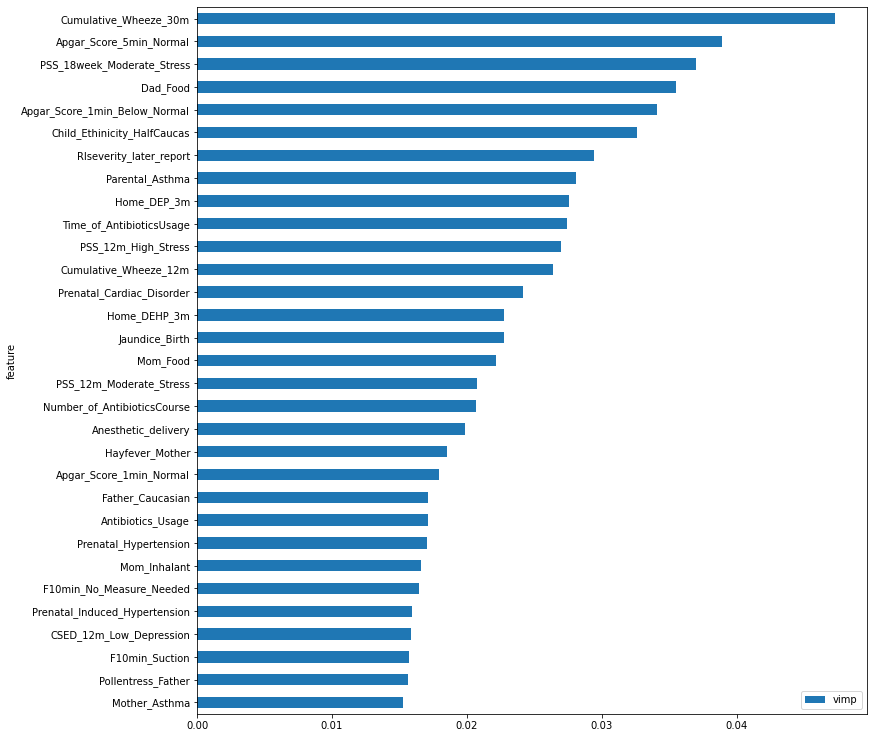

<IPython.core.display.Javascript object>

In [277]:
X = df_for_ml_mb.drop(columns="y")
y = df_for_ml_mb.y

mic = mutual_info_classif(X, y, random_state=1)
fig, ax = plt.subplots(figsize=(12, 13))
mic_df = (
    pd.DataFrame({"feature": X.columns, "vimp": mic})
    .set_index("feature")
    .sort_values(by="vimp", ascending=True)
)
mic_df[mic_df.vimp > 0.015].plot.barh(ax=ax)
mic_df[mic_df.vimp != 0].index.values


numeric_stats, categorical_stats = df_feature_stats(df_for_ml_mb)


categorical_stats.head(30)

numeric_stats.head(30)

# Pick your columns for imputation and modelling
feature_selected = set(numeric_stats[numeric_stats["p-val"] < 0.1].index) | set(
    categorical_stats[categorical_stats.pval < 0.1].index
    | set(mic_df[mic_df.vimp > 0.01].index.values)
)

feature_selected

In [11]:
CollinearRemover(collinear_level=0.90).fit_transform(df_for_ml_mb)

********************************************************************************
Given the correlation threshhold of 0.9, the columns that will be removed are:['Weight_for_age_12m', 'Weight_0m', 'Father_Asthma', 'Cumulative_Wheeze_6m', 'Mother_Asthma']. Please see the following correlation:{'Weight_for_age_12m <> Weight_12m': 0.9085138625586261, 'Mother_Asthma <> Asthma_Mother': 0.9690315297540885, 'Weight_0m <> Weight_for_age_0m': 0.9888305027966627, 'Cumulative_Wheeze_6m <> Cumulative_Wheeze_12m': 0.9316274250532723, 'Father_Asthma <> Asthma_Father': 0.9620191106369811}


<IPython.core.display.Javascript object>

In [12]:
df_for_ml_mb.shape

(558, 127)

<IPython.core.display.Javascript object>

In [13]:
print(
    "Given the minimal number of binary positive: 8 out of 560 samples, the columns that will be dropped are:\n",
    df_summary(df_for_ml_mb).head(6).Number_of_Binary_Positive,
)

Given the minimal number of binary positive: 8 out of 560 samples, the columns that will be dropped are:
 Prenatal_Hypotension          0.0
F10min_Oxygen_Mask            2.0
Prenatal_Cardiac_Disorder     3.0
Prolonged_Expiration_1yCLA    4.0
F10min_Intubation             6.0
F10min_Perineum_suction       7.0
Name: Number_of_Binary_Positive, dtype: float64


<IPython.core.display.Javascript object>

In [14]:
view_y_proportions(df_for_ml_mb, df_summary(df_for_ml_mb).head(25).index)

The proportion of definite asthma outcome for general cohorts is 21.15%


,Asthma_Proportion_over_thresh,Asthma_Outcome_over_thresh,Total_Number_over_thresh,Thresh
PSS_18week_High_Stress,58.33,7.0,12.0,0.0
Epi_Noncold_Wheeze_6m,50.00,7.0,14.0,0.0
Wheeze_1yCLA,44.44,4.0,9.0,0.0
PSS_36week_High_Stress,44.44,4.0,9.0,0.0
F10min_Perineum_suction,42.86,3.0,7.0,0.0
Noncold_Wheeze_1y,41.67,5.0,12.0,0.0
Epi_Noncold_Wheeze_1y,41.18,7.0,17.0,0.0
Noncold_Wheeze_3m,40.00,10.0,25.0,0.0
Noncold_Wheeze_6m,40.00,4.0,10.0,0.0
Apgar_Score_1min_Critical_Low,38.46,5.0,13.0,0.0


<IPython.core.display.Javascript object>

In [15]:
print("The dimension of the matrix to be modelled is:", df_for_ml_mb.shape)
print(
    "The proportion of asthma diagnosis (possible ignored) is:\n",
    df_for_ml_mb.y.value_counts(normalize=True),
)

The dimension of the matrix to be modelled is: (558, 127)
The proportion of asthma diagnosis (possible ignored) is:
 0.0    0.78853
1.0    0.21147
Name: y, dtype: float64


<IPython.core.display.Javascript object>

In [16]:
df_summary(df_for_ml_mb).head(6).index

Index(['Prenatal_Hypotension', 'F10min_Oxygen_Mask',
       'Prenatal_Cardiac_Disorder', 'Prolonged_Expiration_1yCLA',
       'F10min_Intubation', 'F10min_Perineum_suction'],
      dtype='object')

<IPython.core.display.Javascript object>

In [17]:
df_for_ml_mb.y.value_counts()

0.0    440
1.0    118
Name: y, dtype: int64

<IPython.core.display.Javascript object>

In [18]:
# df.dehp_bc_rec
plt.figure(figsize=(12, 10))
sns.heatmap(df_baseline_2.corr())
df_baseline_2.y.value_counts()

<Figure size 864x720 with 0 Axes>

NameError: name 'df_baseline_2' is not defined

<Figure size 864x720 with 0 Axes>

<IPython.core.display.Javascript object>

64

<AxesSubplot:ylabel='feature'>

array(['No_of_Pregnancy', 'F10min_Free_Flow_Oxygen', 'Wheeze_Mother',
       'Wheeze_3m', 'Cumulative_Wheeze_3m', 'F10min_Perineum_suction',
       'PSS_18week_Low_Stress', 'Prenatal_Other_Conditions', 'BF_6m',
       'BF_Implied_Duration', 'BF_12m', 'Epi_Noncold_Wheeze_3m',
       'Gender_M', 'Study_Center_Winnipeg', 'PSS_18week_High_Stress',
       'Home_BzBP_3m', 'Epi_Noncold_Wheeze_1y',
       'Child_Ethinicity_NonCaucas', 'BF_Status_6m_Exclusive',
       'Prenatal_Infections', 'AD_Mother', 'Home_Furry_Pets_6m',
       'RIseverity_earlier_report', 'Dad_Atopy', 'Wheeze_1y', 'Gest_Days',
       'Father_Asthma', 'Weight_for_age_0m', 'Epi_Noncold_Wheeze_6m',
       'CSED_6m_Low_Depression', 'Wheeze_Father',
       'Stay_Duration_Hospital', 'Prenatal_None_Conditions',
       'Mother_Asthma', 'Pollentress_Father', 'F10min_Suction',
       'CSED_12m_Low_Depression', 'Prenatal_Induced_Hypertension',
       'F10min_No_Measure_Needed', 'Mom_Inhalant',
       'Prenatal_Hypertension', 'Antibio

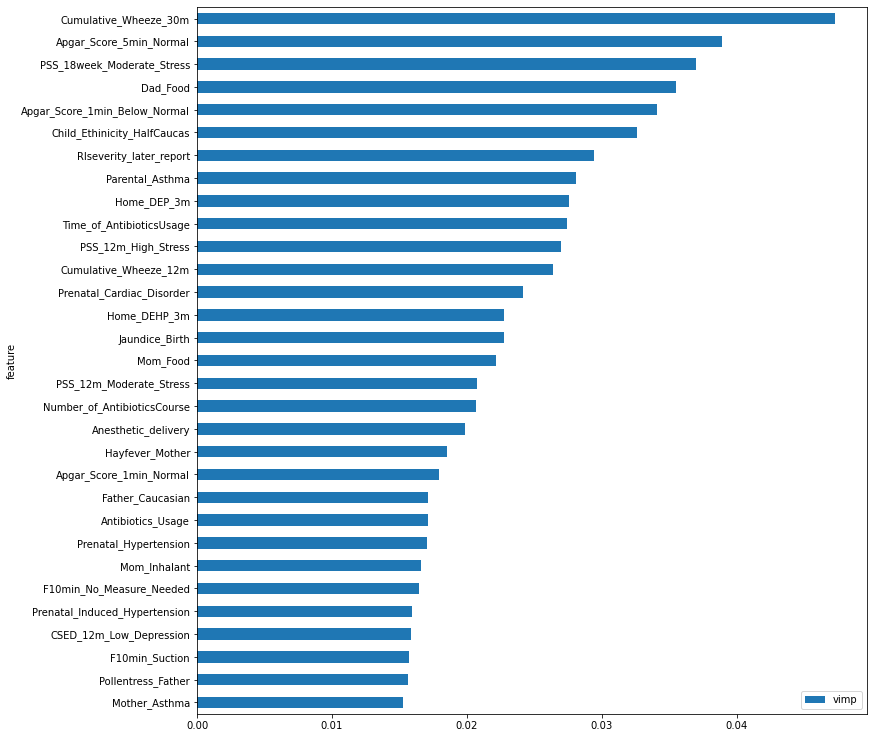

<IPython.core.display.Javascript object>

In [265]:
X = df_for_ml_mb.drop(columns="y")
y = df_for_ml_mb.y

mic = mutual_info_classif(X, y, random_state=1)
fig, ax = plt.subplots(figsize=(12, 13))
mic_df = (
    pd.DataFrame({"feature": X.columns, "vimp": mic})
    .set_index("feature")
    .sort_values(by="vimp", ascending=True)
)
mic_df[mic_df.vimp != 0].shape[0]
mic_df[mic_df.vimp > 0.015].plot.barh(ax=ax)
mic_df[mic_df.vimp != 0].index.values

In [21]:
FEATURE_SELECTED_BASELINE_3 = [
    "Anesthetic_delivery",
    "Antibiotics_Usage",
    "Apgar_Score_1min_Critical_Low",
    #    "Apgar_Score_1min_Below_Normal",
    #    "Apgar_Score_1min_Normal",
    #    "Apgar_Score_5min_Normal",
    "Home_Furry_Pets_6m",
    "Father_Asthma",
    "Mother_Asthma",
    "BF_Status_3m_Partial",
    #    "CSED_12m_Low_Depression",
    #    "CSED_18week_Low_Depression",
    #    "CSED_6m_Low_Depression",
    "Child_Ethinicity_Caucasian",
    #    "Child_Ethinicity_HalfCaucas",
    #    "Child_Ethinicity_NonCaucas",
    "Cumulative_Wheeze_12m",
    #    "Cumulative_Wheeze_30m",
    "Dad_Food",
    "Epi_Noncold_Wheeze_1y",
    "Epi_Noncold_Wheeze_6m",
    "F10min_No_Measure_Needed",
    #    "F10min_Suction",
    #    "FAllergies_Mother",
    "Father_Asthma",
    "Father_Caucasian",
    "Gender_M",
    #    "Hayfever_Father",
    #    "Hayfever_Mother",
    "Home_DEHP_3m",
    #    "Home_DEP_3m",
    #    "Jaundice_Birth",
    "Mode_of_delivery_Vaginal",
    "Mom_Food",
    #    "Mom_Inhalant",
    "Mother_Asthma",
    "Mother_Caucasian",
    #    "Noncold_Wheeze_1y",
    #    "Noncold_Wheeze_3m",
    "Number_of_AntibioticsCourse",
    #    "PSS_12m_High_Stress",
    #    "PSS_12m_Moderate_Stress",
    "PSS_18week_High_Stress",
    "PSS_18week_Low_Stress",
    "PSS_18week_Moderate_Stress",
    "PSS_36week_High_Stress",
    "Parental_Asthma",
    #    "Pollentress_Father",
    #    "Prenatal_Cardiac_Disorder",
    "Prenatal_Hypertension",
    "Prenatal_Induced_Hypertension",
    "Prenatal_None_Conditions",
    "RIfrequency_earlier_report",
    #    "RIfrequency_later_report",
    "RIseverity_earlier_report",
    "RIseverity_later_report",
    "Recurrent_Wheeze_1y",
    #    "Stay_Duration_Hospital",
    #    "Time_of_AntibioticsUsage",
    #    "Weight_for_age_0m",
    #    "Wheeze_1y",
    #    "Wheeze_1yCLA",
    #    "Wheeze_3m",
    #    "Wheeze_6m",
    "Wheeze_Father",
    "Wheeze_Mother",
    "y",
]

<IPython.core.display.Javascript object>

0.0    118
1.0    118
Name: y, dtype: int64

0.0    24
1.0    24
Name: y, dtype: int64

confussion matrix: [[19  5]
 [10 14]]

The performance score of K_Nearest_Neigbhors: 63.815789473684205 

              precision    recall  f1-score   support

         0.0       0.66      0.79      0.72        24
         1.0       0.74      0.58      0.65        24

    accuracy                           0.69        48
   macro avg       0.70      0.69      0.68        48
weighted avg       0.70      0.69      0.68        48

confussion matrix: [[23  1]
 [19  5]]

The performance score of Support_Vector_Machine: 56.94444444444444 

              precision    recall  f1-score   support

         0.0       0.55      0.96      0.70        24
         1.0       0.83      0.21      0.33        24

    accuracy                           0.58        48
   macro avg       0.69      0.58      0.52        48
weighted avg       0.69      0.58      0.52        48

confussion matrix: [[24  0]
 [22  2]]

The performance score of Naive_Bayes: 54.166666666666664 

              precision    recall 

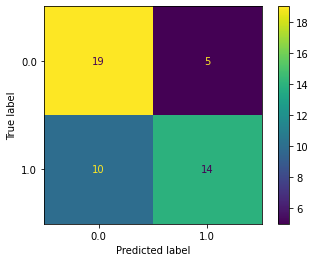

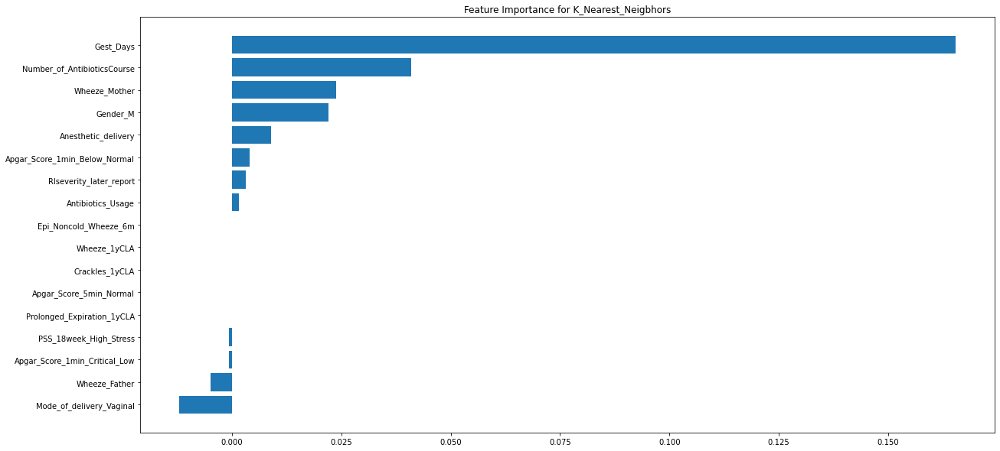

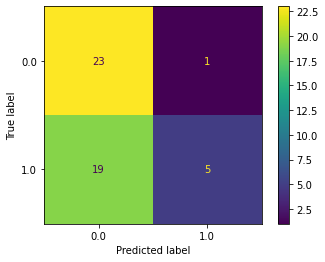

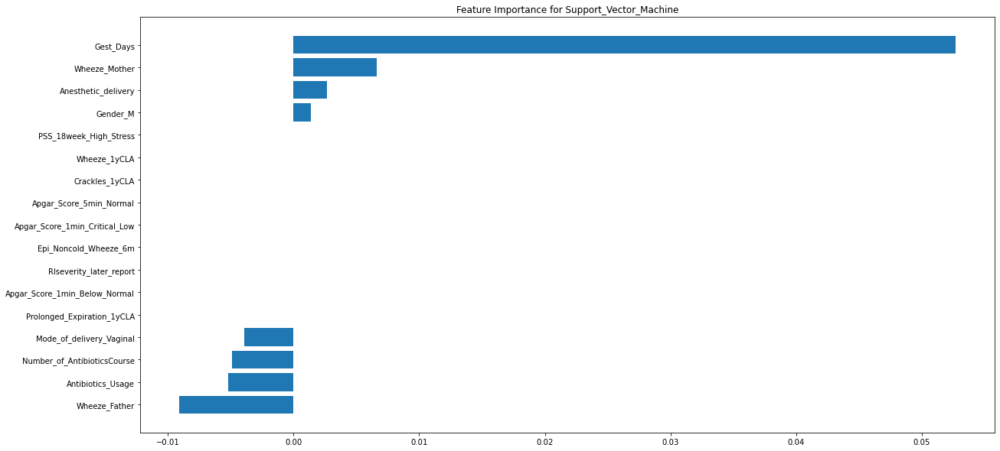

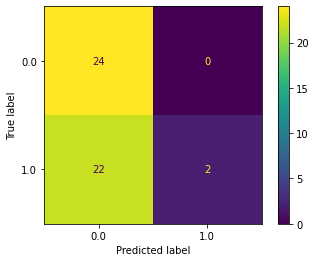

...

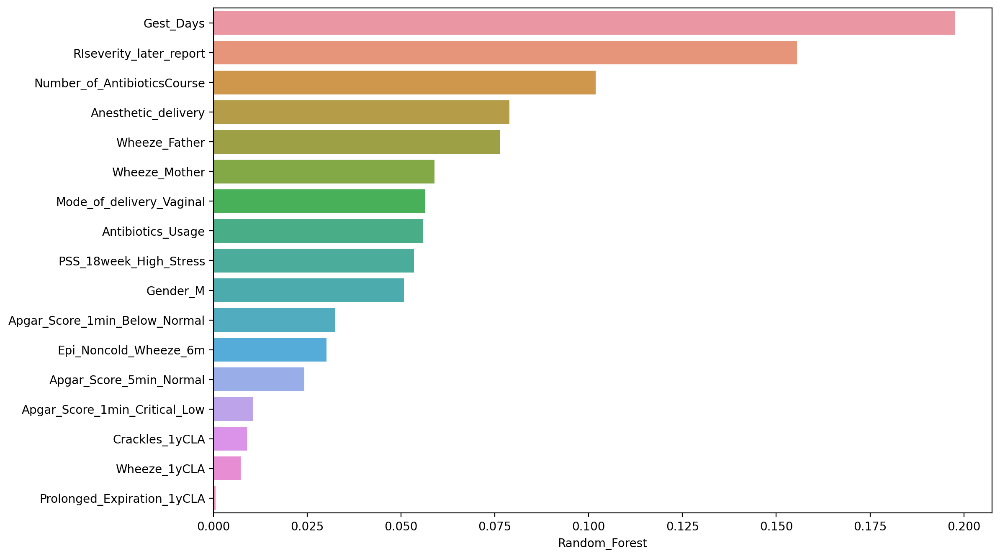

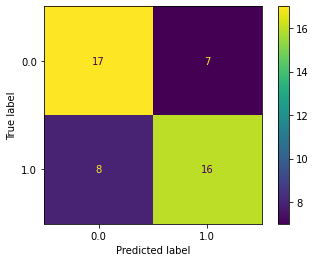

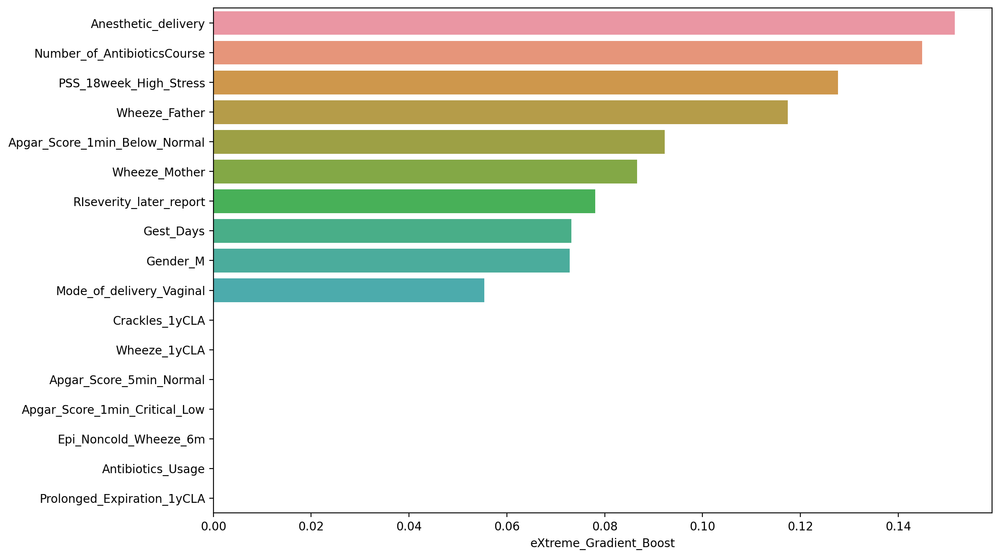

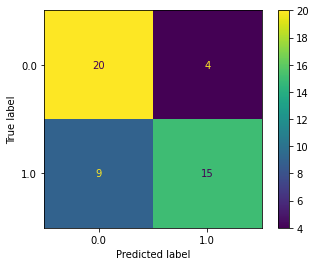

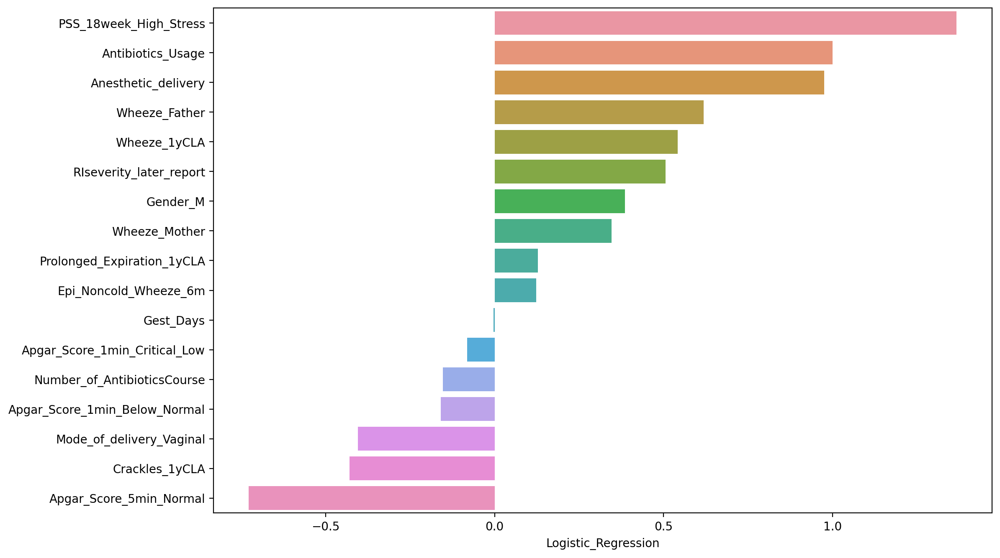

<IPython.core.display.Javascript object>

In [27]:
FEATURE_SELECTED_BASELINE_2 = [
    "Gender_M",
    "Apgar_Score_1min_Below_Normal",
    #    "Mom_Inhalant",
    "RIseverity_later_report",
    "Epi_Noncold_Wheeze_6m",
    "Apgar_Score_1min_Critical_Low",
    "Apgar_Score_5min_Normal",
    "Mode_of_delivery_Vaginal",
    "Anesthetic_delivery",
    "Prolonged_Expiration_1yCLA",
    "Crackles_1yCLA",
    "Wheeze_1yCLA",
    #    "Mother_Asthma",
    #    "Father_Asthma",
    "Wheeze_Mother",
    "Wheeze_Father",
    "PSS_18week_High_Stress",
    #    "Hayfever_Father",
    #    "AD_Father",
    #    "Pollentress_Father",
    "Number_of_AntibioticsCourse",
    "Antibiotics_Usage",
    "Gest_Days",
    #    "Home_DEHP_3m",
    "y",
]

df_baseline_2 = df_for_ml_mb[FEATURE_SELECTED_BASELINE_2]

X = df_baseline_2.drop(columns="y")
y = df_baseline_2["y"]

from imblearn.under_sampling import RandomUnderSampler

# define undersample strategy
undersample = RandomUnderSampler(sampling_strategy="majority", random_state=16)
# fit and apply the transform
X_under, y_under = undersample.fit_resample(X, y)
y_under.value_counts()

X_train, X_test, y_train, y_test = train_test_split(
    X_under, y_under, test_size=0.2, stratify=y_under, random_state=2
)
y_test.value_counts()


ml_result_baseline_3_1 = df_ml_run(
    X_train, X_test, y_train, y_test, scoring_func=average_precision_score
)

In [25]:
from sklearn.metrics import average_precision_score
average_precision_score(y_test, dt_predicted)

<IPython.core.display.Javascript object>

In [41]:
df.columns

Index(['Gender_M', 'Apgar_Score_1min_Below_Normal', 'RIseverity_later_report',
       'Epi_Noncold_Wheeze_6m', 'Apgar_Score_1min_Critical_Low',
       'Apgar_Score_5min_Normal', 'Mode_of_delivery_Vaginal',
       'Anesthetic_delivery', 'Prolonged_Expiration_1yCLA', 'Crackles_1yCLA',
       'Wheeze_1yCLA', 'Wheeze_Mother', 'Wheeze_Father',
       'PSS_18week_High_Stress', 'Number_of_AntibioticsCourse',
       'Antibiotics_Usage', 'Gest_Days', 'y'],
      dtype='object')

<IPython.core.display.Javascript object>

In [60]:
baseline_features = {"ahah", "haha", "dada"}

str(baseline_features)
# type(baseline_features)

# if baseline_features:
#     print("haha")
# else:
#     print("wuwu")

"{'ahah', 'dada', 'haha'}"

<IPython.core.display.Javascript object>

In [61]:
feature_combination_result = {}
feature_combination_result[str(baseline_features)] = 88
feature_combination_result

{"{'ahah', 'dada', 'haha'}": 88}

<IPython.core.display.Javascript object>

In [69]:
df.loc[train_index, :]["y"]

Subject_Number
20563    1.0
20401    1.0
30117    1.0
30288    1.0
40153    1.0
        ... 
40398    0.0
20766    0.0
50073    0.0
50483    0.0
50385    0.0
Name: y, Length: 408, dtype: float64

<IPython.core.display.Javascript object>

In [90]:
# a = set()
a.add("5")
a.update("6")
a.update("8")
a.remove("5")
eval(str(a))

{'6', '8'}

<IPython.core.display.Javascript object>

In [70]:
X_train = df.loc[train_index, :].drop(columns="y")
X_train.columns

Index(['Gender_M', 'Apgar_Score_1min_Below_Normal', 'RIseverity_later_report',
       'Epi_Noncold_Wheeze_6m', 'Apgar_Score_1min_Critical_Low',
       'Apgar_Score_5min_Normal', 'Mode_of_delivery_Vaginal',
       'Anesthetic_delivery', 'Prolonged_Expiration_1yCLA', 'Crackles_1yCLA',
       'Wheeze_1yCLA', 'Wheeze_Mother', 'Wheeze_Father',
       'PSS_18week_High_Stress', 'Number_of_AntibioticsCourse',
       'Antibiotics_Usage', 'Gest_Days'],
      dtype='object')

<IPython.core.display.Javascript object>

# Begin of minimal subset of feature identification

<!-- ### PCA could also be performed to view features that contribute most to principal components during feature selection.

### PCA can also be useful to detect outliers for the observations. Removal of outliers help model generalize better. And such increase its predictive power for future events.  -->

#### Four Schemes have been proposed for extracting minimal subset of features that generate highest model performance

In [161]:
df = df_for_ml_mb[FEATURE_SELECTED_BASELINE_2].copy()

df.y.value_counts()

holdout_index_positive = np.random.RandomState(123).permutation(df[df.y == 1].index)[
    :30
]
holdout_index_negative = np.random.RandomState(123).permutation(df[df.y == 0].index)[
    :30
]
rest_index_positive = np.random.RandomState(123).permutation(df[df.y == 1].index)[
    30:118
]
rest_index_negative = np.random.RandomState(123).permutation(df[df.y == 0].index)[
    30:118
]

train_index = list(rest_index_positive) + list(rest_index_negative)
test_index = list(holdout_index_positive) + list(holdout_index_negative)


def df_minimal_features(
    df,
    train_index,
    test_index,
    baseline_features=set(),
    strategy="forward",
    inspection_max=len(df.drop(columns="y").columns) ** 2,
    estimator=LogisticRegression(class_weight="balanced"),
    scoring_func=average_precision_score,
):
    """Identify the minimal features that generate highest performance. 
    Critical assumptions: if model performance didn't increase because of any one feature inclusion/exclusion, then the performance plateaued. 
    This assumption could easily be flawed, if synergies of a combination of features (two or more) can be captured by the model.
    
    Parameters:
    -------------------
    df: Dataframe
        Processed dataframe where target is defined as "y".
    
    train_index: list
        Index list of the train dataset
    
    test_index: list
        Index list of the test dataset
        
    baseline_features: set, default, empty set
        Initial starting matrix
    
    strategy: string, default, "forward"
        "forward": start from features of any length and to include one extra feature with the purpose of increasing model performance.
        "backward": start from full features and to exclude one feature at a time in order to increase model performance.
        "bi_direction": first forward, then backward. Specifically, start from features of any length and begin to include one extra feature of maximal impact to increase model performance. If no increase can be achieved, then exclude one feature at a time to shrink the feature list. 
        "retrospective": start from baseline features. For each step, two inspection will be performed. During inclusion inspection, we see whether an increase of performance can be achived. If ture, then add features with maximal impact. If none can increase the performance, an marker will be created to indicate such situation. 
        Then comes exclusion inpection, where we drop features that hurt the model performance. Such retrospective one-step inspection will stop if neither inclusion nor exclusion can increase model performance. (Performance plateaued)
        
    Returns:
    --------------------
    A set of minimal features, and A dictionary of all calcuated combinations. 
    
    """

    feature_combination_result = {}

    X_train = df.loc[train_index, :].drop(columns="y")
    y_train = df.loc[train_index, :]["y"]
    X_test = df.loc[test_index, :].drop(columns="y")
    y_test = df.loc[test_index, :]["y"]

    if baseline_features:
        estimator.fit(X_train[baseline_features], y_train)
        predicted = estimator.predict(X_test[baseline_features])
        feature_combination_result[str(baseline_features)] = scoring_func(
            y_test, predicted
        )
        print(
            f"Confussion Matrix for features {baseline_features} is: {confusion_matrix(y_test, predicted)}\n"
        )
        current_score = scoring_func(y_test, predicted)

    else:  # if baseline_feature is empty, then create a one-element baseline feature space
        for feature_name in X_train.columns:
            baseline_features.add(feature_name)
            estimator.fit(X_train[baseline_features], y_train)
            predicted = estimator.predict(X_test[baseline_features])
            feature_combination_result[str(baseline_features)] = scoring_func(
                y_test, predicted
            )
            print(
                f"Confussion Matrix for features {baseline_features} is: {confusion_matrix(y_test, predicted)}\n"
            )
            baseline_features.remove(feature_name)

        else:
            baseline_features = eval(
                max(feature_combination_result, key=feature_combination_result.get)
            )
            current_score = max(feature_combination_result.values())

    # Forward Search
    if strategy == "forward":
        for i in range(len(set(X_train.columns) - baseline_features)):
            for feature_name in set(X_train.columns) - baseline_features:
                baseline_features.add(feature_name)
                estimator.fit(X_train[baseline_features], y_train)
                predicted = estimator.predict(X_test[baseline_features])
                feature_combination_result[str(baseline_features)] = scoring_func(
                    y_test, predicted
                )
                print(
                    f"Confussion Matrix for features {baseline_features} is: {confusion_matrix(y_test, predicted)}\n"
                )
                baseline_features.remove(feature_name)

            else:  # After each step of inspection
                max_score = max(feature_combination_result.values())
                if max_score > current_score:
                    # Redefine baseline_feature through extracting the key with highest value
                    baseline_features = eval(
                        max(
                            feature_combination_result,
                            key=feature_combination_result.get,
                        )
                    )
                    current_score = max_score
                else:
                    return baseline_features, feature_combination_result
        else:  # If model performance keep increasing with each step of inclusion inspection
            return baseline_features, feature_combination_result

    # Backward search
    elif strategy == "backward":
        for i in range(len(set(baseline_features))):
            if (
                len(set(baseline_features)) <= 1
            ):  # If there is only one element for the baseline_features
                return baseline_features, feature_combination_result
            else:
                for feature_name in baseline_features:  # Perform inspection
                    baseline_features.remove(feature_name)
                    estimator.fit(X_train[baseline_features], y_train)
                    predicted = estimator.predict(X_test[baseline_features])
                    feature_combination_result[str(baseline_features)] = scoring_func(
                        y_test, predicted
                    )
                    print(
                        f"Confussion Matrix for features {baseline_features} is: {confusion_matrix(y_test, predicted)}\n"
                    )
                    baseline_features.add(feature_name)
                else:  # After each round of inspection
                    max_score = max(feature_combination_result.values())
                    if max_score > current_score:
                        # Redefine baseline_feature through extracting the key with highest value
                        baseline_features = eval(
                            max(
                                feature_combination_result,
                                key=feature_combination_result.get,
                            )
                        )
                        current_score = max_score
                    else:
                        return baseline_features, feature_combination_result

    # Bi-direction search algorithm
    elif strategy == "bi_direction":
        for i in range(len(set(X_train.columns) - baseline_features)):
            for feature_name in set(X_train.columns) - baseline_features:
                baseline_features.add(feature_name)
                estimator.fit(X_train[baseline_features], y_train)
                predicted = estimator.predict(X_test[baseline_features])
                feature_combination_result[str(baseline_features)] = scoring_func(
                    y_test, predicted
                )
                print(
                    f"Confussion Matrix for features {baseline_features} is: {confusion_matrix(y_test, predicted)}\n"
                )
                baseline_features.remove(feature_name)

            else:  # After each step of inspection
                max_score = max(feature_combination_result.values())
                if max_score > current_score:
                    # Redefine baseline_feature through extracting the key with highest value
                    baseline_features = eval(
                        max(
                            feature_combination_result,
                            key=feature_combination_result.get,
                        )
                    )
                    current_score = max_score
                else:
                    # Begin backward search
                    for i in range(len(set(baseline_features))):
                        if (
                            len(set(baseline_features)) <= 1
                        ):  # If there is only one element for the baseline_features
                            return baseline_features, feature_combination_result
                        else:
                            for feature_name in baseline_features:  # Perform inspection
                                baseline_features.remove(feature_name)
                                estimator.fit(X_train[baseline_features], y_train)
                                predicted = estimator.predict(X_test[baseline_features])
                                feature_combination_result[
                                    str(baseline_features)
                                ] = scoring_func(y_test, predicted)
                                print(
                                    f"Confussion Matrix for features {baseline_features} is: {confusion_matrix(y_test, predicted)}\n"
                                )
                                baseline_features.add(feature_name)
                            else:  # After each round of inspection
                                max_score = max(feature_combination_result.values())
                                if max_score > current_score:
                                    # Redefine baseline_feature through extracting the key with highest value
                                    baseline_features = eval(
                                        max(
                                            feature_combination_result,
                                            key=feature_combination_result.get,
                                        )
                                    )
                                    current_score = max_score
                                else:
                                    return baseline_features, feature_combination_result

        else:  # If model performance keep increasing with any inclusion of features
            # Begin backward search
            for i in range(len(set(baseline_features))):
                if (
                    len(set(baseline_features)) <= 1
                ):  # If there is only one element for the baseline_features
                    return baseline_features, feature_combination_result
                else:
                    for feature_name in baseline_features:  # Perform inspection
                        baseline_features.remove(feature_name)
                        estimator.fit(X_train[baseline_features], y_train)
                        predicted = estimator.predict(X_test[baseline_features])
                        feature_combination_result[
                            str(baseline_features)
                        ] = scoring_func(y_test, predicted)
                        print(
                            f"Confussion Matrix for features {baseline_features} is: {confusion_matrix(y_test, predicted)}\n"
                        )
                        baseline_features.add(feature_name)
                    else:  # After each round of inspection
                        max_score = max(feature_combination_result.values())
                        if max_score > current_score:
                            # Redefine baseline_feature through extracting the key with highest value
                            baseline_features = eval(
                                max(
                                    feature_combination_result,
                                    key=feature_combination_result.get,
                                )
                            )
                            current_score = max_score
                        else:
                            return baseline_features, feature_combination_result

    # Retrospective one-step search algorithm
    # Two way inspection
    elif strategy == "retrospective":

        # Create a large number for the times of inspection for retrospective one-step inspection.
        print(
            f"Total number of retrospective bi-direction inspection is {inspection_max} "
        )

        # For signaling successfuly identified the minimal subset of features that render the highest performance.
        inclusion_marker = 0  # 1 means that adding of any one feature failed to increase model performance for the current baseline feature space, default is 0, suggesting the the model performance could be increased with an inclusion.
        exclusion_marker = 0  # 1 means exclusion of any one feature failed to improve model performance for the current subset of feature, default is 0, suggesting the the model performance could be increased with an exclusion.

        # Assumption: if one feature is found to hurt the model, then this feature might also hurt the model with its combination of different subset of features.
        exclusion_list = (
            set()
        )  # This assumption could possibly be flawed as it omits the synergies of the feature with other combinations of features. Nevertheless, it is still introduced with the purpose to decrease the computation repetition. And provide a way out of perpetuating loop.
        inpection_count = 0  # This number is used to see how many inspection have been conducted so far

        # Now begin to identify minimal subset of features
        for i in range(inspection_max):

            # Check whether any of the termination criterion is met
            if inclusion_marker * exclusion_marker:
                print(
                    f"Congrat! The minimal subset of feature has been identified given the baseline feature after {inpection_count} inspections!"
                )
                return baseline_features, feature_combination_result

            # Perform inclusion inspection
            for feature_name in (
                set(X_train.columns) - baseline_features - exclusion_list
            ):
                baseline_features.add(feature_name)
                estimator.fit(X_train[baseline_features], y_train)
                predicted = estimator.predict(X_test[baseline_features])
                feature_combination_result[str(baseline_features)] = scoring_func(
                    y_test, predicted
                )
                print(
                    f"Confussion Matrix for features {baseline_features} is: {confusion_matrix(y_test, predicted)}\n"
                )
                baseline_features.remove(feature_name)

            else:  # After each step of inspection
                max_score = max(feature_combination_result.values())
                if max_score > current_score:
                    # Redefine baseline_feature through extracting the key with highest value
                    inclusion_marker = 0
                    baseline_features = eval(
                        max(
                            feature_combination_result,
                            key=feature_combination_result.get,
                        )
                    )
                    current_score = max_score
                else:
                    # Mark such situation where inclusion of any one feature failed to increase model performance
                    inclusion_marker = 1

            if (len(set(baseline_features)) <= 1) & (
                inclusion_marker == 1
            ):  # If there is only one element for the baseline_features

                print("It seems that one feature can produce highest performance!")
                return baseline_features, feature_combination_result

            else:
                # Perform exclusion inspection

                # Check whether any of the termination criterion is met
                if inclusion_marker * exclusion_marker == 1:
                    print(
                        f"Congrat! The minimal subset of feature has been identified given the baseline feature after {inpection_count} inspections!"
                    )
                    return baseline_features, feature_combination_result

                for feature_name in baseline_features:  # Perform inspection
                    baseline_features.remove(feature_name)
                    estimator.fit(X_train[baseline_features], y_train)
                    predicted = estimator.predict(X_test[baseline_features])
                    feature_combination_result[str(baseline_features)] = scoring_func(
                        y_test, predicted
                    )
                    print(
                        f"Confussion Matrix for features {baseline_features} is: {confusion_matrix(y_test, predicted)}\n"
                    )
                    baseline_features.add(feature_name)
                else:  # After each round of inspection
                    max_score = max(feature_combination_result.values())
                    if max_score > current_score:
                        # Redefine baseline_feature through extracting the key with highest value
                        exclusion_marker = 0
                        baseline_features_one_less = eval(
                            max(
                                feature_combination_result,
                                key=feature_combination_result.get,
                            )
                        )
                        exclusion_list.update(
                            baseline_features - baseline_features_one_less
                        )
                        baseline_features = baseline_features_one_less
                        current_score = max_score
                    else:
                        # Mark such situation where exclusion of any one feature failed to increase model performance
                        exclusion_marker = 1

            inpection_count = inpection_count + 1

        else:  # If model performance keep increasing with any inclusion of features
            print(
                f"The optimal subset of feature after {inspection_max} times of inspection are generated!"
            )
            return baseline_features, feature_combination_result

0.0    440
1.0    118
Name: y, dtype: int64

<IPython.core.display.Javascript object>

In [131]:
feature_space
max(result_dict.values())

{'Apgar_Score_1min_Below_Normal',
 'Gender_M',
 'Number_of_AntibioticsCourse',
 'RIseverity_later_report',
 'Wheeze_Father',
 'Wheeze_Mother'}

0.6983333333333333

<IPython.core.display.Javascript object>

In [186]:
df.columns

Index(['Gender_M', 'Apgar_Score_1min_Below_Normal', 'RIseverity_later_report',
       'Epi_Noncold_Wheeze_6m', 'Apgar_Score_1min_Critical_Low',
       'Apgar_Score_5min_Normal', 'Mode_of_delivery_Vaginal',
       'Anesthetic_delivery', 'Prolonged_Expiration_1yCLA', 'Crackles_1yCLA',
       'Wheeze_1yCLA', 'Wheeze_Mother', 'Wheeze_Father',
       'PSS_18week_High_Stress', 'Number_of_AntibioticsCourse',
       'Antibiotics_Usage', 'Gest_Days', 'y'],
      dtype='object')

<IPython.core.display.Javascript object>

In [185]:
df

,Gender_M,Apgar_Score_1min_Below_Normal,RIseverity_later_report,Epi_Noncold_Wheeze_6m,Apgar_Score_1min_Critical_Low,Apgar_Score_5min_Normal,Mode_of_delivery_Vaginal,Anesthetic_delivery,Prolonged_Expiration_1yCLA,Crackles_1yCLA,Wheeze_1yCLA,Wheeze_Mother,Wheeze_Father,PSS_18week_High_Stress,Number_of_AntibioticsCourse,Antibiotics_Usage,Gest_Days,y
0,0,0,0.3,0.0,0,1,1,1.0,0.0,0.0,0.0,0.0,0.0,0,0,0,279.0,0.0
1,1,0,0.0,0.0,0,1,1,1.0,0.0,0.0,0.0,1.0,1.0,0,0,0,273.0,0.0
2,1,0,0.0,0.0,0,1,0,1.0,0.0,0.0,0.0,1.0,1.0,0,0,0,258.0,0.0
3,0,0,0.0,0.0,0,1,1,1.0,0.0,0.0,0.0,1.0,1.0,0,0,0,265.0,0.0
4,0,0,0.3,0.0,0,1,1,1.0,0.0,0.0,0.0,0.0,0.0,0,0,0,281.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
553,0,0,0.2,0.0,0,1,0,1.0,0.0,0.0,0.0,0.0,0.0,0,0,0,268.0,1.0
554,1,0,0.1,0.0,0,1,1,1.0,0.0,0.0,0.0,1.0,0.0,1,0,0,279.0,0.0
555,1,0,0.0,0.0,0,1,1,1.0,0.0,0.0,0.0,0.0,0.0,0,0,0,275.0,0.0
556,1,0,0.8,0.0,0,1,1,1.0,0.0,0.0,0.0,1.0,1.0,0,0,0,272.0,1.0


<IPython.core.display.Javascript object>

In [132]:
df_minimal_features(
    df,
    train_index,
    test_index,
    baseline_features={"RIseverity_later_report"},
    strategy="forward",
    estimator=LogisticRegression(),
    scoring_func=average_precision_score,
)

Confussion Matrix for features {'RIseverity_later_report'} is: [[20 10]
 [16 14]]

Confussion Matrix for features {'Prolonged_Expiration_1yCLA', 'RIseverity_later_report'} is: [[20 10]
 [17 13]]

Confussion Matrix for features {'RIseverity_later_report', 'Epi_Noncold_Wheeze_6m'} is: [[20 10]
 [16 14]]

Confussion Matrix for features {'Mode_of_delivery_Vaginal', 'RIseverity_later_report'} is: [[20 10]
 [16 14]]

Confussion Matrix for features {'RIseverity_later_report', 'Apgar_Score_1min_Below_Normal'} is: [[22  8]
 [17 13]]

Confussion Matrix for features {'Apgar_Score_5min_Normal', 'RIseverity_later_report'} is: [[20 10]
 [16 14]]

Confussion Matrix for features {'Wheeze_1yCLA', 'RIseverity_later_report'} is: [[20 10]
 [16 14]]

Confussion Matrix for features {'Apgar_Score_1min_Critical_Low', 'RIseverity_later_report'} is: [[19 11]
 [15 15]]

Confussion Matrix for features {'RIseverity_later_report', 'Gest_Days'} is: [[18 12]
 [17 13]]

Confussion Matrix for features {'Anesthetic_deli

({'Antibiotics_Usage', 'Gender_M', 'Gest_Days', 'RIseverity_later_report'},
 {"{'RIseverity_later_report'}": 0.538888888888889,
  "{'Prolonged_Expiration_1yCLA', 'RIseverity_later_report'}": 0.5282608695652173,
  "{'RIseverity_later_report', 'Epi_Noncold_Wheeze_6m'}": 0.538888888888889,
  "{'Mode_of_delivery_Vaginal', 'RIseverity_later_report'}": 0.538888888888889,
  "{'RIseverity_later_report', 'Apgar_Score_1min_Below_Normal'}": 0.5515873015873016,
  "{'Apgar_Score_5min_Normal', 'RIseverity_later_report'}": 0.538888888888889,
  "{'Wheeze_1yCLA', 'RIseverity_later_report'}": 0.538888888888889,
  "{'Apgar_Score_1min_Critical_Low', 'RIseverity_later_report'}": 0.5384615384615384,
  "{'RIseverity_later_report', 'Gest_Days'}": 0.5086666666666667,
  "{'Anesthetic_delivery', 'RIseverity_later_report'}": 0.5707070707070707,
  "{'Wheeze_Mother', 'RIseverity_later_report'}": 0.6111111111111112,
  "{'Antibiotics_Usage', 'RIseverity_later_report'}": 0.6396825396825396,
  "{'Gender_M', 'RIseverity

<IPython.core.display.Javascript object>

In [134]:
a, b = df_minimal_features(
    df,
    train_index,
    test_index,
    baseline_features=set(df.drop(columns="y").columns),
    strategy="backward",
    estimator=LogisticRegression(),
    scoring_func=average_precision_score,
)
a
max(b.values())

Confussion Matrix for features {'Prolonged_Expiration_1yCLA', 'Anesthetic_delivery', 'Wheeze_Mother', 'Epi_Noncold_Wheeze_6m', 'Antibiotics_Usage', 'Mode_of_delivery_Vaginal', 'RIseverity_later_report', 'Apgar_Score_1min_Below_Normal', 'Gest_Days', 'Apgar_Score_5min_Normal', 'Gender_M', 'Wheeze_1yCLA', 'Wheeze_Father', 'Apgar_Score_1min_Critical_Low', 'PSS_18week_High_Stress', 'Number_of_AntibioticsCourse', 'Crackles_1yCLA'} is: [[21  9]
 [13 17]]

Confussion Matrix for features {'Anesthetic_delivery', 'Wheeze_Mother', 'Epi_Noncold_Wheeze_6m', 'Antibiotics_Usage', 'Mode_of_delivery_Vaginal', 'RIseverity_later_report', 'Apgar_Score_1min_Below_Normal', 'Gest_Days', 'Apgar_Score_5min_Normal', 'Gender_M', 'Wheeze_1yCLA', 'Wheeze_Father', 'Apgar_Score_1min_Critical_Low', 'PSS_18week_High_Stress', 'Number_of_AntibioticsCourse', 'Crackles_1yCLA'} is: [[21  9]
 [13 17]]

Confussion Matrix for features {'Prolonged_Expiration_1yCLA', 'Wheeze_Mother', 'Epi_Noncold_Wheeze_6m', 'Antibiotics_Usage',

Confussion Matrix for features {'Prolonged_Expiration_1yCLA', 'Anesthetic_delivery', 'Wheeze_Mother', 'Antibiotics_Usage', 'Epi_Noncold_Wheeze_6m', 'Mode_of_delivery_Vaginal', 'Apgar_Score_1min_Below_Normal', 'Apgar_Score_5min_Normal', 'Gender_M', 'Wheeze_1yCLA', 'Number_of_AntibioticsCourse', 'Wheeze_Father', 'PSS_18week_High_Stress', 'Gest_Days', 'Crackles_1yCLA'} is: [[20 10]
 [12 18]]

Confussion Matrix for features {'Prolonged_Expiration_1yCLA', 'Anesthetic_delivery', 'Wheeze_Mother', 'Antibiotics_Usage', 'Epi_Noncold_Wheeze_6m', 'Mode_of_delivery_Vaginal', 'Apgar_Score_1min_Below_Normal', 'Apgar_Score_5min_Normal', 'Gender_M', 'Wheeze_1yCLA', 'Number_of_AntibioticsCourse', 'Wheeze_Father', 'Apgar_Score_1min_Critical_Low', 'Gest_Days', 'Crackles_1yCLA'} is: [[21  9]
 [12 18]]

Confussion Matrix for features {'Prolonged_Expiration_1yCLA', 'Anesthetic_delivery', 'Wheeze_Mother', 'Antibiotics_Usage', 'Epi_Noncold_Wheeze_6m', 'Mode_of_delivery_Vaginal', 'Apgar_Score_1min_Below_Normal'

{'Antibiotics_Usage',
 'Apgar_Score_1min_Below_Normal',
 'Apgar_Score_1min_Critical_Low',
 'Apgar_Score_5min_Normal',
 'Crackles_1yCLA',
 'Epi_Noncold_Wheeze_6m',
 'Gender_M',
 'Gest_Days',
 'Mode_of_delivery_Vaginal',
 'Number_of_AntibioticsCourse',
 'Prolonged_Expiration_1yCLA',
 'Wheeze_1yCLA',
 'Wheeze_Father',
 'Wheeze_Mother'}

0.6355072463768116

<IPython.core.display.Javascript object>

In [138]:
feature_space
max(result_dict.values())
a
max(b.values())
c
max(d.values())

{'Apgar_Score_1min_Below_Normal',
 'Gender_M',
 'Number_of_AntibioticsCourse',
 'RIseverity_later_report',
 'Wheeze_Father',
 'Wheeze_Mother'}

0.6983333333333333

{'Antibiotics_Usage',
 'Apgar_Score_1min_Below_Normal',
 'Apgar_Score_1min_Critical_Low',
 'Apgar_Score_5min_Normal',
 'Crackles_1yCLA',
 'Epi_Noncold_Wheeze_6m',
 'Gender_M',
 'Gest_Days',
 'Mode_of_delivery_Vaginal',
 'Number_of_AntibioticsCourse',
 'Prolonged_Expiration_1yCLA',
 'Wheeze_1yCLA',
 'Wheeze_Father',
 'Wheeze_Mother'}

0.6355072463768116

{'Apgar_Score_1min_Below_Normal',
 'Crackles_1yCLA',
 'Mode_of_delivery_Vaginal',
 'Number_of_AntibioticsCourse',
 'PSS_18week_High_Stress',
 'RIseverity_later_report',
 'Wheeze_Mother'}

0.7142857142857142

<IPython.core.display.Javascript object>

In [141]:
view_y_proportions(df, c)
view_y_proportions(df, a)

The proportion of definite asthma outcome for general cohorts is 21.15%


,Asthma_Proportion_over_thresh,Asthma_Outcome_over_thresh,Total_Number_over_thresh,Thresh
PSS_18week_High_Stress,58.33,7.0,12.0,0.0
Number_of_AntibioticsCourse,34.17,41.0,120.0,0.0
Wheeze_Mother,26.11,53.0,203.0,0.0
Crackles_1yCLA,25.00,3.0,12.0,0.0
RIseverity_later_report,22.96,107.0,466.0,0.0
*****GENERAL*****,21.15,118.0,558.0,0.0
Apgar_Score_1min_Below_Normal,19.35,6.0,31.0,0.0
Mode_of_delivery_Vaginal,19.16,78.0,407.0,0.0


The proportion of definite asthma outcome for general cohorts is 21.15%


,Asthma_Proportion_over_thresh,Asthma_Outcome_over_thresh,Total_Number_over_thresh,Thresh
Epi_Noncold_Wheeze_6m,50.00,7.0,14.0,0.0
Wheeze_1yCLA,44.44,4.0,9.0,0.0
Apgar_Score_1min_Critical_Low,38.46,5.0,13.0,0.0
Antibiotics_Usage,34.17,41.0,120.0,0.0
Number_of_AntibioticsCourse,34.17,41.0,120.0,0.0
Wheeze_Father,27.32,50.0,183.0,0.0
Wheeze_Mother,26.11,53.0,203.0,0.0
Gender_M,25.08,79.0,315.0,0.0
Prolonged_Expiration_1yCLA,25.00,1.0,4.0,0.0
Crackles_1yCLA,25.00,3.0,12.0,0.0


<IPython.core.display.Javascript object>

In [137]:
c, d = df_minimal_features(
    df,
    train_index,
    test_index,
    baseline_features={
        "Mode_of_delivery_Vaginal",
        "Wheeze_Mother",
        "RIseverity_later_report",
    },
    strategy="bi_direction",
    estimator=LogisticRegression(),
    scoring_func=average_precision_score,
)
c
max(d.values())

Confussion Matrix for features {'Mode_of_delivery_Vaginal', 'Wheeze_Mother', 'RIseverity_later_report'} is: [[19 11]
 [ 9 21]]

Confussion Matrix for features {'Prolonged_Expiration_1yCLA', 'Mode_of_delivery_Vaginal', 'Wheeze_Mother', 'RIseverity_later_report'} is: [[19 11]
 [10 20]]

Confussion Matrix for features {'Wheeze_Mother', 'Epi_Noncold_Wheeze_6m', 'Mode_of_delivery_Vaginal', 'RIseverity_later_report'} is: [[19 11]
 [ 9 21]]

Confussion Matrix for features {'Wheeze_Mother', 'Mode_of_delivery_Vaginal', 'RIseverity_later_report', 'Apgar_Score_1min_Below_Normal'} is: [[19 11]
 [10 20]]

Confussion Matrix for features {'Wheeze_Mother', 'Mode_of_delivery_Vaginal', 'RIseverity_later_report', 'Apgar_Score_5min_Normal'} is: [[19 11]
 [ 9 21]]

Confussion Matrix for features {'Wheeze_Mother', 'Mode_of_delivery_Vaginal', 'RIseverity_later_report', 'Wheeze_1yCLA'} is: [[21  9]
 [10 20]]

Confussion Matrix for features {'Wheeze_Mother', 'Mode_of_delivery_Vaginal', 'RIseverity_later_report

{'Apgar_Score_1min_Below_Normal',
 'Crackles_1yCLA',
 'Mode_of_delivery_Vaginal',
 'Number_of_AntibioticsCourse',
 'PSS_18week_High_Stress',
 'RIseverity_later_report',
 'Wheeze_Mother'}

0.7142857142857142

<IPython.core.display.Javascript object>

In [158]:
df.columns

Index(['Gender_M', 'Apgar_Score_1min_Below_Normal', 'RIseverity_later_report',
       'Epi_Noncold_Wheeze_6m', 'Apgar_Score_1min_Critical_Low',
       'Apgar_Score_5min_Normal', 'Mode_of_delivery_Vaginal',
       'Anesthetic_delivery', 'Prolonged_Expiration_1yCLA', 'Crackles_1yCLA',
       'Wheeze_1yCLA', 'Wheeze_Mother', 'Wheeze_Father',
       'PSS_18week_High_Stress', 'Number_of_AntibioticsCourse',
       'Antibiotics_Usage', 'Gest_Days', 'y'],
      dtype='object')

<IPython.core.display.Javascript object>

In [162]:
e, f = df_minimal_features(
    df,
    train_index,
    test_index,
    baseline_features={
        "Mode_of_delivery_Vaginal",
        "Wheeze_Mother",
        "RIseverity_later_report",
        "Mode_of_delivery_Vaginal",
        "PSS_18week_High_Stress",
        #        "Anesthetic_delivery",
    },
    strategy="retrospective",
    estimator=LogisticRegression(),
    scoring_func=average_precision_score,
)
e
max(f.values())

Confussion Matrix for features {'Mode_of_delivery_Vaginal', 'Wheeze_Mother', 'PSS_18week_High_Stress', 'RIseverity_later_report'} is: [[21  9]
 [11 19]]

Total number of retrospective bi-direction inspection is 289 
Confussion Matrix for features {'Prolonged_Expiration_1yCLA', 'Wheeze_Mother', 'Mode_of_delivery_Vaginal', 'RIseverity_later_report', 'PSS_18week_High_Stress'} is: [[21  9]
 [12 18]]

Confussion Matrix for features {'Anesthetic_delivery', 'Wheeze_Mother', 'Mode_of_delivery_Vaginal', 'RIseverity_later_report', 'PSS_18week_High_Stress'} is: [[18 12]
 [10 20]]

Confussion Matrix for features {'Wheeze_Mother', 'Antibiotics_Usage', 'Mode_of_delivery_Vaginal', 'RIseverity_later_report', 'PSS_18week_High_Stress'} is: [[21  9]
 [13 17]]

Confussion Matrix for features {'Wheeze_Mother', 'Epi_Noncold_Wheeze_6m', 'Mode_of_delivery_Vaginal', 'RIseverity_later_report', 'PSS_18week_High_Stress'} is: [[21  9]
 [11 19]]

Confussion Matrix for features {'Wheeze_Mother', 'Mode_of_delivery_Va

Confussion Matrix for features {'Anesthetic_delivery', 'Wheeze_Mother', 'RIseverity_later_report', 'Apgar_Score_1min_Below_Normal', 'Apgar_Score_5min_Normal', 'PSS_18week_High_Stress', 'Number_of_AntibioticsCourse', 'Crackles_1yCLA'} is: [[20 10]
 [11 19]]

Confussion Matrix for features {'Wheeze_Mother', 'Antibiotics_Usage', 'RIseverity_later_report', 'Apgar_Score_1min_Below_Normal', 'Apgar_Score_5min_Normal', 'PSS_18week_High_Stress', 'Number_of_AntibioticsCourse', 'Crackles_1yCLA'} is: [[24  6]
 [12 18]]

Confussion Matrix for features {'Wheeze_Mother', 'Epi_Noncold_Wheeze_6m', 'RIseverity_later_report', 'Apgar_Score_1min_Below_Normal', 'Apgar_Score_5min_Normal', 'PSS_18week_High_Stress', 'Number_of_AntibioticsCourse', 'Crackles_1yCLA'} is: [[24  6]
 [12 18]]

Confussion Matrix for features {'Wheeze_Mother', 'RIseverity_later_report', 'Apgar_Score_1min_Below_Normal', 'Apgar_Score_5min_Normal', 'Wheeze_1yCLA', 'PSS_18week_High_Stress', 'Number_of_AntibioticsCourse', 'Crackles_1yCLA'}

{'Apgar_Score_1min_Below_Normal',
 'Apgar_Score_5min_Normal',
 'Crackles_1yCLA',
 'Number_of_AntibioticsCourse',
 'PSS_18week_High_Stress',
 'RIseverity_later_report',
 'Wheeze_Mother'}

0.7142857142857142

<IPython.core.display.Javascript object>

#### Use Existing Tools 

In [167]:
#!pip install mlxtend

<IPython.core.display.Javascript object>

In [168]:
from mlxtend.evaluate import PredefinedHoldoutSplit
from mlxtend.feature_selection import SequentialFeatureSelector as SFS

<IPython.core.display.Javascript object>

In [171]:
np.array(test_index)

array([20165, 50121, 30764, 41026, 20626, 50862, 40319, 50072, 50184,
       20809, 30738, 20255, 20195, 20095, 20301, 30490, 30705, 50501,
       40567, 40677, 50766, 30362, 50317, 50578, 20748, 20634, 50608,
       20561, 20261, 40239, 20138, 40921, 30444, 40194, 30712, 50406,
       41072, 20146, 20126, 30789, 20334, 40103, 20209, 40974, 40371,
       50507, 50580, 40446, 40455, 20601, 30149, 40792, 40443, 20584,
       20253, 30746, 20294, 40274, 40775, 40233])

<IPython.core.display.Javascript object>

In [175]:
df.reset_index(drop=True)

,Gender_M,Apgar_Score_1min_Below_Normal,RIseverity_later_report,Epi_Noncold_Wheeze_6m,Apgar_Score_1min_Critical_Low,Apgar_Score_5min_Normal,Mode_of_delivery_Vaginal,Anesthetic_delivery,Prolonged_Expiration_1yCLA,Crackles_1yCLA,Wheeze_1yCLA,Wheeze_Mother,Wheeze_Father,PSS_18week_High_Stress,Number_of_AntibioticsCourse,Antibiotics_Usage,Gest_Days,y
0,0,0,0.3,0.0,0,1,1,1.0,0.0,0.0,0.0,0.0,0.0,0,0,0,279.0,0.0
1,1,0,0.0,0.0,0,1,1,1.0,0.0,0.0,0.0,1.0,1.0,0,0,0,273.0,0.0
2,1,0,0.0,0.0,0,1,0,1.0,0.0,0.0,0.0,1.0,1.0,0,0,0,258.0,0.0
3,0,0,0.0,0.0,0,1,1,1.0,0.0,0.0,0.0,1.0,1.0,0,0,0,265.0,0.0
4,0,0,0.3,0.0,0,1,1,1.0,0.0,0.0,0.0,0.0,0.0,0,0,0,281.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
553,0,0,0.2,0.0,0,1,0,1.0,0.0,0.0,0.0,0.0,0.0,0,0,0,268.0,1.0
554,1,0,0.1,0.0,0,1,1,1.0,0.0,0.0,0.0,1.0,0.0,1,0,0,279.0,0.0
555,1,0,0.0,0.0,0,1,1,1.0,0.0,0.0,0.0,0.0,0.0,0,0,0,275.0,0.0
556,1,0,0.8,0.0,0,1,1,1.0,0.0,0.0,0.0,1.0,1.0,0,0,0,272.0,1.0


<IPython.core.display.Javascript object>

In [176]:
df = df_for_ml_mb[FEATURE_SELECTED_BASELINE_2].copy()

df = df.reset_index(drop=True)

df.y.value_counts()

holdout_index_positive = np.random.RandomState(123).permutation(df[df.y == 1].index)[
    :30
]
holdout_index_negative = np.random.RandomState(123).permutation(df[df.y == 0].index)[
    :30
]
rest_index_positive = np.random.RandomState(123).permutation(df[df.y == 1].index)[
    30:118
]
rest_index_negative = np.random.RandomState(123).permutation(df[df.y == 0].index)[
    30:118
]

train_index = list(rest_index_positive) + list(rest_index_negative)
test_index = list(holdout_index_positive) + list(holdout_index_negative)

knn = KNeighborsClassifier(n_neighbors=4)
lr = LogisticRegression()


X = df.drop(columns="y")
y = df["y"]

piter = PredefinedHoldoutSplit(np.array(test_index))


sfs1 = SFS(
    lr,
    k_features=7,
    forward=True,
    floating=False,
    verbose=2,
    scoring="average_precision",
    cv=piter,
)

sfs1 = sfs1.fit(X, y)

0.0    440
1.0    118
Name: y, dtype: int64

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  17 out of  17 | elapsed:    0.1s finished

[2021-11-25 10:21:35] Features: 1/7 -- score: 0.693671802054155[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    0.0s finished

[2021-11-25 10:21:35] Features: 2/7 -- score: 0.7841232359534246[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    0.0s finished

[2021-11-25 10:21:35] Features: 3/7 -- score: 0.7948139020156856[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 o

<IPython.core.display.Javascript object>

In [4]:
mm = [1,2,3,4,5]
mm[::-1]

mm = 'abs'
mm[::-1]

'sba'

In [182]:
sfs1.subsets_

{1: {'feature_idx': (2,),
  'cv_scores': array([0.6936718]),
  'avg_score': 0.693671802054155,
  'feature_names': ('RIseverity_later_report',)},
 2: {'feature_idx': (2, 14),
  'cv_scores': array([0.78412324]),
  'avg_score': 0.7841232359534246,
  'feature_names': ('RIseverity_later_report', 'Number_of_AntibioticsCourse')},
 3: {'feature_idx': (2, 11, 14),
  'cv_scores': array([0.7948139]),
  'avg_score': 0.7948139020156856,
  'feature_names': ('RIseverity_later_report',
   'Wheeze_Mother',
   'Number_of_AntibioticsCourse')},
 4: {'feature_idx': (1, 2, 11, 14),
  'cv_scores': array([0.80494219]),
  'avg_score': 0.8049421853734213,
  'feature_names': ('Apgar_Score_1min_Below_Normal',
   'RIseverity_later_report',
   'Wheeze_Mother',
   'Number_of_AntibioticsCourse')},
 5: {'feature_idx': (1, 2, 6, 11, 14),
  'cv_scores': array([0.81063441]),
  'avg_score': 0.810634409136107,
  'feature_names': ('Apgar_Score_1min_Below_Normal',
   'RIseverity_later_report',
   'Mode_of_delivery_Vaginal',


<IPython.core.display.Javascript object>

In [178]:
pd.DataFrame.from_dict(sfs1.get_metric_dict()).T

,feature_idx,cv_scores,avg_score,feature_names,ci_bound,std_dev,std_err
1,"(2,)",[0.693671802054155],0.693672,"(RIseverity_later_report,)",NaN,0.0,NaN
2,"(2, 14)",[0.7841232359534246],0.784123,"(RIseverity_later_report, Number_of_AntibioticsCourse)",NaN,0.0,NaN
3,"(2, 11, 14)",[0.7948139020156856],0.794814,"(RIseverity_later_report, Wheeze_Mother, Number_of_AntibioticsCourse)",NaN,0.0,NaN
4,"(1, 2, 11, 14)",[0.8049421853734213],0.804942,"(Apgar_Score_1min_Below_Normal, RIseverity_later_report, Wheeze_Mother, Number_of_AntibioticsCourse)",NaN,0.0,NaN
5,"(1, 2, 6, 11, 14)",[0.810634409136107],0.810634,"(Apgar_Score_1min_Below_Normal, RIseverity_later_report, Mode_of_delivery_Vaginal, Wheeze_Mother, Number_of_AntibioticsCourse)",NaN,0.0,NaN
6,"(1, 2, 6, 7, 11, 14)",[0.8134422468379022],0.813442,"(Apgar_Score_1min_Below_Normal, RIseverity_later_report, Mode_of_delivery_Vaginal, Anesthetic_delivery, Wheeze_Mother, Number_of_AntibioticsCourse)",NaN,0.0,NaN
7,"(1, 2, 6, 7, 11, 14, 15)",[0.8142969476926031],0.814297,"(Apgar_Score_1min_Below_Normal, RIseverity_later_report, Mode_of_delivery_Vaginal, Anesthetic_delivery, Wheeze_Mother, Number_of_AntibioticsCourse, Antibiotics_Usage)",NaN,0.0,NaN


<IPython.core.display.Javascript object>

In [179]:
from mlxtend.plotting import plot_sequential_feature_selection as plot_sfs

<IPython.core.display.Javascript object>

(0.5, 0.85)

Text(0.5, 1.0, 'Sequential Forward Selection (w. StdDev)')

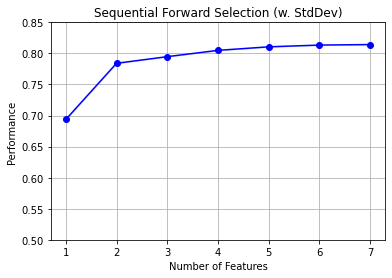

<IPython.core.display.Javascript object>

In [181]:
fig1 = plot_sfs(sfs1.get_metric_dict(), kind="std_dev")

plt.ylim([0.5, 0.85])
plt.title("Sequential Forward Selection (w. StdDev)")
plt.grid()
plt.show()

In [184]:
df = df_for_ml_mb[FEATURE_SELECTED_BASELINE_2].copy()

df = df.reset_index(drop=True)

df.y.value_counts()

holdout_index_positive = np.random.RandomState(123).permutation(df[df.y == 1].index)[
    :30
]
holdout_index_negative = np.random.RandomState(123).permutation(df[df.y == 0].index)[
    :30
]
rest_index_positive = np.random.RandomState(123).permutation(df[df.y == 1].index)[
    30:118
]
rest_index_negative = np.random.RandomState(123).permutation(df[df.y == 0].index)[
    30:118
]

train_index = list(rest_index_positive) + list(rest_index_negative)
test_index = list(holdout_index_positive) + list(holdout_index_negative)

knn = KNeighborsClassifier(n_neighbors=4)
lr = LogisticRegression()


X = df.drop(columns="y")
y = df["y"]

feature_selection = [
    "Apgar_Score_1min_Below_Normal",
    "RIseverity_later_report",
    "Mode_of_delivery_Vaginal",
    "Anesthetic_delivery",
    "Wheeze_Mother",
    "Number_of_AntibioticsCourse",
    "Antibiotics_Usage",
]



estimator = LogisticRegression()
estimator.fit(X_train[baseline_features], y_train)
predicted = estimator.predict(X_test[baseline_features])
feature_combination_result[str(baseline_features)] = scoring_func(y_test, predicted)
print(
    f"Confussion Matrix for features {baseline_features} is: {confusion_matrix(y_test, predicted)}\n"
)

KeyError: "None of [Index(['ahah', 'dada', 'haha'], dtype='object')] are in the [columns]"

<IPython.core.display.Javascript object>

In [363]:
def df_ml_run(
    X_train, X_test, y_train, y_test, scoring_func=f1_score, importance_scoring="f1"
):
    """
    Fast run of a myriad of models and return three very informative dataframes (confusion matrix dataframe,  model performance dataframe
    and colored feature importance dataframe) and one decision tree for visualization

    :param scoring_func: a predefined function, default: f1_score
        model_scoring has to be one of accuracy_score, f1_score, precision_score, recall_score, roc_auc_score
        since it must have the same name of sklearn.metrics functions

    :param importance_scoring: string, default: f1
        importance_scoring has to be one of 'accuracy', 'f1', 'precision', 'recall', 'roc_auc',
        since it must be recognizable as a parameter to be put into permutation importance

    :return: Confusion matrix dataframe, model performance, feature importance

    ------------------------
    Examples:
    ml_result_tuple = df_ml_run(X_train, X_test, y_train, y_test)
    """
    # A dictionary that will store the performance score of models to evaluate feature importance
    model_score = {}

    # A dictionary that will store the confusion matrix results as string to easy comparision
    model_cm = {}

    # A dictionary that will store the feature importance for different models
    model_feature = {}

    # Initializing the model using desired abbreviated names as model instance to train and test
    xgb = XGBClassifier(learning_rate=0.01, n_estimators=250)
    dt = DecisionTreeClassifier(criterion="gini", random_state=3, max_depth=5)
    rf = RandomForestClassifier(n_estimators=20, random_state=3, max_depth=5)
    knn = KNeighborsClassifier(n_neighbors=5)
    svc = SVC(kernel="rbf", C=6)
    nb = GaussianNB()
    lr = LogisticRegression()

    # A dictionary that stores the full name of model
    model_name = {
        "knn": "K_Nearest_Neigbhors",
        "xgb": "eXtreme_Gradient_Boost",
        "svc": "Support_Vector_Machine",
        "dt": "Decision_Tree",
        "rf": "Random_Forest",
        "nb": "Naive_Bayes",
        "lr": "Logistic_Regression",
    }

    permutation_importance_list = [(knn, "knn"), (svc, "svc"), (nb, "nb")]
    feature_importance_list = [(dt, "dt"), (rf, "rf"), (xgb, "xgb")]
    coefficient_list = [(lr, "lr")]

    model_list = (
        permutation_importance_list + feature_importance_list + coefficient_list
    )

    # 1. Search for most effective predictive models and relevant feature importance
    for model, key in model_list:

        # Train and predict
        model.fit(X_train, y_train)
        predicted = model.predict(X_test)

        # Store result
        model_score[key] = scoring_func(y_test, predicted)
        model_cm[key] = str(
            {
                k: dict(v)
                for k, v in dict(
                    pd.DataFrame(
                        confusion_matrix(y_test, predicted),
                        columns=["Pr0", "Pr1"],
                        index=["Tr0", "Tr1"],
                    )
                ).items()
            }
        )
        # Display model result
        print(f"confussion matrix: {confusion_matrix(y_test, predicted)}\n")
        plot_confusion_matrix(model, X_test, y_test)
        print(
            f"The performance score of {model_name[key]}: {model_score[key] * 100} \n"
        )
        print(classification_report(y_test, predicted))

        # Permutation importance
        if (model, key) in permutation_importance_list:

            # Evaluating Feature importance
            permutation_result = permutation_importance(
                model,
                X_train,
                y_train,
                n_repeats=10,
                random_state=1012,
                scoring=importance_scoring,
            )

            # Storing feature importance
            model_feature[key] = permutation_result.importances_mean.reshape(1, -1)[0]

            # Visualization of feature importance for permutation importance
            perm_sorted_idx = permutation_result.importances_mean.argsort()
            plt.figure(figsize=(20, 10))
            plt.title("Feature Importance for {}".format(model_name[key]))
            plt.barh(
                width=permutation_result.importances_mean[perm_sorted_idx].T,
                y=X_train.columns[perm_sorted_idx],
            )
        # Feature Importance for tree-based models:
        elif (model, key) in feature_importance_list:

            # Storing feature importance
            model_feature[key] = model.feature_importances_.reshape(1, -1)[0]

            # Plot visualization of feature importance for tree-based models
            imp_features = pd.DataFrame(
                data=model.feature_importances_,
                index=X_test.columns,
                columns=[model_name[key]],
            )
            imp_features.sort_values(model_name[key], ascending=False, inplace=True)
            plt.figure(figsize=(12, 8), dpi=200)
            sns.barplot(
                data=imp_features,
                y=imp_features.index,
                x=imp_features[model_name[key]],
            )

        # Feature importance for linear-based models:
        elif (model, key) in coefficient_list:

            # Storing feature importance
            model_feature[key] = model.coef_.reshape(1, -1)[0]

            # Plot visualization of feature importance for linear models
            imp_features = pd.DataFrame(
                data=model.coef_.reshape(1, -1)[0],
                index=X_test.columns,
                columns=[model_name[key]],
            )
            imp_features.sort_values(model_name[key], ascending=False, inplace=True)
            plt.figure(figsize=(12, 8), dpi=200)
            sns.barplot(
                data=imp_features,
                y=imp_features.index,
                x=imp_features[model_name[key]],
            )
        else:
            print(
                "{} is not found in the model_list, please check".format((model, key))
            )

    # 2. Put all metrics together for different models
    score_dict = defaultdict(list)
    models = [lr, nb, rf, knn, dt, svc, xgb]
    models_label = [
        "Logistic Regression",
        "Naive Bayes",
        "Random Forest",
        "K-Nearest Neighbours",
        "Decision Tree",
        "Support Vector Machine",
        "Extreme Gradient Boost",
    ]
    measurements = [
        accuracy_score,
        f1_score,
        precision_score,
        recall_score,
        roc_auc_score,
    ]
    measurement_names = ["Accuracy", "F1 score", "Precision", "Recall", "AUC"]
    for i in range(len(models)):
        score_dict["Model"].append(models_label[i])
        for j in range(len(measurements)):
            score_dict[measurement_names[j]].append(
                measurements[j](y_test, models[i].predict(X_test))
            )
    score_df = pd.DataFrame(score_dict).set_index("Model")

    #    model_score_returned = score_df.style.background_gradient(cmap="Greens")
    model_score_returned = score_df
    # 3. Create feature importance table for various predictors

    # Prepare naming of models
    col_name = []
    for i in model_feature.keys():
        col_name.append(model_name[i])

    # Convert feature importances dictionary into dataframe, and tranpose to view feature importance on rows
    feature_res = pd.DataFrame(
        data=model_feature.values(), columns=X_test.columns, index=model_feature.keys()
    ).T

    # Standardize the columns while retaining signs of coefficients using dividing maximal value
    for col in feature_res.columns:
        feature_res[col] = feature_res[col] / feature_res[col].max()

    # Calculate weighted feature importance using a myriad of models based on their performance
    weighted_feature = sum(
        [feature_res[col].values * score for col, score in list(model_score.items())]
    )

    # Standardize the weighted_importance column
    feature_res["Weighted_Importance"] = weighted_feature / np.max(weighted_feature)
    col_name.append("Weighted_Importance")

    # Renaming the columns to the model's full name
    feature_res.columns = col_name
    #    feature_res_returned = feature_res.style.background_gradient(cmap="Greens")
    feature_res_returned = feature_res

    # 4. View the confusion matrix for details
    model_cm_df = pd.DataFrame(model_cm, index=["Confusion_Matrix_Summary"]).T

    # Add two more columns for easy observation
    model_cm_df["Pred_0"] = model_cm_df.Confusion_Matrix_Summary.apply(
        lambda x: eval(x)["Pr0"]
    )
    model_cm_df["Pred_1"] = model_cm_df.Confusion_Matrix_Summary.apply(
        lambda x: eval(x)["Pr1"]
    )

    index_name = []
    for i in model_cm_df.index:
        index_name.append(model_name[i])
    model_cm_df.index = index_name

    return model_score_returned, feature_res_returned, model_cm_df, dt

<IPython.core.display.Javascript object>

In [391]:
ml_result_baseline_3_1[0].style.background_gradient(cmap="Greens")
ml_result_baseline_3_1[1].sort_values(
    "Weighted_Importance", ascending=False
).style.background_gradient(cmap="Greens")

,Accuracy,F1 score,Precision,Recall,AUC
Model,,,,,
Logistic Regression,0.729167,0.723404,0.739130,0.708333,0.729167
Naive Bayes,0.562500,0.363636,0.666667,0.250000,0.562500
Random Forest,0.791667,0.782609,0.818182,0.750000,0.791667
K-Nearest Neighbours,0.437500,0.341463,0.411765,0.291667,0.437500
Decision Tree,0.583333,0.565217,0.590909,0.541667,0.583333
Support Vector Machine,0.520833,0.378378,0.538462,0.291667,0.520833
Extreme Gradient Boost,0.562500,0.571429,0.560000,0.583333,0.562500


,K_Nearest_Neigbhors,Support_Vector_Machine,Naive_Bayes,Decision_Tree,Random_Forest,eXtreme_Gradient_Boost,Logistic_Regression,Weighted_Importance
Home_DEHP_3m,1.000000,1.000000,-0.136678,1.000000,1.000000,0.738924,0.000869,1.000000
RIseverity_later_report,0.000000,0.000000,0.853713,0.307537,0.640579,0.698999,0.953427,0.850008
Number_of_AntibioticsCourse,-0.008405,0.000000,1.000000,0.144178,0.441814,0.830218,0.467524,0.655777
RIseverity_earlier_report,0.000000,0.000000,-0.096013,0.000000,0.579197,0.699712,0.548226,0.497696
Mom_Inhalant,-0.034520,0.000000,0.000000,0.000000,0.237977,0.307065,1.000000,0.439736
Anesthetic_delivery,0.000000,0.000000,0.087864,0.000000,0.209835,0.493473,0.777407,0.426302
Gender_M,0.019383,0.000000,-0.027336,0.110415,0.037455,0.464983,0.614287,0.327134
Wheeze_Father,-0.007671,0.000000,-0.095675,0.000000,0.190460,0.630684,0.410830,0.315151
PSS_18week_High_Stress,0.000000,0.000000,0.544066,0.000000,0.147350,0.000000,0.586353,0.302080
Asthma_Father,-0.003836,0.000000,0.000000,0.000000,0.112518,0.624414,0.351219,0.285815


<IPython.core.display.Javascript object>

0.0    118
1.0    118
Name: y, dtype: int64

0.0    30
1.0    29
Name: y, dtype: int64

DecisionTreeClassifier(max_depth=5, random_state=3)

confussion matrix
[[23  7]
 [13 16]]


Precison of DecisionTreeClassifier: 69.56521739130434 

              precision    recall  f1-score   support

         0.0       0.64      0.77      0.70        30
         1.0       0.70      0.55      0.62        29

    accuracy                           0.66        59
   macro avg       0.67      0.66      0.66        59
weighted avg       0.67      0.66      0.66        59



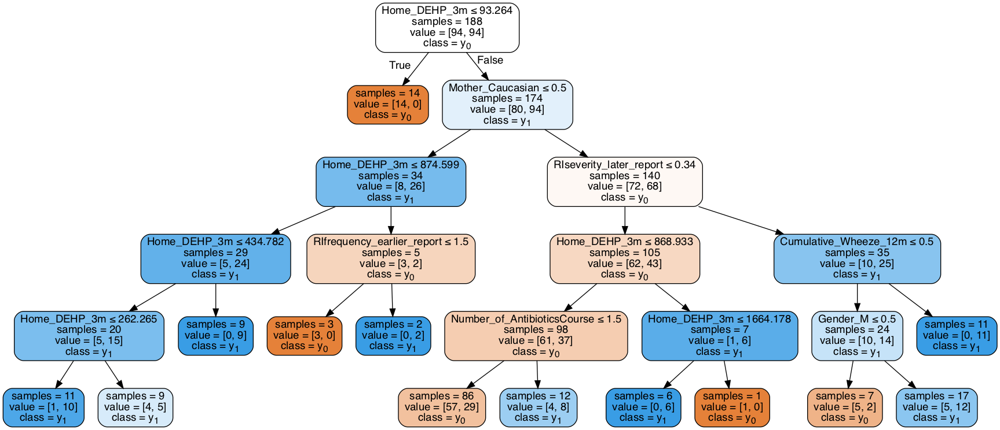

confussion matrix: [[20 10]
 [15 14]]

The performance score of K_Nearest_Neigbhors: 52.830188679245296 

              precision    recall  f1-score   support

         0.0       0.57      0.67      0.62        30
         1.0       0.58      0.48      0.53        29

    accuracy                           0.58        59
   macro avg       0.58      0.57      0.57        59
weighted avg       0.58      0.58      0.57        59

confussion matrix: [[23  7]
 [19 10]]

The performance score of Support_Vector_Machine: 43.47826086956522 

              precision    recall  f1-score   support

         0.0       0.55      0.77      0.64        30
         1.0       0.59      0.34      0.43        29

    accuracy                           0.56        59
   macro avg       0.57      0.56      0.54        59
weighted avg       0.57      0.56      0.54        59

confussion matrix: [[27  3]
 [22  7]]

The performance score of Naive_Bayes: 35.8974358974359 

              precision    recall  f

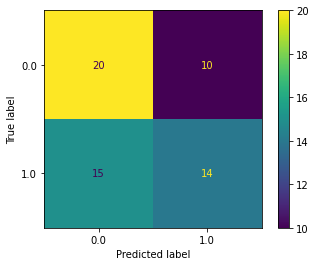

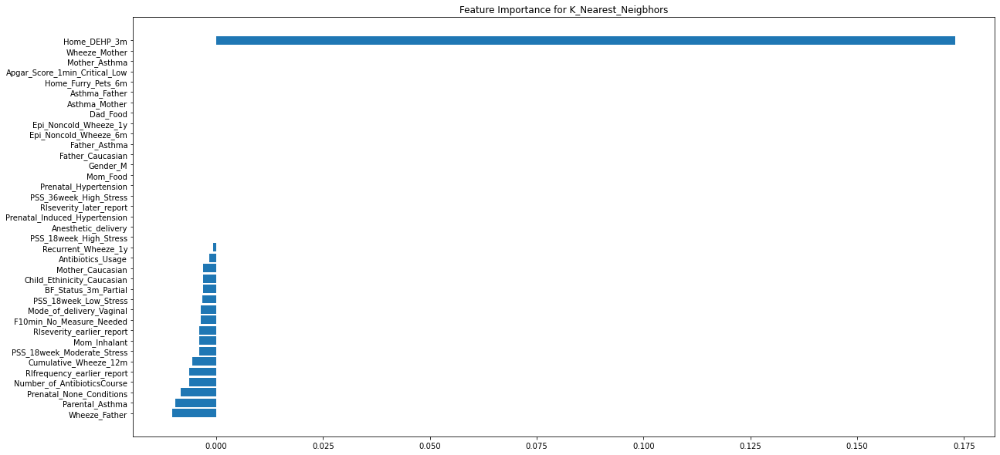

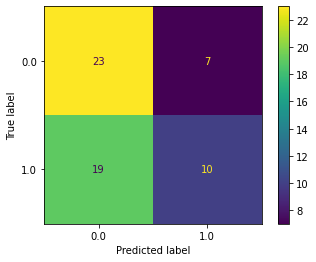

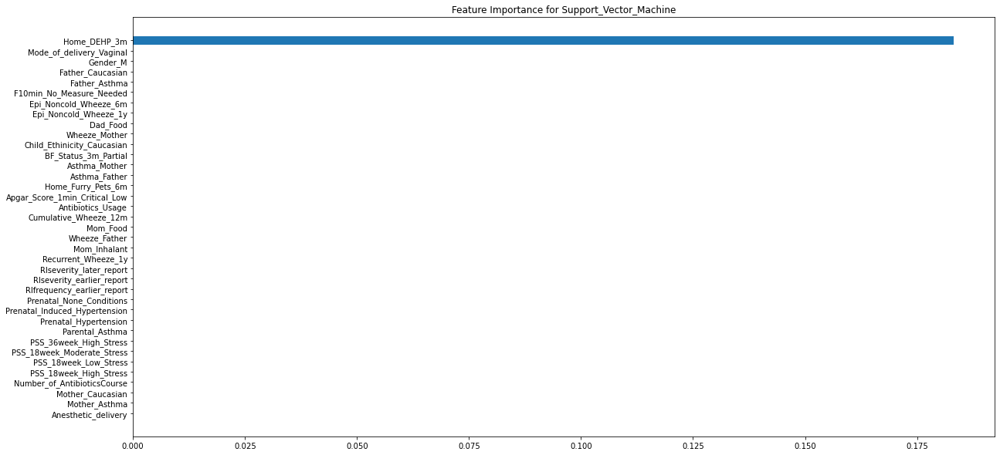

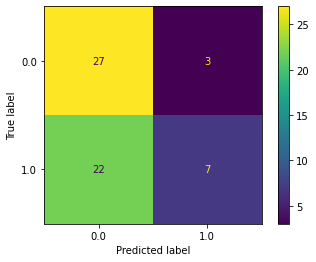

...

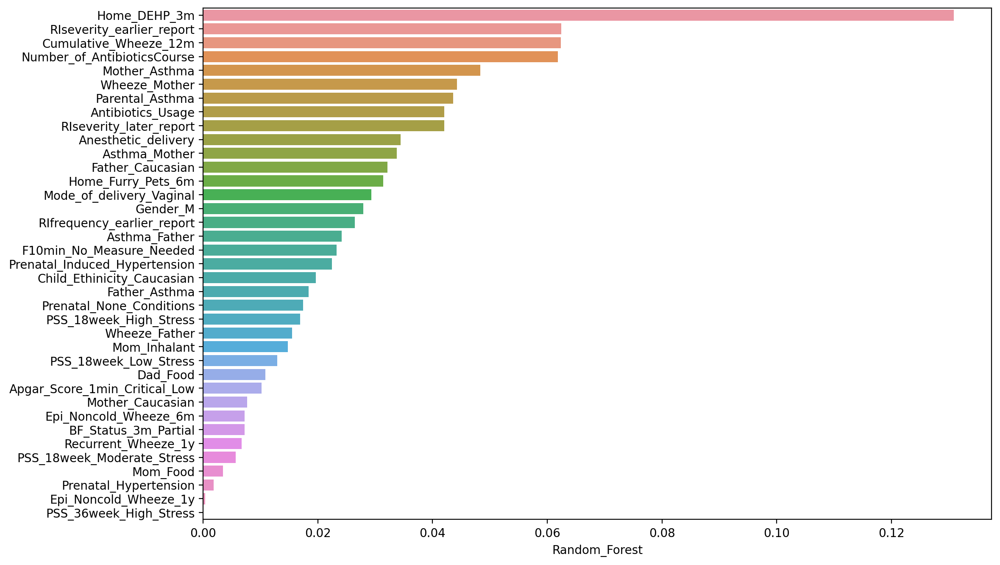

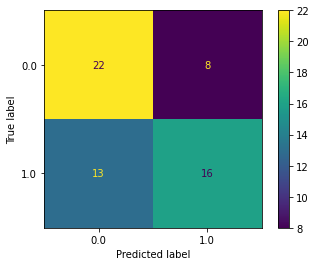

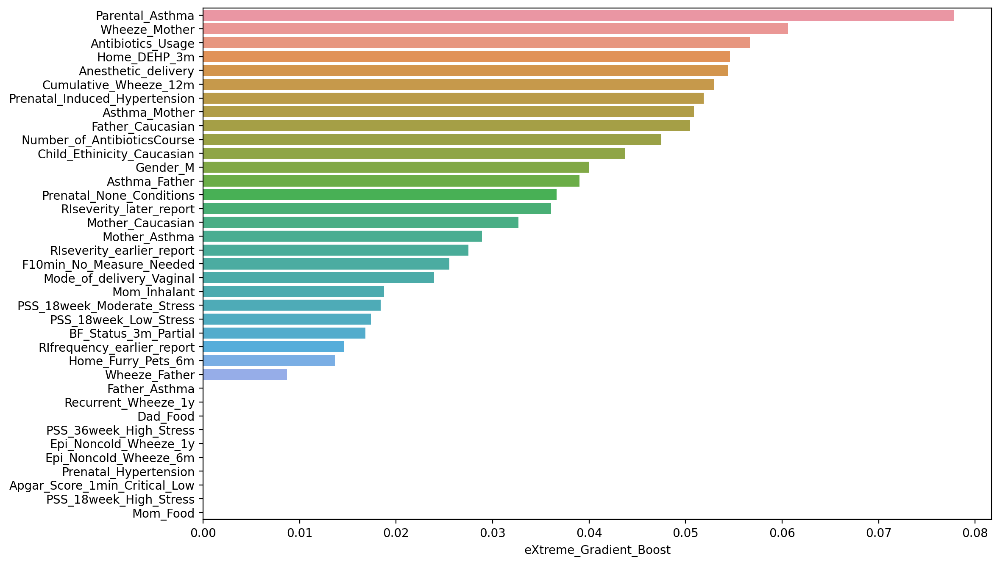

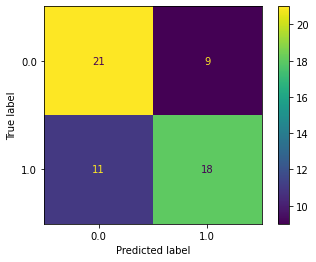

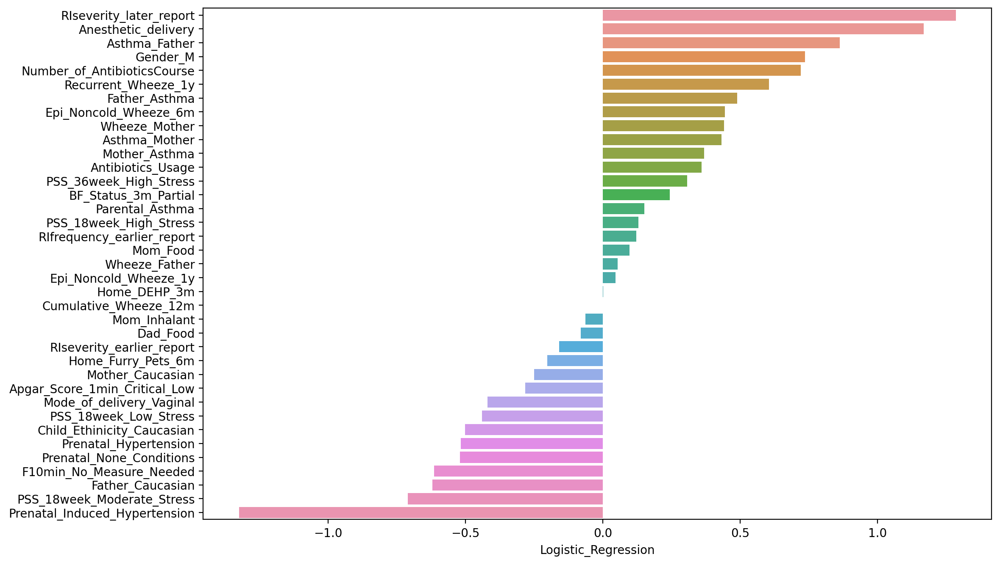

<IPython.core.display.Javascript object>

In [387]:
#!pip install pydotplus

# define undersample strategy
undersample = RandomUnderSampler(sampling_strategy="majority", random_state=15)
# fit and apply the transform
X_under, y_under = undersample.fit_resample(X, y)
y_under.value_counts()

X_train, X_test, y_train, y_test = train_test_split(
    X_under, y_under, test_size=0.25, stratify=y_under, random_state=3
)
y_test.value_counts()


m5 = "DecisionTreeClassifier"
dt = DecisionTreeClassifier(criterion="gini", random_state=3, max_depth=5)
dt.fit(X_train, y_train)
dt_predicted = ml_result_baseline_3_1[3].predict(X_test)
dt_conf_matrix = confusion_matrix(y_test, dt_predicted)
dt_prec_score = precision_score(y_test, dt_predicted)
print("confussion matrix")
print(dt_conf_matrix)
print("\n")
print("Precison of DecisionTreeClassifier:", dt_prec_score * 100, "\n")
print(classification_report(y_test, dt_predicted))

from six import StringIO
from IPython.display import Image
import pydotplus

col_names_list = list(X_train.columns.values)
dot_data = StringIO()
export_graphviz(
    ml_result_baseline_3_1[3],
    out_file=dot_data,
    filled=True,
    rounded=True,
    special_characters=True,
    feature_names=col_names_list,
    impurity=False,
    # proportion=True,
    # precision=2,
    # node_ids=True,
    class_names=True,
    # leaves_parallel=False,
    # rotate=True,
)

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())


ml_result_baseline_dt = df_ml_run(X_train, X_test, y_train, y_test,)

In [367]:
from IPython.core.display import display, HTML

display(HTML("<style>.container { width:100% !important; }</style>"))

<IPython.core.display.Javascript object>

In [373]:
ml_result_baseline_dt[0].style.background_gradient(cmap="Greens")
ml_result_baseline_dt[1].sort_values(
    "Weighted_Importance", ascending=False
).style.background_gradient(cmap="Greens")
# ml_result_baseline_dt[2].style.background_gradient(cmap="Greens")

,Accuracy,F1 score,Precision,Recall,AUC
Model,,,,,
Logistic Regression,0.627119,0.592593,0.640000,0.551724,0.625862
Naive Bayes,0.559322,0.277778,0.714286,0.172414,0.552874
Random Forest,0.644068,0.618182,0.653846,0.586207,0.643103
K-Nearest Neighbours,0.677966,0.666667,0.678571,0.655172,0.677586
Decision Tree,0.694915,0.700000,0.677419,0.724138,0.695402
Support Vector Machine,0.711864,0.701754,0.714286,0.689655,0.711494
Extreme Gradient Boost,0.644068,0.644068,0.633333,0.655172,0.644253


,K_Nearest_Neigbhors,Support_Vector_Machine,Naive_Bayes,Decision_Tree,Random_Forest,eXtreme_Gradient_Boost,Logistic_Regression,Weighted_Importance
Number_of_AntibioticsCourse,1.000000,1.000000,1.000000,0.602993,0.735561,0.365020,0.410948,1.000000
Anesthetic_delivery,0.542065,0.224878,0.072718,0.780396,0.595477,0.729440,0.835861,0.805866
RIseverity_later_report,0.130794,0.211706,0.428625,0.698505,1.000000,0.514428,1.000000,0.794862
Cumulative_Wheeze_12m,0.937024,0.430746,-0.101598,0.779474,0.405387,0.352059,0.023210,0.644809
Antibiotics_Usage,0.560117,0.391726,0.000000,0.311199,0.523155,0.599908,0.298092,0.583877
Parental_Asthma,-0.344009,0.351592,0.000000,1.000000,0.522648,1.000000,-0.035571,0.554190
RIfrequency_earlier_report,0.412452,0.805831,0.000000,0.000000,0.376200,0.336742,0.144529,0.458270
Mom_Inhalant,0.543792,0.210878,0.000000,0.357482,0.216407,0.402461,0.128217,0.409685
Asthma_Mother,0.148164,-0.078328,0.000000,0.000000,0.558900,0.882691,0.328570,0.383969
Asthma_Father,-0.068525,0.361618,0.000000,0.172645,0.201305,0.314312,0.662018,0.349185


<IPython.core.display.Javascript object>

In [380]:
import plotly.graph_objects as go

<IPython.core.display.Javascript object>

#### View Possible Targets

<Figure size 1080x864 with 0 Axes>

<AxesSubplot:>

dict_keys(['Triggered_Asthma_5yCLA', 'Triggered_Asthma_3yCLA', 'Wheeze_3yCLA', 'Wheeze_5yCLA', 'Asthma_Diagnosis_5yCLA ', 'Asthma_Diagnosis_3yCLA ', 'Respiratory_Problems_Birth', 'Wheeze_3m', 'Noncold_Wheeze_3m', 'Wheeze_1y', 'Wheeze_6m', 'Recurrent_Wheeze_1y', 'Recurrent_Wheeze_3y', 'Recurrent_Wheeze_5y', 'Wheeze_Traj_Type'])

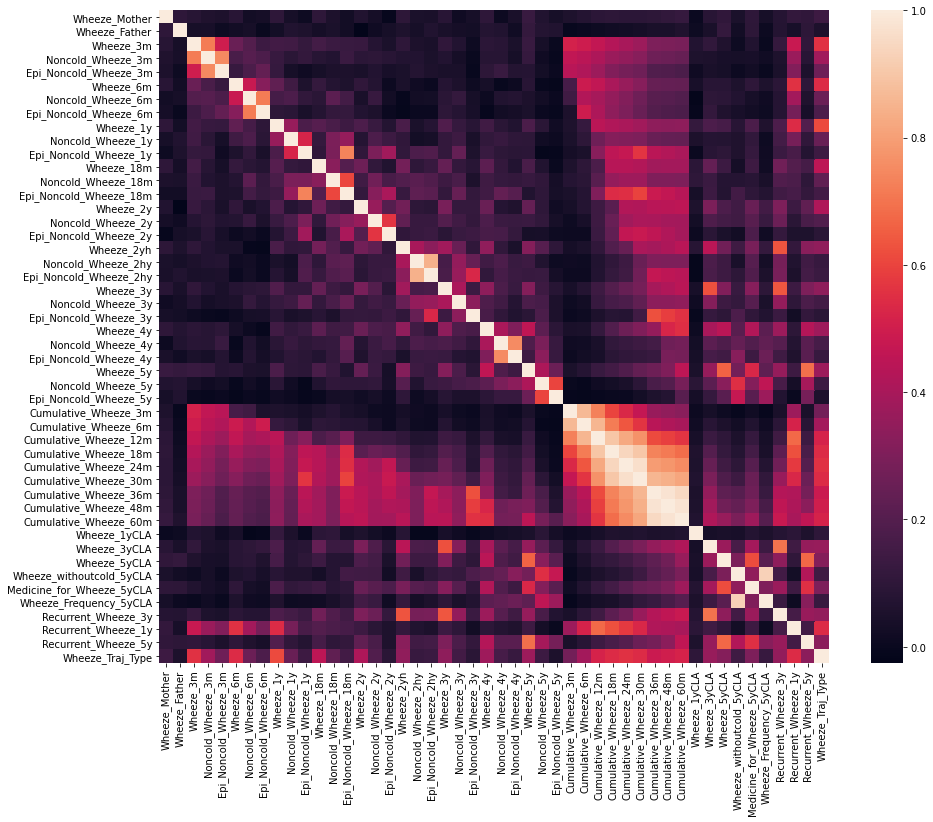

<IPython.core.display.Javascript object>

In [9]:
# Restore df_child
df_child = df_child_backup.copy()

possible_alluvial_cols = {}

# df_child[df_child.columns[df_child.columns.str.contains("CLA")]].nunique()
# df_child[df_child.columns[df_child.columns.str.contains("CLA")]].sum()

possible_alluvial_cols["Triggered_Asthma_5yCLA"] = 110.0
possible_alluvial_cols["Triggered_Asthma_3yCLA"] = 94.0


possible_alluvial_cols["Wheeze_3yCLA"] = 285.0
possible_alluvial_cols["Wheeze_5yCLA"] = 252.0

possible_alluvial_cols["Asthma_Diagnosis_5yCLA "] = 659.0
possible_alluvial_cols["Asthma_Diagnosis_3yCLA "] = 555.0

wheeze_cor = df_child[df_child.columns[df_child.columns.str.contains("Wheeze")]].corr()
plt.figure(figsize=(15, 12))
sns.heatmap(wheeze_cor)
# df_child[df_child.columns[df_child.columns.str.contains("Wheeze")]].sum()


possible_alluvial_cols["Respiratory_Problems_Birth"] = 197.0


possible_alluvial_cols["Wheeze_3m"] = 257
possible_alluvial_cols["Noncold_Wheeze_3m"] = 118
possible_alluvial_cols["Wheeze_1y"] = 329

possible_alluvial_cols["Wheeze_6m"] = 214.0
possible_alluvial_cols["Recurrent_Wheeze_1y"] = 264.0
possible_alluvial_cols["Recurrent_Wheeze_3y"] = 258.0
possible_alluvial_cols["Recurrent_Wheeze_5y"] = 213.0

possible_alluvial_cols["Wheeze_Traj_Type"] = 4860.0
possible_alluvial_cols.keys()

#### Target Alluvial Analysis

In [180]:
view_y_proportions(
    df_for_ml, df_summary_ml[df_summary_ml.Num_Unique_Values > 2].index, 0.8
)

The proportion of definite asthma outcome for general cohorts is 6.7%


,Asthma_Proportion_over_thresh,Asthma_Outcome_over_thresh,Total_Number_over_thresh,Thresh
RIseverity_later_report,42.86,6.0,14.0,0.8
RIseverity_earlier_report,28.57,2.0,7.0,0.8
Epi_Noncold_Wheeze_1y,25.00,6.0,24.0,0.8
Epi_Noncold_Wheeze_3m,18.97,11.0,58.0,0.8
Epi_Noncold_Wheeze_6m,18.52,5.0,27.0,0.8
Cumulative_Wheeze_30m,15.16,107.0,706.0,0.8
Cumulative_Wheeze_3m,14.81,24.0,162.0,0.8
Cumulative_Wheeze_12m,14.06,61.0,434.0,0.8
Cumulative_Wheeze_6m,12.59,35.0,278.0,0.8
Number_of_AntibioticsCourse,12.47,49.0,393.0,0.8


<IPython.core.display.Javascript object>

In [163]:
print(
    "There are 170 unengineered variables selected in total including the collection of potential target variables for machine learning."
)
df_child.shape[1]

There are 170 unengineered variables selected in total including the collection of potential target variables for machine learning.


170

<IPython.core.display.Javascript object>

The overall missingness of the selected variables is:


<AxesSubplot:>

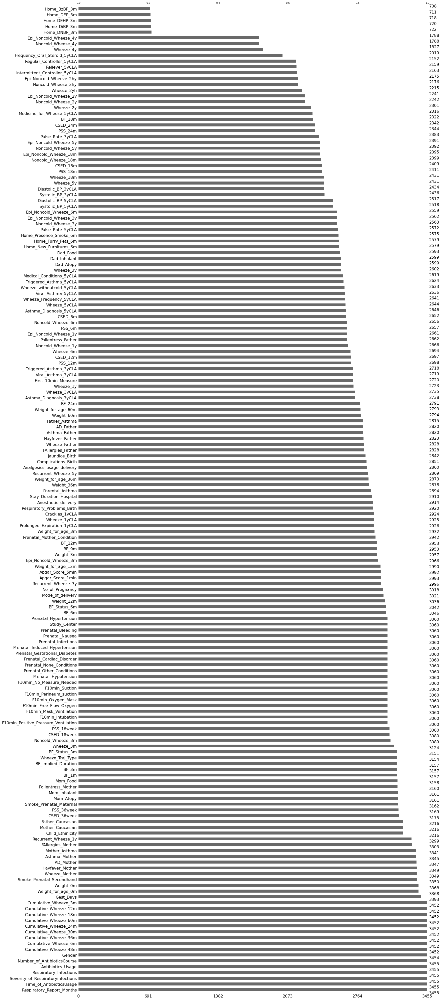

<IPython.core.display.Javascript object>

In [170]:
# msno.matrix(df_child)
print("The overall missingness of the selected variables is:")
msno.bar(df_child, sort="descending")

In [154]:
df_child.columns[df_child.columns.str.contains("5yCLA")]
print("The 5 year clinical assessment of asthma was:")
df_child.Asthma_Diagnosis_5yCLA.value_counts()
print("The 5 year assessment of asthma as percentage was: ")
df_child.Asthma_Diagnosis_5yCLA.value_counts(normalize=True)
print("If possible was treated as asthma:")
df_child.Asthma_Diagnosis_5yCLA.replace({2.0: 1.0}).value_counts(normalize=True)
print("If possible was treated as ignored:")
df_child.Asthma_Diagnosis_5yCLA.replace({2.0: np.nan}).value_counts(normalize=True)


Index(['Wheeze_5yCLA', 'Wheeze_withoutcold_5yCLA', 'Medicine_for_Wheeze_5yCLA',
       'Regular_Controller_5yCLA', 'Intermittent_Controller_5yCLA',
       'Reliever_5yCLA', 'Frequency_Oral_Steroid_5yCLA',
       'Wheeze_Frequency_5yCLA', 'Asthma_Diagnosis_5yCLA',
       'Viral_Asthma_5yCLA', 'Triggered_Asthma_5yCLA',
       'Medical_Conditions_5yCLA', 'Systolic_BP_5yCLA', 'Diastolic_BP_5yCLA',
       'Pulse_Rate_5yCLA'],
      dtype='object')

The 5 year clinical assessment of asthma was:


0.0    2234
2.0     247
1.0     165
Name: Asthma_Diagnosis_5yCLA, dtype: int64

The 5 year assessment of asthma as percentage was: 


0.0    0.844293
2.0    0.093348
1.0    0.062358
Name: Asthma_Diagnosis_5yCLA, dtype: float64

If possible was treated as asthma:


0.0    0.844293
1.0    0.155707
Name: Asthma_Diagnosis_5yCLA, dtype: float64

If possible was treated as ignored:


0.0    0.931221
1.0    0.068779
Name: Asthma_Diagnosis_5yCLA, dtype: float64

<IPython.core.display.Javascript object>

In [381]:
# Restore df_child
df_child = df_child_backup.copy()
df_child
target_alluvial_analysis(df_child)

,Gender,Gest_Days,Weight_0m,Weight_3m,Weight_12m,Weight_36m,Weight_60m,Weight_for_age_0m,Weight_for_age_3m,Weight_for_age_12m,...,Recurrent_Wheeze_1y,Recurrent_Wheeze_5y,Prenatal_Mother_Condition,First_10min_Measure,BF_Status_3m,BF_Status_6m,Wheeze_Traj_Type,Mother_Caucasian,Father_Caucasian,Child_Ethinicity
Subject_Number,,,,,,,,,,,,,,,,,,,,,
20001,F,273.0,3.255,NaN,11.8,20.0,25.5,0.05,NaN,0.09,...,0.0,0.0,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN
20002,M,275.0,3.195,NaN,NaN,NaN,NaN,-0.31,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20003,F,279.0,4.490,NaN,11.0,NaN,NaN,2.47,NaN,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,3.0,NaN,NaN,NaN
20005,F,280.0,2.880,NaN,NaN,NaN,NaN,-0.80,NaN,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20006,F,271.0,3.335,NaN,11.1,17.8,20.1,0.22,NaN,NaN,...,0.0,0.0,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50861,M,275.0,2.520,5.66,9.2,14.2,16.5,-1.85,-1.41,-0.42,...,0.0,1.0,None,None,Zero,Zero,2.0,0.0,0.0,NonCaucas
50862,M,272.0,3.648,7.04,9.7,14.3,16.8,0.60,0.52,-0.03,...,0.0,1.0,Other,None,Partial,Partial,2.0,1.0,1.0,Caucasian
50863,F,288.0,3.352,6.86,11.6,NaN,NaN,0.26,1.39,1.86,...,0.0,NaN,Other,None,Exclusive,Partial,1.0,1.0,1.0,Caucasian


<IPython.core.display.Javascript object>

### CHILD ML Study

In [12]:
# Restore df_child
df_child = df_child_backup.copy()

feature_dict, time_dict, feature_ov, time_ov = grouped_feature_generator(df_child)

df_targeted = df_target_selector(
    df_child, target_name="Asthma_Diagnosis_5yCLA", target_mapping={2: np.nan}
)
df_targeted.y.value_counts()

df_shrunk, X, y, _ = sample_selector(
    df_targeted, max_nan_per_sample=40, differentiate=False
)
features_collection = (
    time_dict["at_birth"] | time_dict["3m"] | time_dict["6m"] | time_dict["12m"]
)
df_for_ml = df_shrunk[features_collection | {"y"}]
df_for_ml_backup = df_for_ml.copy()
df_for_ml.y.value_counts(normalize=False)


# Restore df_for_ml
df_for_ml = df_for_ml_backup.copy()

# Basic Engineering without Imputation
preprocessor = Pipeline(
    steps=[
        ("apgar", ApgarTransformer(engineer_type="Ordinal")),
        (
            "birth",
            BirthTransformer(
                bimode_delivery=True,
                binary_pregnancy_conditions=True,
                signal_suction=True,
            ),
        ),
        ("log1p", Log1pTransformer(cols=[]),),
        (
            "resp",
            RespiratoryTransformer(first_18m_divide=True, minimal_value_presence=1),
        ),
        ("pss", DiscretizePSS(discretize="Ordinal")),
        (
            "colfilter",
            ColumnFilter(
                repetition_standard=0.99,
                corr_threshold=0.99,
                feature_missingness=0.2,
                corr_and_missing=True,
            ),
        ),
        (
            "imp",
            ImputerStrategizer(strategy="all_imputation", selective_threshold=100),
        ),
        (
            "catimp",
            CatNaNImputer(NaN_signal_thresh=200, NaN_imputation_strategy="ignore"),
        ),
        (
            "numimp",
            NumNaNimputer(
                add_indicator_threshold=200, imputing_correlated_subset="KNN"
            ),
        ),
        ("collinear", CollinearRemover(collinear_level=0.99)),
    ]
)

preprocessor

------------------------------------------------------
The available grouped feature can be one of: 
 dict_keys(['1_weight', '2_mother_condition', '3_first10min', '4_breastfeeding', '5_home', '6_mental', '7_parental', '8_smoke', '9_wheeze', '10_resp', '11_antibiotic', '1_11', '12_misc', '13_remainder'])
------------------------------------------------------
The available time-points for features can be one of: 
 dict_keys(['3m', '6m', '12m', '18m', '24m', '36m', '48m', '60m', '1_9m_2hy', 'after_birth', 'at_birth'])
------------------------------------------------------
Note: Target variable can be one of: 
 {'Wheeze_Traj_Type', 'Medicine_for_Wheeze_5yCLA', 'Viral_Asthma_3yCLA', 'Recurrent_Wheeze_1y', 'Viral_Asthma_5yCLA', 'Triggered_Asthma_3yCLA', 'Recurrent_Wheeze_3y', 'Recurrent_Wheeze_5y', 'Asthma_Diagnosis_3yCLA', 'Asthma_Diagnosis_5yCLA', 'Triggered_Asthma_5yCLA'}
------------------------------------------------------
The dimension of original dataframe for process is (3455, 170)


0.0    2234
1.0     165
Name: y, dtype: int64

A total of 13 / 165 (7.9%) for asthma positive are dropped due to more than 40 missing value in the sample.

The total number of dropped samples is 131
************************************************************************
An excel file has been written to /output/unprocessed_targeted_raw_child.xlsx


0.0    2116
1.0     152
Name: y, dtype: int64

Pipeline(steps=[('apgar', ApgarTransformer()), ('birth', BirthTransformer()),
                ('log1p', Log1pTransformer(cols=[])),
                ('resp', RespiratoryTransformer(first_18m_divide=True)),
                ('pss', DiscretizePSS()),
                ('colfilter',
                 ColumnFilter(corr_threshold=0.99, feature_missingness=0.2,
                              repetition_standard=0.99)),
                ('imp', ImputerStrategizer(selective_threshold=100)),
                ('catimp', CatNaNImputer(NaN_signal_thresh=200)),
                ('numimp', NumNaNimputer(add_indicator_threshold=200)),
                ('collinear', CollinearRemover(collinear_level=0.99))])

<IPython.core.display.Javascript object>

In [36]:
FEATURE_SELECTED_BASELINE

['Gender',
 'Mode_of_delivery',
 'Anesthetic_delivery',
 'Prolonged_Expiration_1yCLA',
 'Crackles_1yCLA',
 'Wheeze_1yCLA',
 'Mother_Asthma',
 'Father_Asthma',
 'Parental_Asthma',
 'Mom_Atopy',
 'Wheeze_Mother',
 'Hayfever_Mother',
 'Pollentress_Mother',
 'FAllergies_Mother',
 'Wheeze_Father',
 'Hayfever_Father',
 'AD_Father',
 'Pollentress_Father',
 'Number_of_AntibioticsCourse',
 'Antibiotics_Usage',
 'Gest_Days',
 'Apgar_Score_5min',
 'y']

<IPython.core.display.Javascript object>

### Previous result

In [114]:
df = pd.read_excel("../output/5y_Modelling.xlsx")
df_backup = df.copy()
df_no_dust = df.drop(columns=["dehp_bc_rec"])

<IPython.core.display.Javascript object>

In [115]:
df = df_no_dust.copy()

<IPython.core.display.Javascript object>

<Figure size 864x720 with 0 Axes>

<AxesSubplot:>

0    2446
1     162
Name: target, dtype: int64

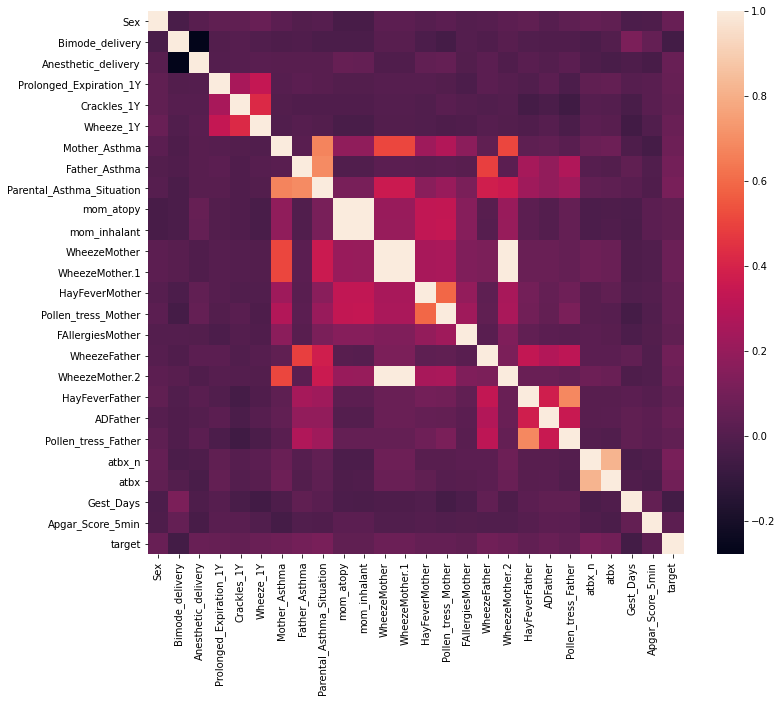

<IPython.core.display.Javascript object>

In [116]:
# df.dehp_bc_rec
plt.figure(figsize=(12, 10))
sns.heatmap(df.corr())
df.target.value_counts()

In [67]:
# Holdout Test!

<IPython.core.display.Javascript object>

In [117]:
holdout_df_withtarget1 = df[df.target == 1].sample(
    frac=0.25, replace=False, random_state=1
)
holdout_df_withtarget1.shape
holdout_df_withtarget0 = df[df.target == 0].sample(
    frac=0.05, replace=False, random_state=1
)
holdout_df_withtarget0.shape
holdout_df = pd.concat([holdout_df_withtarget0, holdout_df_withtarget1])
holdout_df.target.value_counts(normalize=True)
holdout_df.target.value_counts(normalize=False)

(40, 26)

(122, 26)

0    0.753086
1    0.246914
Name: target, dtype: float64

0    122
1     40
Name: target, dtype: int64

<IPython.core.display.Javascript object>

In [118]:
df_tuning = pd.concat(
    [df, holdout_df_withtarget1, holdout_df_withtarget0]
).drop_duplicates(keep=False)
df_tuning.shape
df_tuning.target.value_counts()
X = df_tuning.drop("target", 1)
y = df_tuning.target

(2199, 26)

0    2077
1     122
Name: target, dtype: int64

<IPython.core.display.Javascript object>

In [119]:
from imblearn.under_sampling import RandomUnderSampler

# define undersample strategy
undersample = RandomUnderSampler(sampling_strategy="majority")
# fit and apply the transform
X_under, y_under = undersample.fit_resample(X, y)
y_under.value_counts()

0    122
1    122
Name: target, dtype: int64

<IPython.core.display.Javascript object>

In [120]:
from imblearn.under_sampling import RandomUnderSampler

# define undersample strategy
undersample = RandomUnderSampler(sampling_strategy="majority")
# fit and apply the transform
X_under, y_under = undersample.fit_resample(X, y)
y_under.value_counts()

X_train, X_test, y_train, y_test = train_test_split(
    X_under, y_under, test_size=0.2, stratify=y_under, random_state=0
)
y_test.value_counts()


ml_result_tuple_0923 = df_ml_run(X_train, X_test, y_train, y_test,)


0    25
1    24
Name: target, dtype: int64

<IPython.core.display.Javascript object>

In [121]:
m1 = "Logistic Regression"
lr = LogisticRegression()
model = lr.fit(X_train, y_train)
lr_predict = lr.predict(X_test)
lr_conf_matrix = confusion_matrix(y_test, lr_predict)
lr_prec_score = precision_score(y_test, lr_predict)
print("confussion matrix")
print(lr_conf_matrix)
print("\n")
print("Precison of Logistic Regression:", lr_prec_score * 100, "\n")
print(classification_report(y_test, lr_predict))
lr.coef_

confussion matrix
[[15 10]
 [10 14]]


Precison of Logistic Regression: 58.333333333333336 

              precision    recall  f1-score   support

           0       0.60      0.60      0.60        25
           1       0.58      0.58      0.58        24

    accuracy                           0.59        49
   macro avg       0.59      0.59      0.59        49
weighted avg       0.59      0.59      0.59        49



array([[ 0.28764963,  0.28841053,  0.62533966, -0.02106797,  0.92074844,
         0.05568341,  0.56690624,  1.01119933, -0.49810469,  0.27205251,
         0.27205251,  0.01508074,  0.01508074,  0.23091311,  0.29802287,
         0.03293431,  0.77664139,  0.01508074,  0.47818134,  0.59443709,
        -0.28563755,  0.51029883,  0.53671508, -0.03820732,  0.88512002]])

<IPython.core.display.Javascript object>

confussion matrix: [[15 10]
 [10 14]]

The performance score of Logistic Regression: 58.333333333333336 

              precision    recall  f1-score   support

           0       0.60      0.60      0.60        25
           1       0.58      0.58      0.58        24

    accuracy                           0.59        49
   macro avg       0.59      0.59      0.59        49
weighted avg       0.59      0.59      0.59        49

confussion matrix: [[21  4]
 [12 12]]

The performance score of Gaussian Naive Bayes: 60.0 

              precision    recall  f1-score   support

           0       0.64      0.84      0.72        25
           1       0.75      0.50      0.60        24

    accuracy                           0.67        49
   macro avg       0.69      0.67      0.66        49
weighted avg       0.69      0.67      0.66        49

confussion matrix: [[14 11]
 [ 5 19]]

The performance score of Random Forest: 70.37037037037038 

              precision    recall  f1-score   su

(                        Accuracy  F1 score  Precision    Recall       AUC
 Model                                                                    
 Logistic Regression     0.591837  0.583333   0.583333  0.583333  0.591667
 Naive Bayes             0.673469  0.600000   0.750000  0.500000  0.670000
 Random Forest           0.673469  0.703704   0.633333  0.791667  0.675833
 K-Nearest Neighbour     0.612245  0.612245   0.600000  0.625000  0.612500
 Decision Tree           0.673469  0.652174   0.681818  0.625000  0.672500
 Support Vector Machine  0.510204  0.612903   0.500000  0.791667  0.515833
 Extreme Gradient Boost  0.632653  0.653846   0.607143  0.708333  0.634167,
 {'Logistic_Regression': 0.5833333333333334,
  'Naive_Bayes': 0.6,
  'Random_Forest': 0.7037037037037038,
  'K_Nearest_Neighbors': 0.6122448979591836,
  'Decision_Tree': 0.6521739130434783,
  'Support Vector Classifier': 0.6129032258064516,
  'Extreme_Gradient_Boost': 0.6538461538461539},
 {'Logistic_Regression': "{'Pred_0

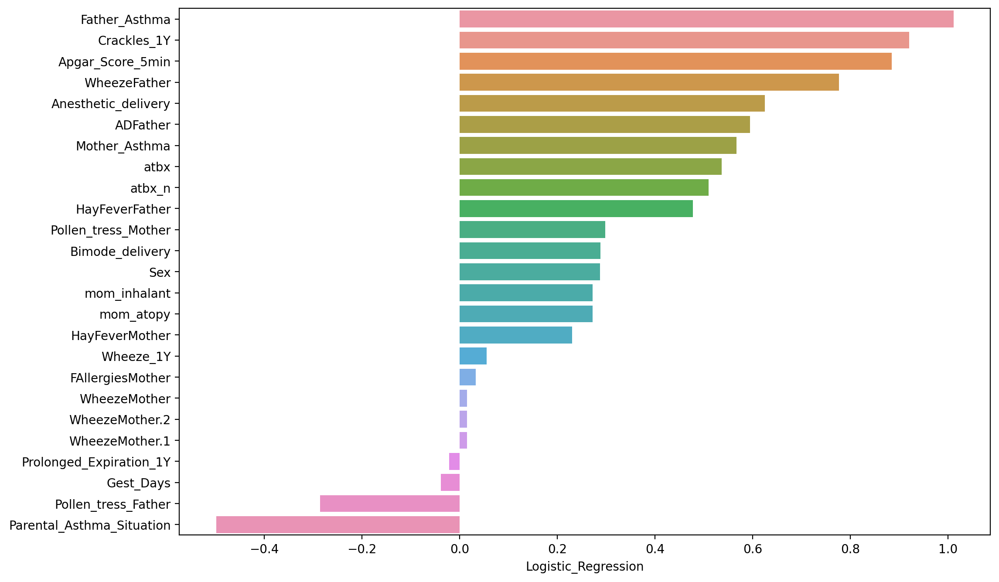

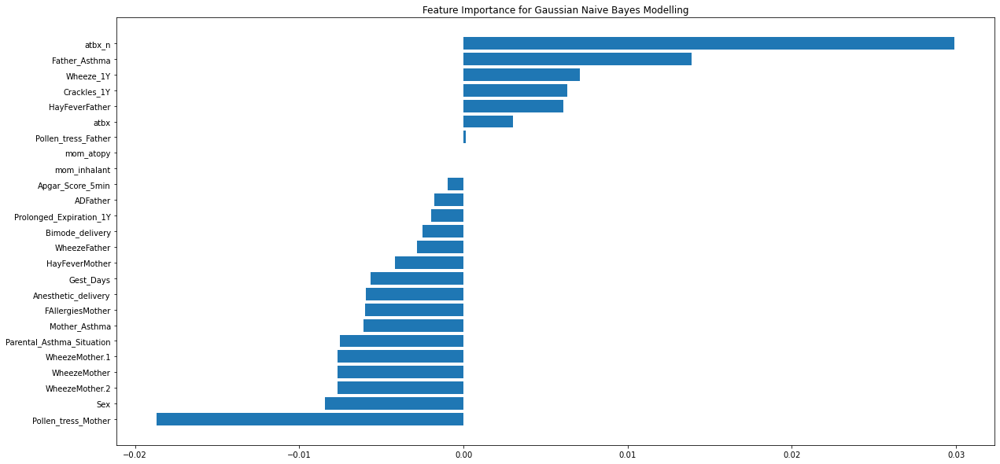

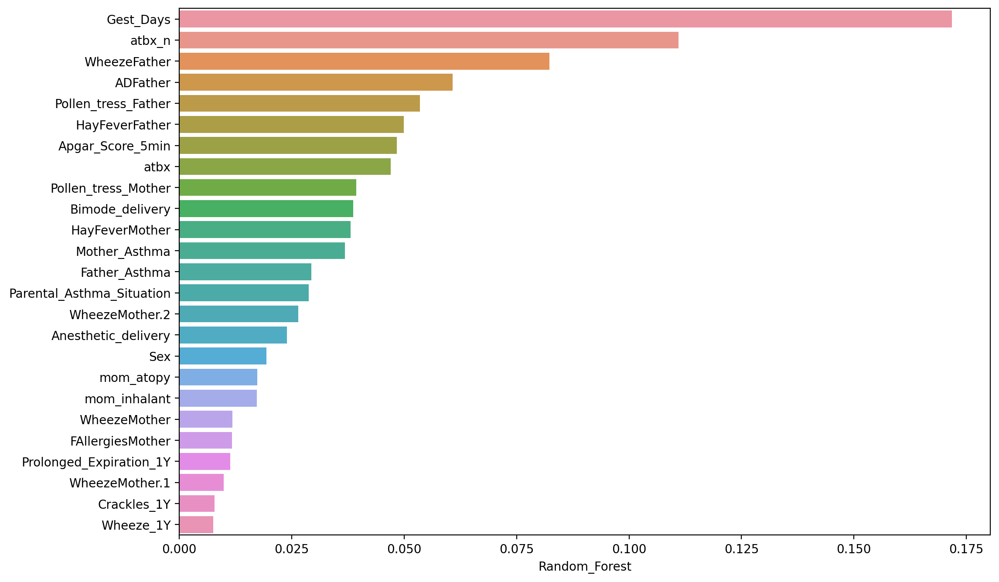

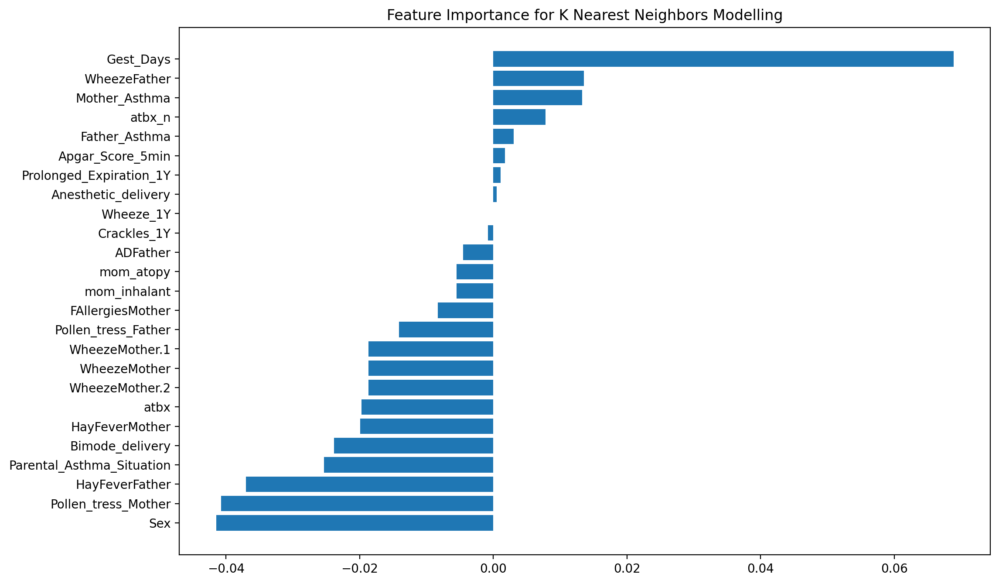

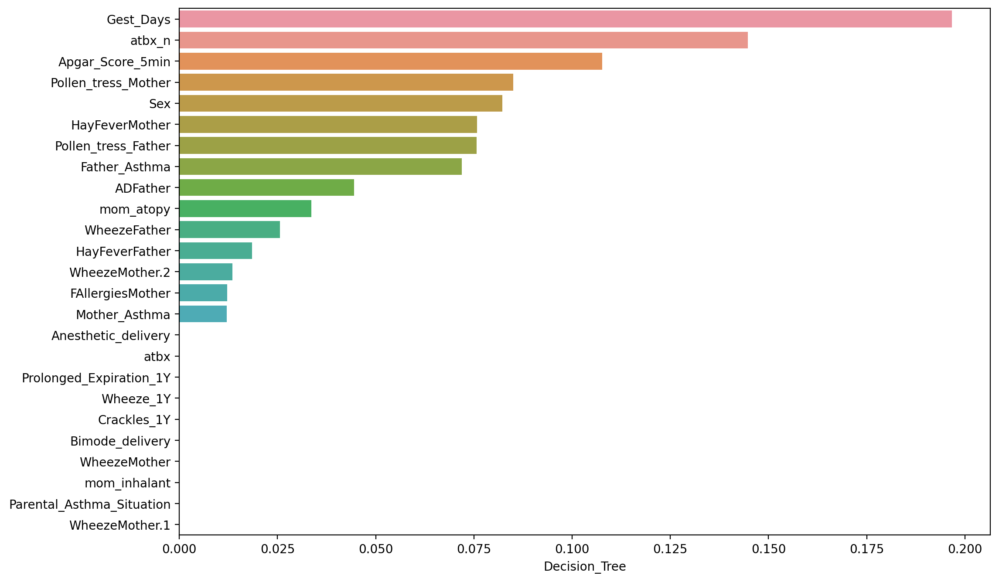

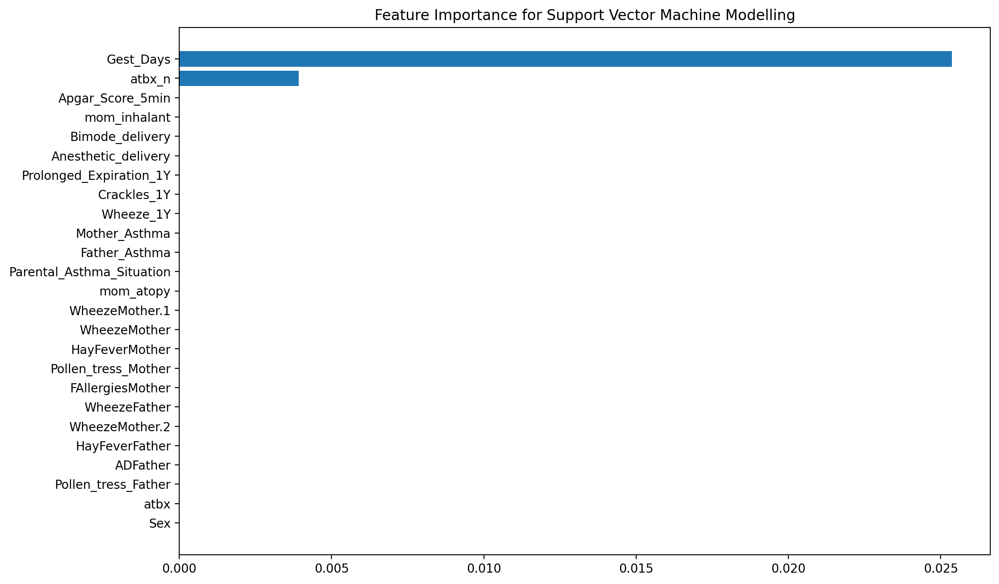

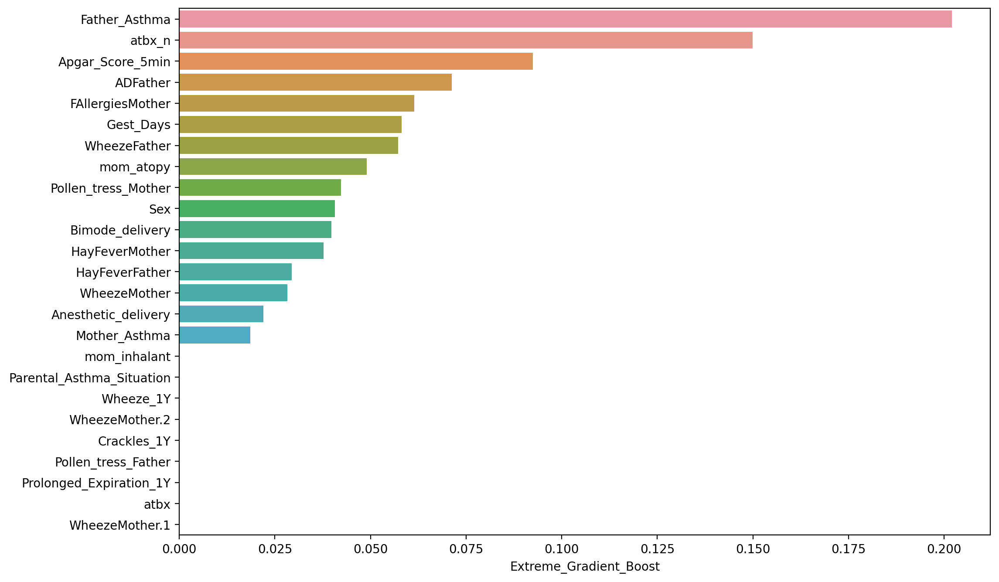

<IPython.core.display.Javascript object>

In [122]:
ml_run(
    X_train, X_test, y_train, y_test,
)

confussion matrix: [[15 10]
 [ 9 15]]

The performance score of Logistic Regression: 61.22448979591836 

              precision    recall  f1-score   support

           0       0.62      0.60      0.61        25
           1       0.60      0.62      0.61        24

    accuracy                           0.61        49
   macro avg       0.61      0.61      0.61        49
weighted avg       0.61      0.61      0.61        49

confussion matrix: [[24  1]
 [21  3]]

The performance score of Gaussian Naive Bayes: 21.428571428571427 

              precision    recall  f1-score   support

           0       0.53      0.96      0.69        25
           1       0.75      0.12      0.21        24

    accuracy                           0.55        49
   macro avg       0.64      0.54      0.45        49
weighted avg       0.64      0.55      0.45        49

confussion matrix: [[23  2]
 [ 8 16]]

The performance score of Random Forest: 76.1904761904762 

              precision    recall  f

(                        Accuracy  F1 score  Precision    Recall       AUC
 Model                                                                    
 Logistic Regression     0.612245  0.612245   0.600000  0.625000  0.612500
 Naive Bayes             0.551020  0.214286   0.750000  0.125000  0.542500
 Random Forest           0.795918  0.761905   0.888889  0.666667  0.793333
 K-Nearest Neighbour     0.775510  0.744186   0.842105  0.666667  0.773333
 Decision Tree           0.775510  0.755556   0.809524  0.708333  0.774167
 Support Vector Machine  0.632653  0.470588   0.800000  0.333333  0.626667
 Extreme Gradient Boost  0.632653  0.590909   0.650000  0.541667  0.630833,
 {'Logistic_Regression': 0.6122448979591836,
  'Naive_Bayes': 0.21428571428571427,
  'Random_Forest': 0.761904761904762,
  'K_Nearest_Neighbors': 0.744186046511628,
  'Decision_Tree': 0.7555555555555556,
  'Support Vector Classifier': 0.47058823529411764,
  'Extreme_Gradient_Boost': 0.5909090909090908},
 {'Logistic_Regress

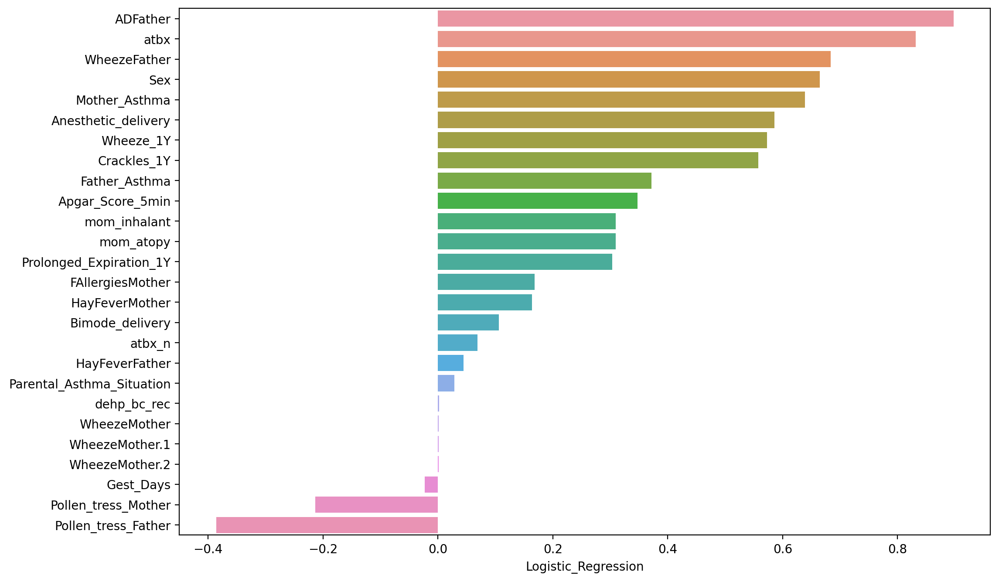

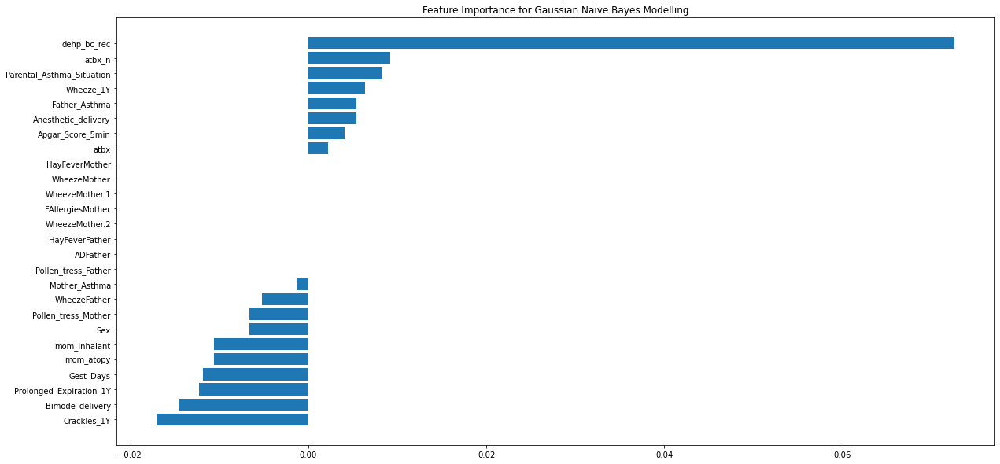

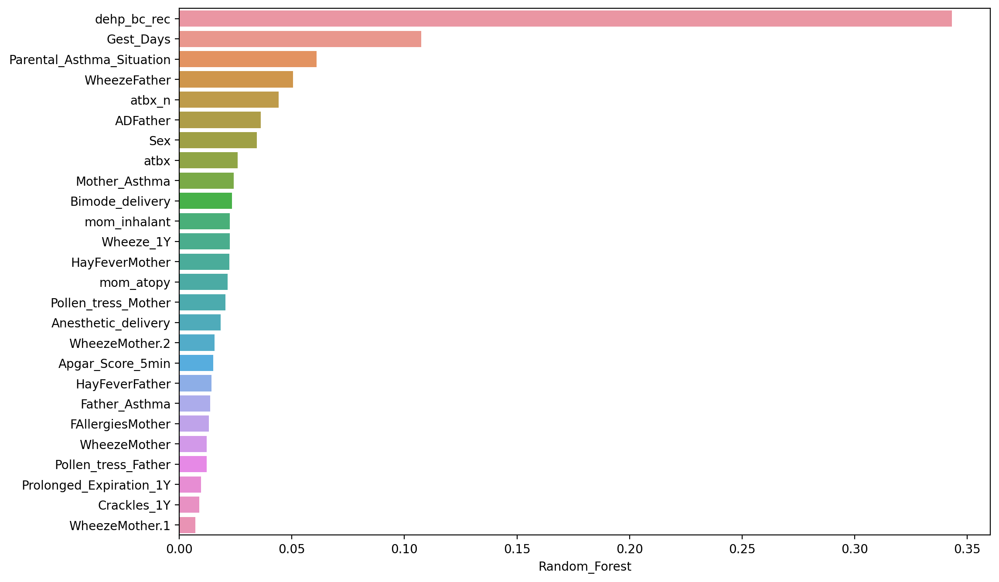

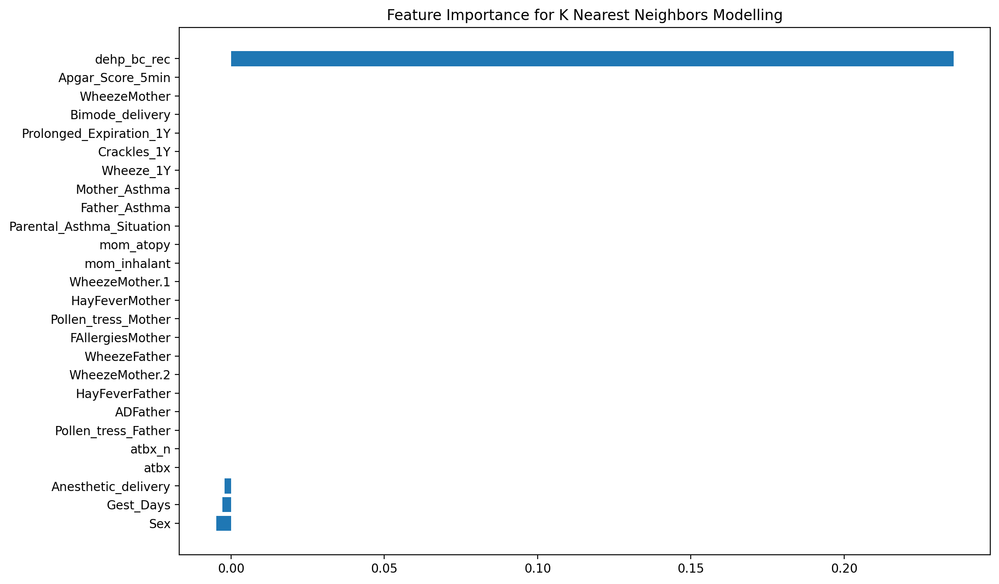

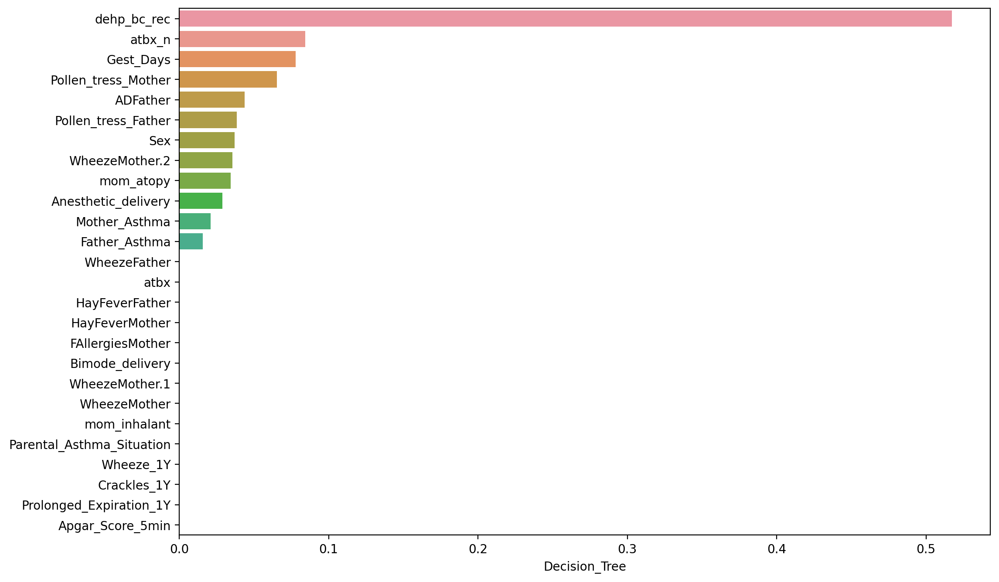

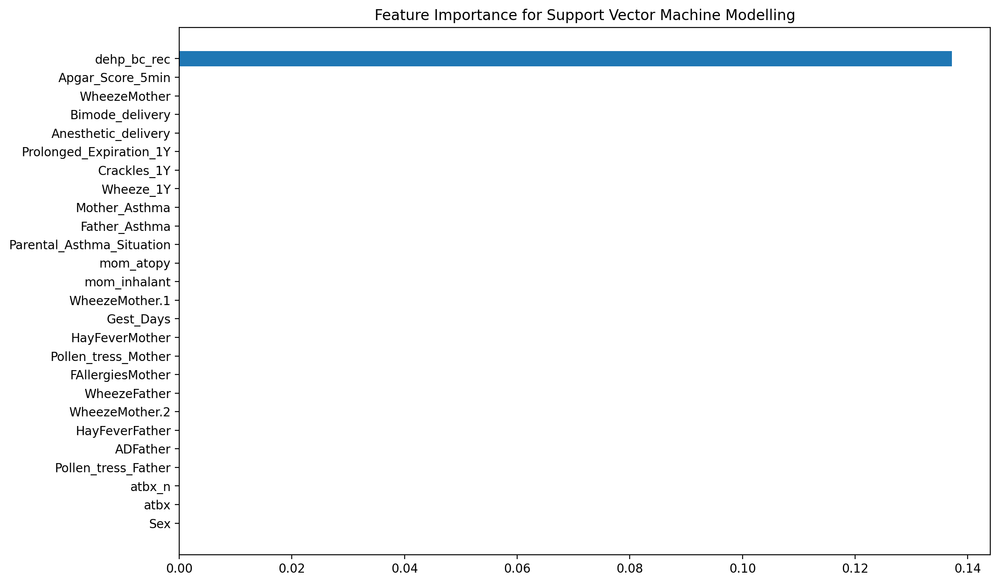

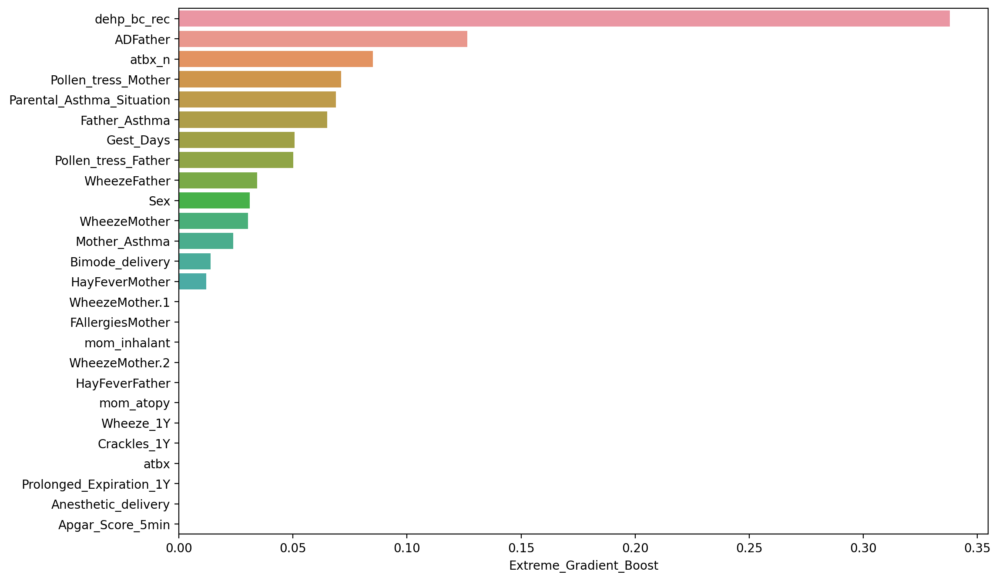

<IPython.core.display.Javascript object>

In [112]:
ml_run(
    X_train, X_test, y_train, y_test,
)

confussion matrix: [[81 41]
 [14 26]]

The performance score of K_Nearest_Neigbhors: 48.59813084112149 

              precision    recall  f1-score   support

           0       0.85      0.66      0.75       122
           1       0.39      0.65      0.49        40

    accuracy                           0.66       162
   macro avg       0.62      0.66      0.62       162
weighted avg       0.74      0.66      0.68       162

confussion matrix: [[52 70]
 [14 26]]

The performance score of Support_Vector_Machine: 38.23529411764705 

              precision    recall  f1-score   support

           0       0.79      0.43      0.55       122
           1       0.27      0.65      0.38        40

    accuracy                           0.48       162
   macro avg       0.53      0.54      0.47       162
weighted avg       0.66      0.48      0.51       162

confussion matrix: [[98 24]
 [26 14]]

The performance score of Naive_Bayes: 35.8974358974359 

              precision    recall  f1

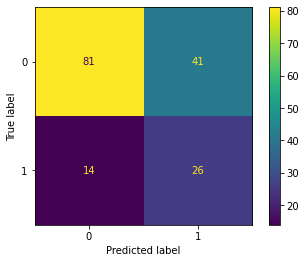

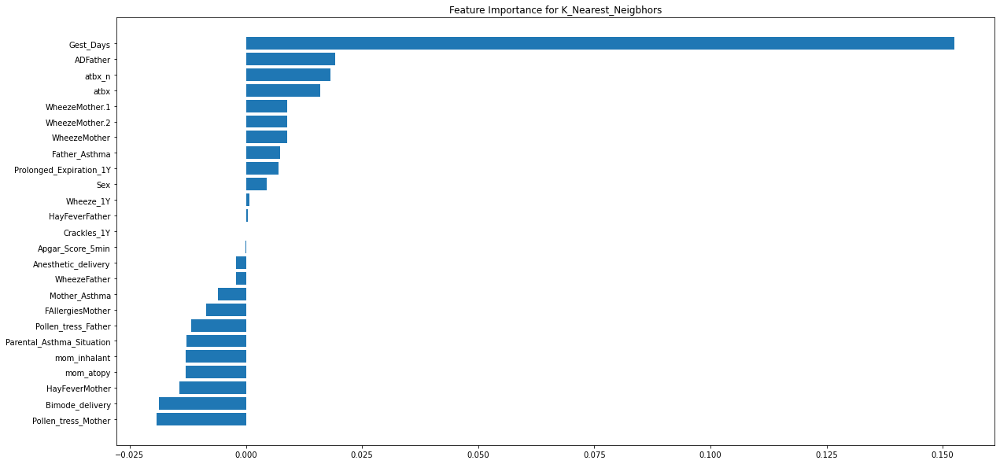

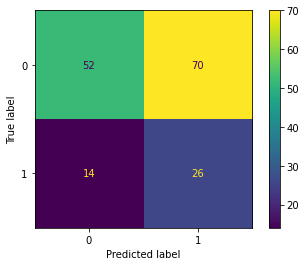

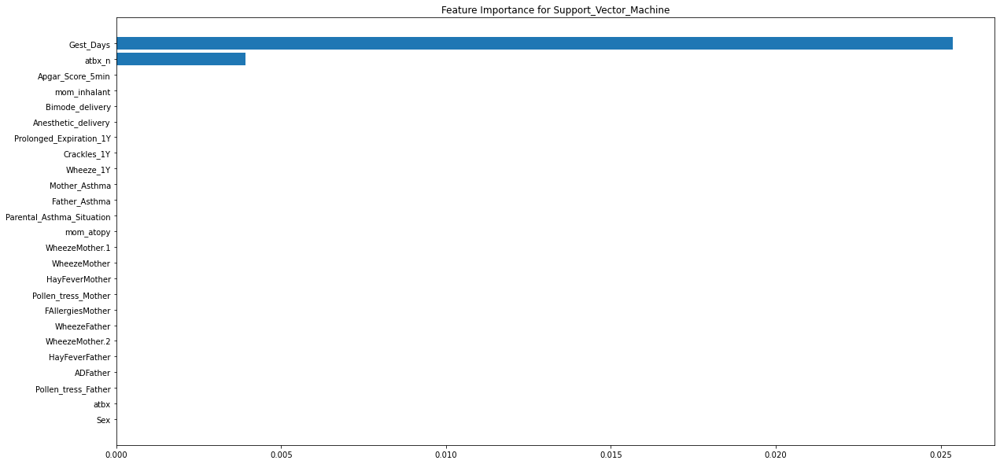

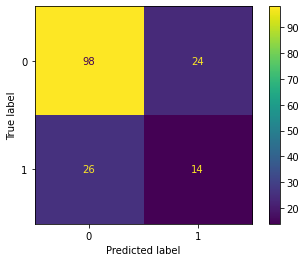

...

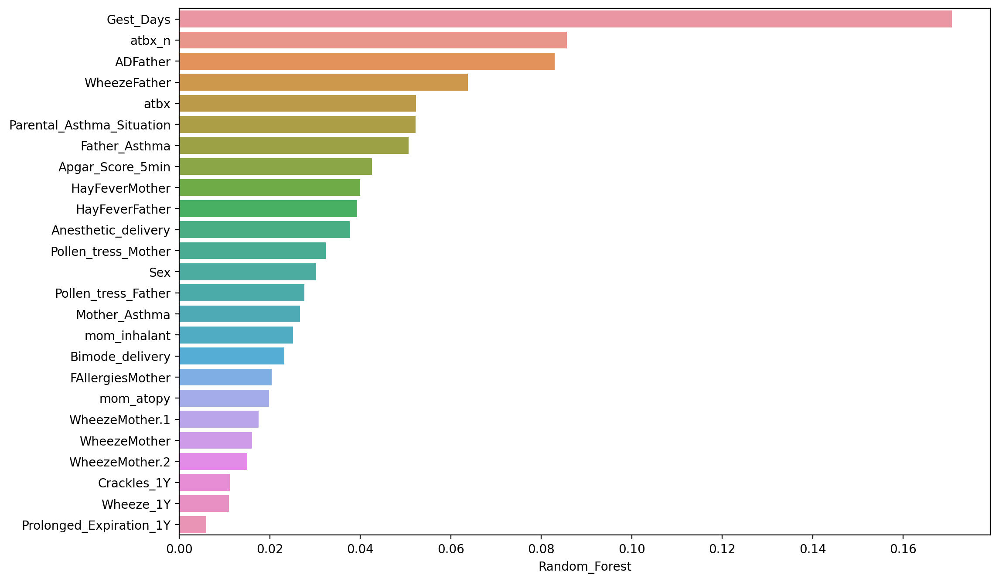

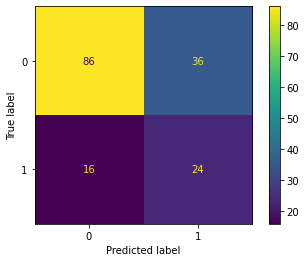

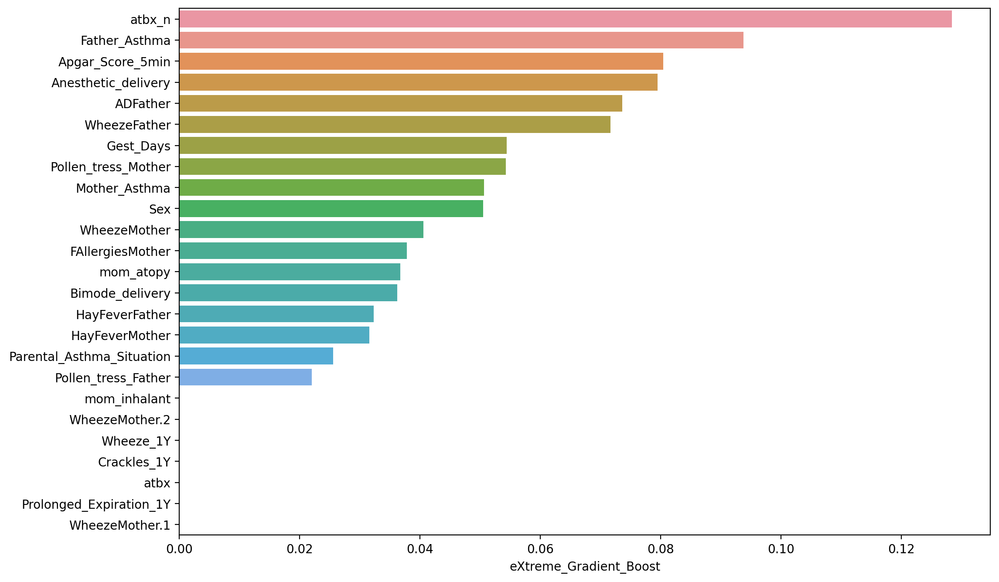

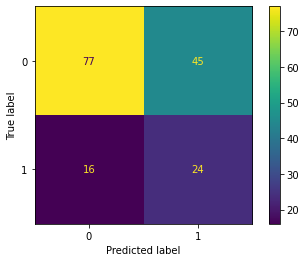

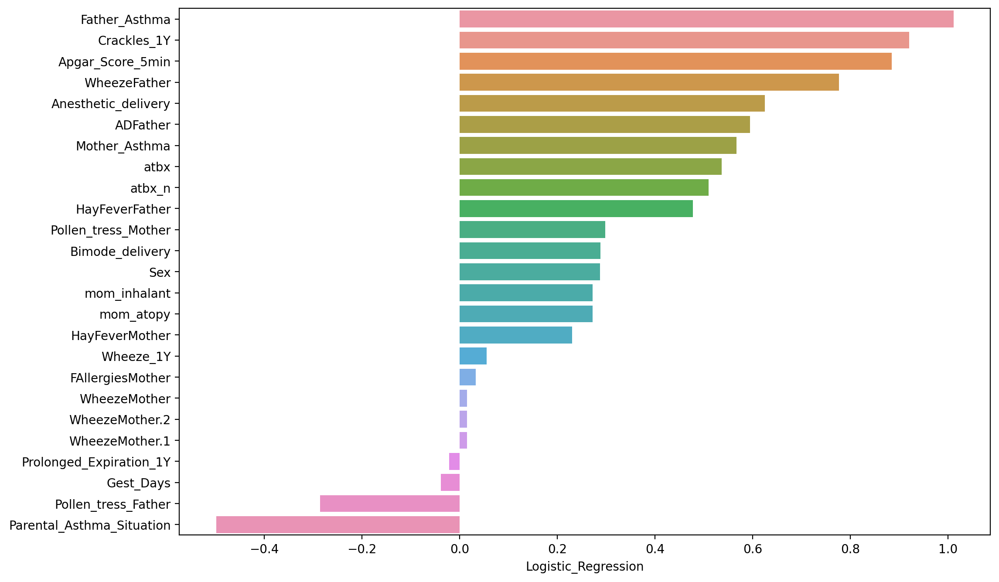

<IPython.core.display.Javascript object>

In [123]:
holdout_X = holdout_df.drop(columns=["target"])
ml_result_tuple_0923_holdout = df_ml_run(
    X_train, holdout_X, y_train, holdout_df["target"]
)

confussion matrix: [[18  7]
 [ 7 17]]

The performance score of K_Nearest_Neigbhors: 70.83333333333334 

              precision    recall  f1-score   support

           0       0.72      0.72      0.72        25
           1       0.71      0.71      0.71        24

    accuracy                           0.71        49
   macro avg       0.71      0.71      0.71        49
weighted avg       0.71      0.71      0.71        49

confussion matrix: [[20  5]
 [16  8]]

The performance score of Support_Vector_Machine: 43.24324324324324 

              precision    recall  f1-score   support

           0       0.56      0.80      0.66        25
           1       0.62      0.33      0.43        24

    accuracy                           0.57        49
   macro avg       0.59      0.57      0.54        49
weighted avg       0.58      0.57      0.55        49

confussion matrix: [[24  1]
 [17  7]]

The performance score of Naive_Bayes: 43.75000000000001 

              precision    recall  f

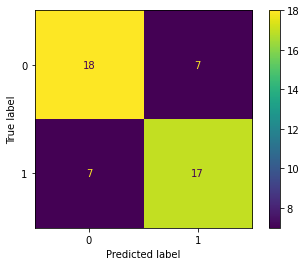

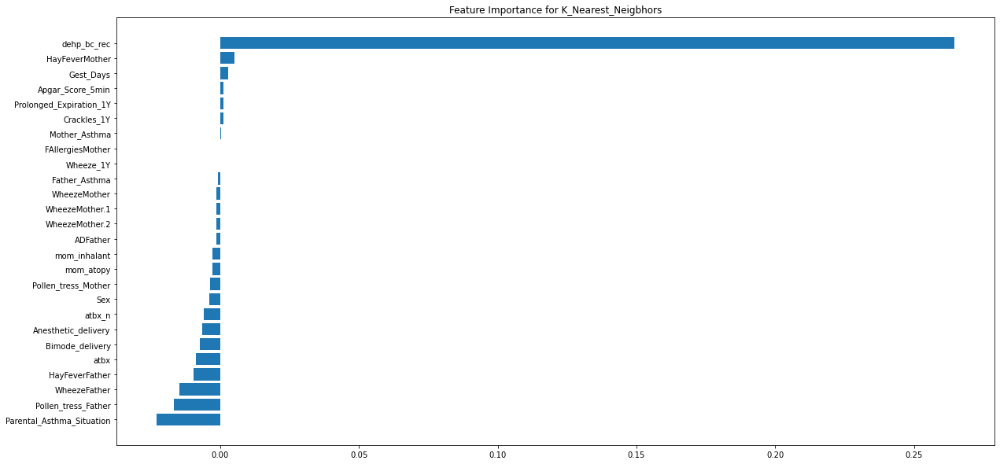

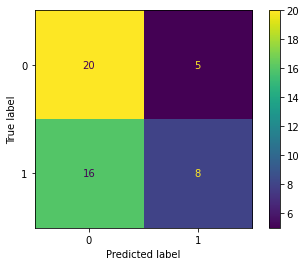

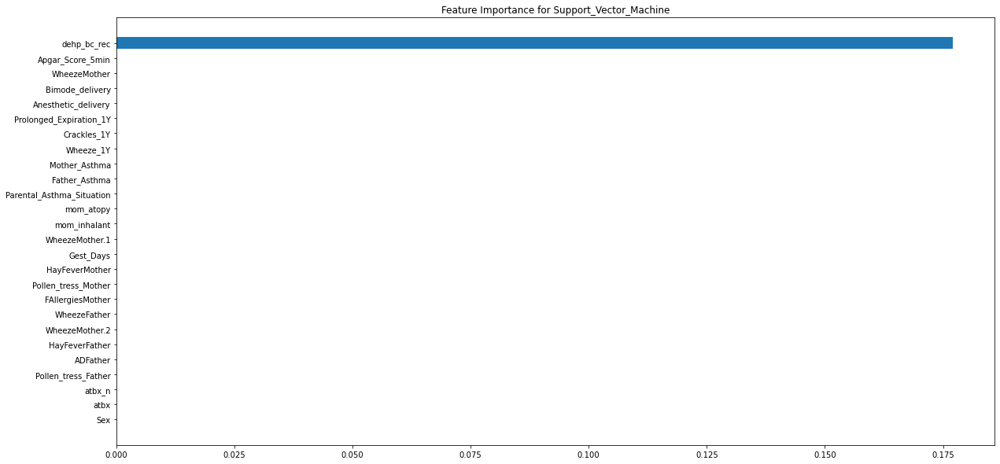

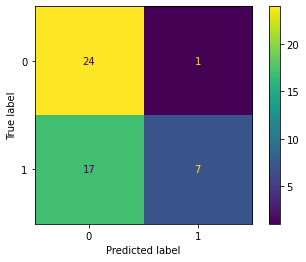

...

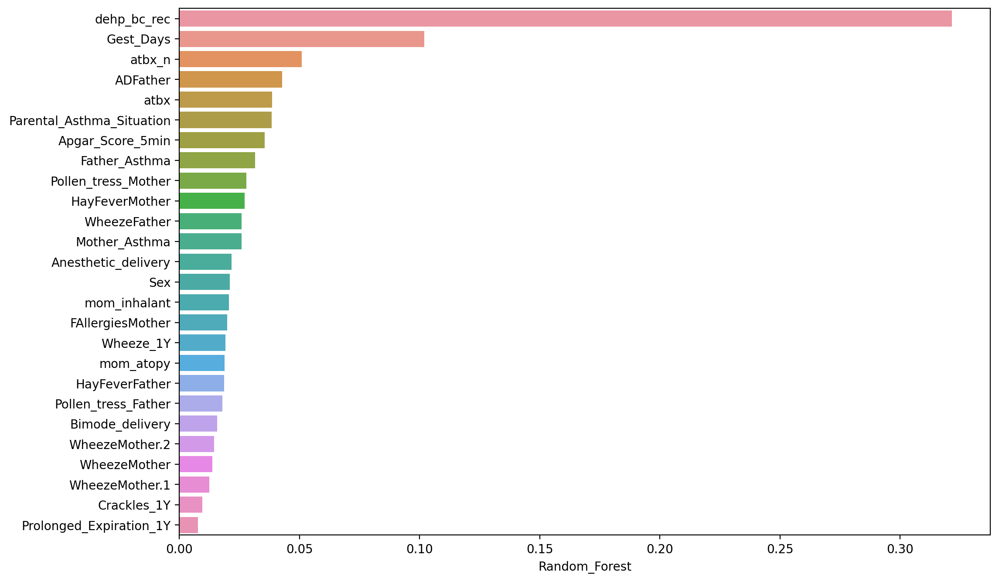

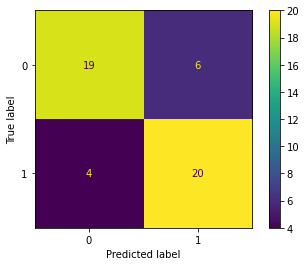

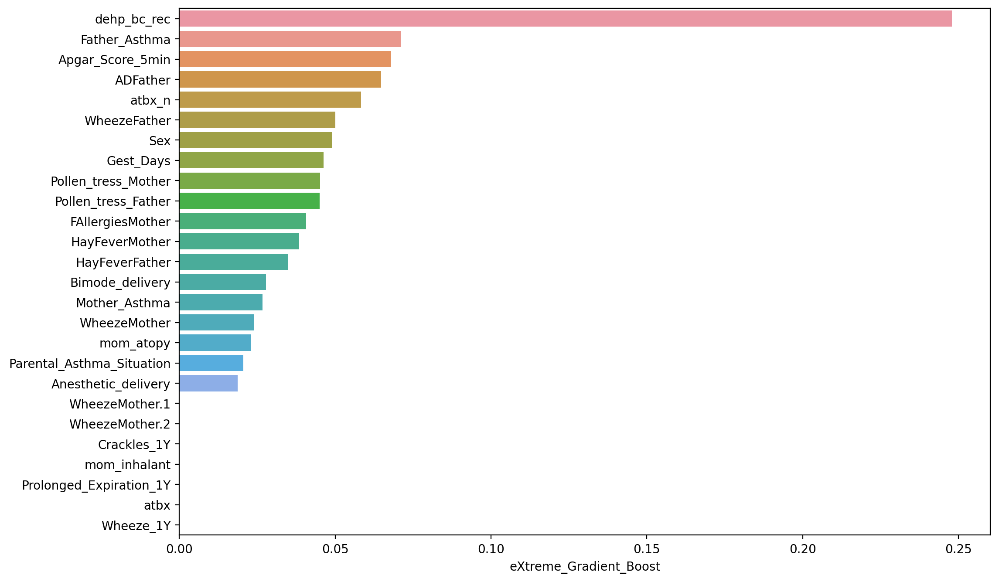

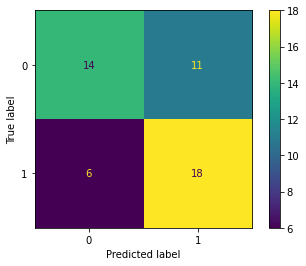

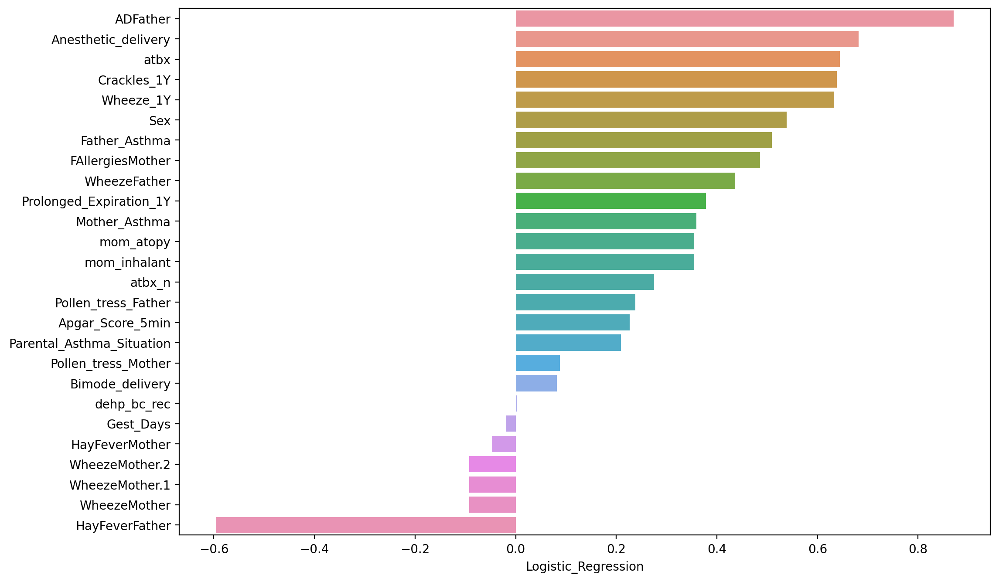

<IPython.core.display.Javascript object>

In [80]:
ml_result_tuple_0923 = df_ml_run(X_train, X_test, y_train, y_test,)

In [85]:
ml_result_tuple_0923[0].style.background_gradient(cmap="Greens")
ml_result_tuple_0923[1].style.background_gradient(cmap="Greens")
ml_result_tuple_0923[2].style.background_gradient(cmap="Greens")

,Accuracy,F1 score,Precision,Recall,AUC
Model,,,,,
Logistic Regression,0.653061,0.679245,0.620690,0.750000,0.655000
Naive Bayes,0.632653,0.437500,0.875000,0.291667,0.625833
Random Forest,0.673469,0.652174,0.681818,0.625000,0.672500
K-Nearest Neighbours,0.714286,0.708333,0.708333,0.708333,0.714167
Decision Tree,0.755102,0.750000,0.750000,0.750000,0.755000
Support Vector Machine,0.571429,0.432432,0.615385,0.333333,0.566667
Extreme Gradient Boost,0.795918,0.800000,0.769231,0.833333,0.796667


,K_Nearest_Neigbhors,Support_Vector_Machine,Naive_Bayes,Decision_Tree,Random_Forest,eXtreme_Gradient_Boost,Logistic_Regression,Weighted_Importance
Sex,-0.014807,0.000000,-0.023986,0.000000,0.065228,0.198000,0.618802,0.158697
Bimode_delivery,-0.027682,0.000000,0.000000,0.000000,0.048774,0.112460,0.094282,0.043941
Anesthetic_delivery,-0.024648,0.000000,0.103626,0.078759,0.067853,0.075509,0.782857,0.191237
Prolonged_Expiration_1Y,0.004025,0.000000,-0.052605,0.000000,0.023971,0.000000,0.434374,0.076805
Crackles_1Y,0.004025,0.000000,-0.042305,0.000000,0.029646,0.000000,0.733587,0.132706
Wheeze_1Y,0.000000,0.000000,0.013226,0.000000,0.060006,0.000000,0.727341,0.142488
Mother_Asthma,0.001327,0.000000,0.073640,0.042364,0.080494,0.107833,0.412422,0.127911
Father_Asthma,-0.003436,0.000000,0.196986,0.000000,0.097985,0.286542,0.585179,0.204722
Parental_Asthma_Situation,-0.087128,0.000000,0.277384,0.000000,0.119615,0.082704,0.240379,0.097049
mom_atopy,-0.010872,0.000000,0.010842,0.000000,0.058864,0.092486,0.408250,0.102239


,Confusion_Matrix_Summary,Pred_0,Pred_1
K_Nearest_Neigbhors,"{'Pr0': {'Tr0': 18, 'Tr1': 7}, 'Pr1': {'Tr0': 7, 'Tr1': 17}}","{'Tr0': 18, 'Tr1': 7}","{'Tr0': 7, 'Tr1': 17}"
Support_Vector_Machine,"{'Pr0': {'Tr0': 20, 'Tr1': 16}, 'Pr1': {'Tr0': 5, 'Tr1': 8}}","{'Tr0': 20, 'Tr1': 16}","{'Tr0': 5, 'Tr1': 8}"
Naive_Bayes,"{'Pr0': {'Tr0': 24, 'Tr1': 17}, 'Pr1': {'Tr0': 1, 'Tr1': 7}}","{'Tr0': 24, 'Tr1': 17}","{'Tr0': 1, 'Tr1': 7}"
Decision_Tree,"{'Pr0': {'Tr0': 19, 'Tr1': 6}, 'Pr1': {'Tr0': 6, 'Tr1': 18}}","{'Tr0': 19, 'Tr1': 6}","{'Tr0': 6, 'Tr1': 18}"
Random_Forest,"{'Pr0': {'Tr0': 18, 'Tr1': 9}, 'Pr1': {'Tr0': 7, 'Tr1': 15}}","{'Tr0': 18, 'Tr1': 9}","{'Tr0': 7, 'Tr1': 15}"
eXtreme_Gradient_Boost,"{'Pr0': {'Tr0': 19, 'Tr1': 4}, 'Pr1': {'Tr0': 6, 'Tr1': 20}}","{'Tr0': 19, 'Tr1': 4}","{'Tr0': 6, 'Tr1': 20}"
Logistic_Regression,"{'Pr0': {'Tr0': 14, 'Tr1': 6}, 'Pr1': {'Tr0': 11, 'Tr1': 18}}","{'Tr0': 14, 'Tr1': 6}","{'Tr0': 11, 'Tr1': 18}"


<IPython.core.display.Javascript object>

DecisionTreeClassifier(criterion='entropy', max_depth=6, random_state=0)

confussion matrix
[[18  7]
 [ 9 15]]


Precison of DecisionTreeClassifier: 68.18181818181817 

              precision    recall  f1-score   support

           0       0.67      0.72      0.69        25
           1       0.68      0.62      0.65        24

    accuracy                           0.67        49
   macro avg       0.67      0.67      0.67        49
weighted avg       0.67      0.67      0.67        49



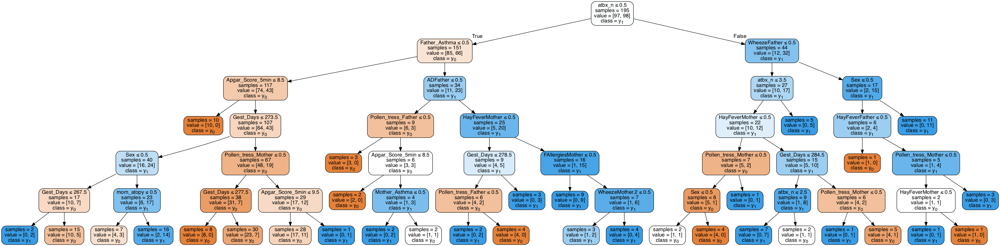

<IPython.core.display.Javascript object>

In [194]:
#!pip install pydotplus
m5 = "DecisionTreeClassifier"
dt = DecisionTreeClassifier(criterion="entropy", random_state=0, max_depth=6)
dt.fit(X_train, y_train)
dt_predicted = dt.predict(X_test)
dt_conf_matrix = confusion_matrix(y_test, dt_predicted)
dt_prec_score = precision_score(y_test, dt_predicted)
print("confussion matrix")
print(dt_conf_matrix)
print("\n")
print("Precison of DecisionTreeClassifier:", dt_prec_score * 100, "\n")
print(classification_report(y_test, dt_predicted))

from six import StringIO
from IPython.display import Image
import pydotplus

col_names_list = list(X_train.columns.values)
dot_data = StringIO()
export_graphviz(
    dt,
    out_file=dot_data,
    filled=True,
    rounded=True,
    special_characters=True,
    feature_names=col_names_list,
    impurity=False,
    # proportion=True,
    # precision=2,
    # node_ids=True,
    class_names=True,
    # leaves_parallel=False,
    # rotate=True,
)

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

In [ ]:
holdout_df

In [ ]:
ml_run(
    X_train, X_test, y_train, y_test,
)

#### Repeat Baseline Result

In [40]:
# Restore df_child
df_child = df_child_backup.copy()
df_targeted = df_target_selector(
    df_child, target_name="Asthma_Diagnosis_5yCLA", target_mapping={2: np.nan},
)
df_targeted[FEATURE_SELECTED_BASELINE]

The dimension of original dataframe for process is (3455, 170)
The number of missing value for target label is: 809
****Target variable will be renamed to y for easy access.**** 


,Gender,Mode_of_delivery,Anesthetic_delivery,Prolonged_Expiration_1yCLA,Crackles_1yCLA,Wheeze_1yCLA,Mother_Asthma,Father_Asthma,Parental_Asthma,Mom_Atopy,...,FAllergies_Mother,Wheeze_Father,Hayfever_Father,AD_Father,Pollentress_Father,Number_of_AntibioticsCourse,Antibiotics_Usage,Gest_Days,Apgar_Score_5min,y
Subject_Number,,,,,,,,,,,,,,,,,,,,,
20059,F,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,1.0,0.0,0,0,276.0,9.0,0.0
20060,M,8.0,1.0,NaN,NaN,NaN,1.0,0.0,1.0,NaN,...,1.0,0.0,1.0,1.0,0.0,0,0,292.0,6.0,0.0
20061,M,8.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0,0,269.0,9.0,0.0
20062,F,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,1.0,0.0,0.0,0,0,279.0,10.0,0.0
20063,M,1.0,1.0,NaN,NaN,NaN,1.0,0.0,1.0,1.0,...,0.0,1.0,1.0,1.0,0.0,0,0,273.0,9.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50859,M,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,1.0,0.0,1.0,0,0,280.0,9.0,0.0
50861,M,1.0,1.0,0.0,0.0,0.0,0.0,NaN,NaN,1.0,...,0.0,NaN,NaN,NaN,NaN,0,0,275.0,9.0,0.0
50862,M,3.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,0,0,272.0,9.0,1.0


<IPython.core.display.Javascript object>

In [41]:
BirthTransformer().fit_transform(df_targeted)

,Gender,Gest_Days,Weight_0m,Weight_3m,Weight_12m,Weight_36m,Weight_60m,Weight_for_age_0m,Weight_for_age_3m,Weight_for_age_12m,...,Recurrent_Wheeze_1y,Recurrent_Wheeze_5y,Prenatal_Mother_Condition,First_10min_Measure,BF_Status_3m,BF_Status_6m,Wheeze_Traj_Type,Mother_Caucasian,Father_Caucasian,Child_Ethinicity
Subject_Number,,,,,,,,,,,,,,,,,,,,,
20059,F,276.0,3.346,6.20,NaN,16.7,20.5,0.25,0.39,NaN,...,0.0,0.0,1.0,0.0,Partial,Partial,1.0,1.0,1.0,Caucasian
20060,M,292.0,3.308,6.75,NaN,NaN,20.6,-0.08,-0.47,NaN,...,0.0,0.0,0.0,2.0,Exclusive,Zero,1.0,1.0,1.0,Caucasian
20061,M,269.0,3.370,6.53,9.30,17.0,21.0,0.05,-0.14,-0.54,...,0.0,0.0,NaN,0.0,Exclusive,Partial,1.0,0.0,1.0,HalfCaucas
20062,F,279.0,3.055,5.60,8.18,13.8,16.5,-0.39,-0.36,-1.01,...,0.0,0.0,0.0,NaN,Exclusive,Partial,1.0,1.0,1.0,Caucasian
20063,M,273.0,3.485,5.90,NaN,14.6,19.9,0.28,-0.98,NaN,...,0.0,0.0,0.0,0.0,Exclusive,Exclusive,3.0,1.0,1.0,Caucasian
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50859,M,280.0,3.800,5.52,8.50,14.5,18.3,0.89,-1.20,-1.58,...,0.0,0.0,1.0,0.0,Exclusive,Exclusive,1.0,1.0,1.0,Caucasian
50861,M,275.0,2.520,5.66,9.20,14.2,16.5,-1.85,-1.41,-0.42,...,0.0,1.0,0.0,0.0,Zero,Zero,2.0,0.0,0.0,NonCaucas
50862,M,272.0,3.648,7.04,9.70,14.3,16.8,0.60,0.52,-0.03,...,0.0,1.0,1.0,0.0,Partial,Partial,2.0,1.0,1.0,Caucasian


<IPython.core.display.Javascript object>

In [44]:
df_targeted.Mode_of_delivery = df_targeted.Mode_of_delivery.replace(
    {"Vaginal": 1, "Caesarean": 0}
)

df_targeted.Gender = df_targeted.Gender.replace({"M": 1, "F": 0})

<IPython.core.display.Javascript object>

In [50]:
df_ml_baseline = df_simpleimputer_scaled(df_targeted[FEATURE_SELECTED_BASELINE])

<IPython.core.display.Javascript object>

In [55]:
X_train, X_test, X_holdout, y_train, y_test, y_holdout = df_split(
    df=df_ml_baseline,
    balancing="Under",
    sampling_random_state=3,
    holdout_random_state=3,
    split_random_state=3,
)

The number of repeated (redundant) samples in the holdout dataset given your selection of features for modelling are 600 - 584
The number of repeated (redundant) samples in the train, test/eval dataset (rest) given your selection of features for modelling are 1799 - 1729
You can drop duplicates with 'remove_duplicates=True' parameter


<IPython.core.display.Javascript object>

In [53]:
y_train.value_counts()
y_test.value_counts()
y_holdout.value_counts()

0.0    99
1.0    99
Name: y, dtype: int64

0.0    25
1.0    25
Name: y, dtype: int64

0.0    559
1.0     41
Name: y, dtype: int64

<IPython.core.display.Javascript object>

#### Original Splitting

In [60]:
from imblearn.under_sampling import RandomUnderSampler

# define undersample strategy
undersample = RandomUnderSampler(sampling_strategy="majority")
# fit and apply the transform
X_under, y_under = undersample.fit_resample(X, y)
y_under.value_counts()

X_train, X_test, y_train, y_test = train_test_split(
    X_under, y_under, test_size=0.2, stratify=y_under, random_state=0
)
y_test.value_counts()

0.0    152
1.0    152
Name: y, dtype: int64

0.0    31
1.0    30
Name: y, dtype: int64

<IPython.core.display.Javascript object>

confussion matrix: [[18 13]
 [10 20]]

The performance score of Logistic Regression: 63.49206349206349 

              precision    recall  f1-score   support

         0.0       0.64      0.58      0.61        31
         1.0       0.61      0.67      0.63        30

    accuracy                           0.62        61
   macro avg       0.62      0.62      0.62        61
weighted avg       0.62      0.62      0.62        61

confussion matrix: [[24  7]
 [23  7]]

The performance score of Gaussian Naive Bayes: 31.818181818181817 

              precision    recall  f1-score   support

         0.0       0.51      0.77      0.62        31
         1.0       0.50      0.23      0.32        30

    accuracy                           0.51        61
   macro avg       0.51      0.50      0.47        61
weighted avg       0.51      0.51      0.47        61

confussion matrix: [[18 13]
 [11 19]]

The performance score of Random Forest: 61.29032258064516 

              precision    recall  

(                        Accuracy  F1 score  Precision    Recall       AUC
 Model                                                                    
 Logistic Regression     0.622951  0.634921   0.606061  0.666667  0.623656
 Naive Bayes             0.508197  0.318182   0.500000  0.233333  0.503763
 Random Forest           0.606557  0.612903   0.593750  0.633333  0.606989
 K-Nearest Neighbour     0.491803  0.367347   0.473684  0.300000  0.488710
 Decision Tree           0.540984  0.548387   0.531250  0.566667  0.541398
 Support Vector Machine  0.606557  0.612903   0.593750  0.633333  0.606989
 Extreme Gradient Boost  0.459016  0.476190   0.454545  0.500000  0.459677,
 {'Logistic_Regression': 0.6349206349206349,
  'Naive_Bayes': 0.3181818181818182,
  'Random_Forest': 0.6129032258064516,
  'K_Nearest_Neighbors': 0.3673469387755102,
  'Decision_Tree': 0.5483870967741935,
  'Support Vector Classifier': 0.6129032258064516,
  'Extreme_Gradient_Boost': 0.47619047619047616},
 {'Logistic_Regres

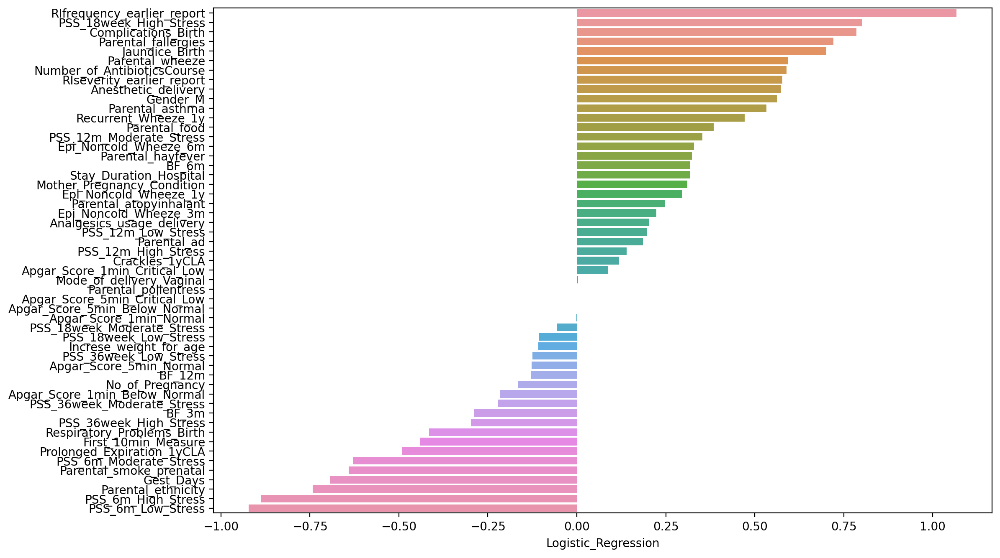

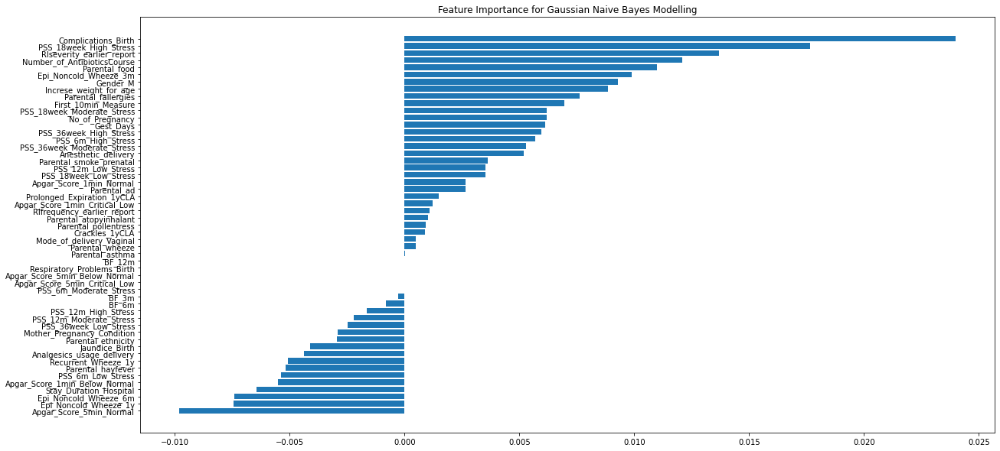

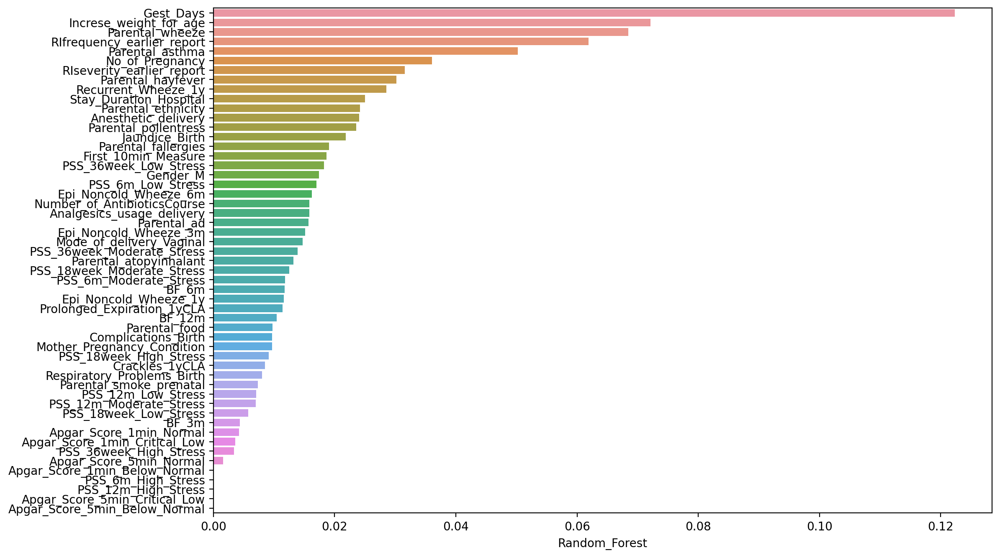

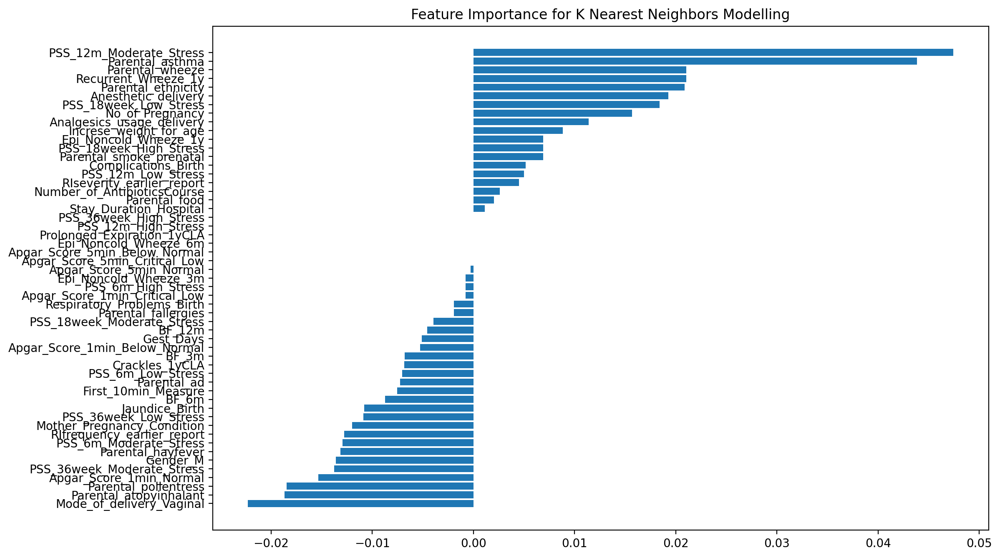

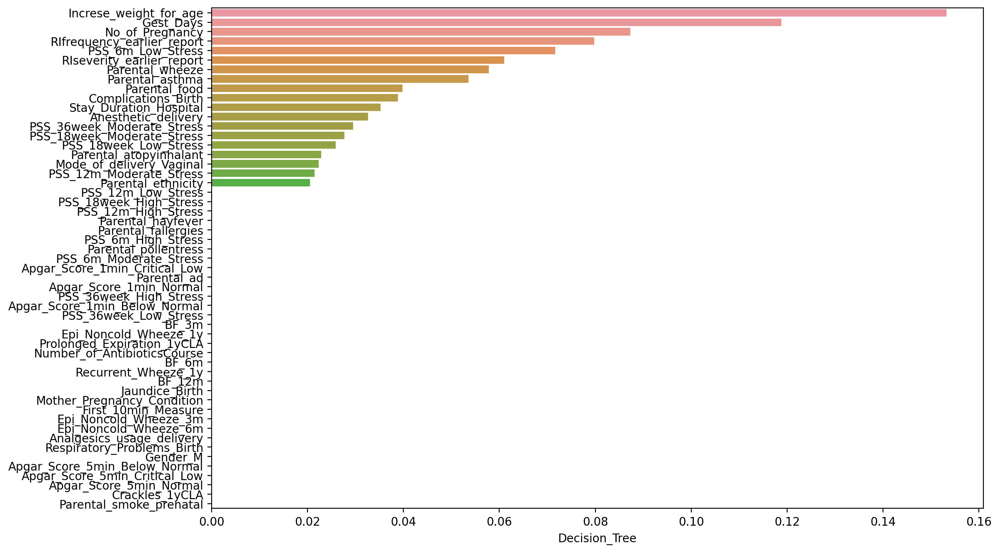

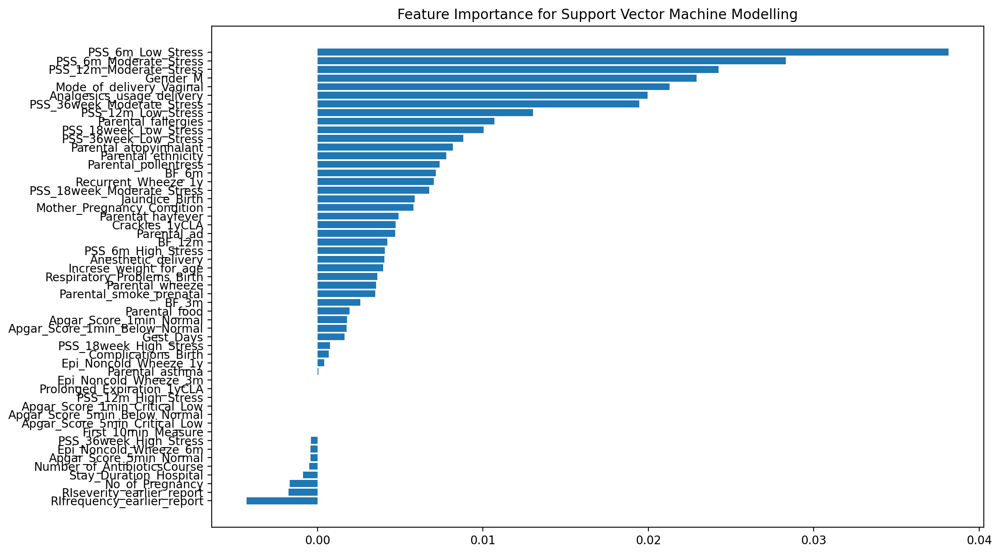

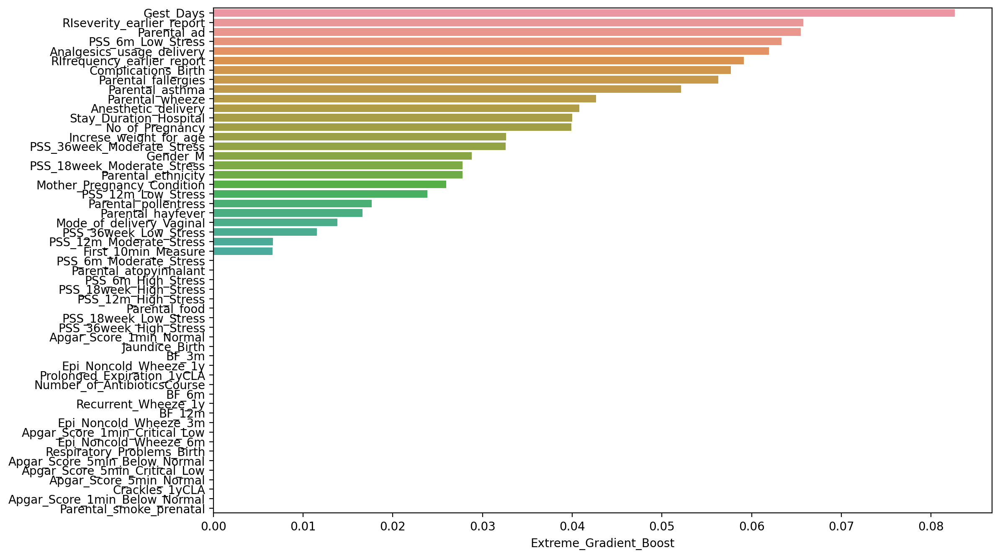

<IPython.core.display.Javascript object>

In [62]:
ml_run(X_train, X_test, y_train, y_test)

confussion matrix: [[18 13]
 [17 13]]

The performance score of K_Nearest_Neigbhors: 46.42857142857143 

              precision    recall  f1-score   support

         0.0       0.51      0.58      0.55        31
         1.0       0.50      0.43      0.46        30

    accuracy                           0.51        61
   macro avg       0.51      0.51      0.50        61
weighted avg       0.51      0.51      0.51        61

confussion matrix: [[18 13]
 [11 19]]

The performance score of Support_Vector_Machine: 61.29032258064516 

              precision    recall  f1-score   support

         0.0       0.62      0.58      0.60        31
         1.0       0.59      0.63      0.61        30

    accuracy                           0.61        61
   macro avg       0.61      0.61      0.61        61
weighted avg       0.61      0.61      0.61        61

confussion matrix: [[24  7]
 [23  7]]

The performance score of Naive_Bayes: 31.818181818181817 

              precision    recall  

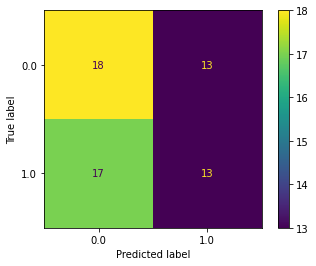

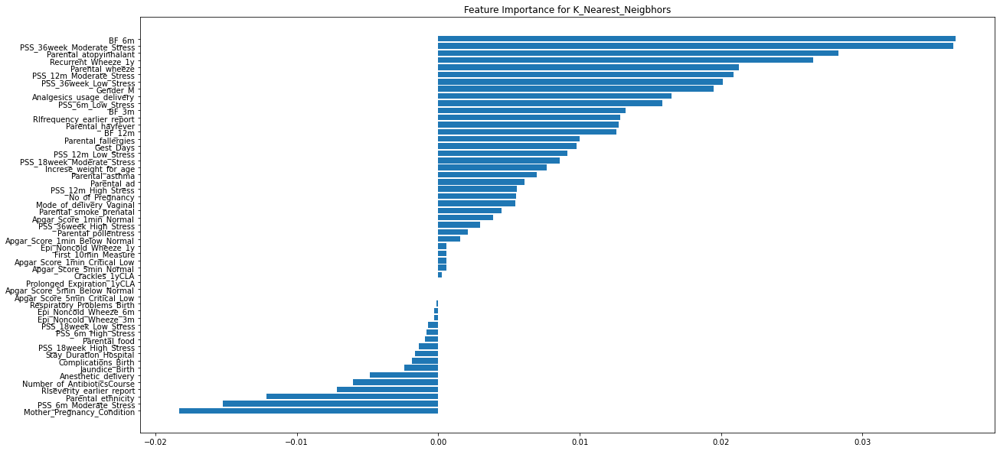

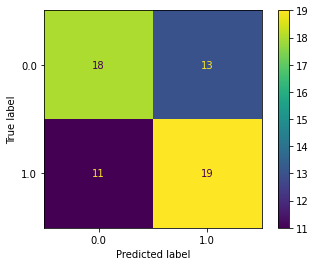

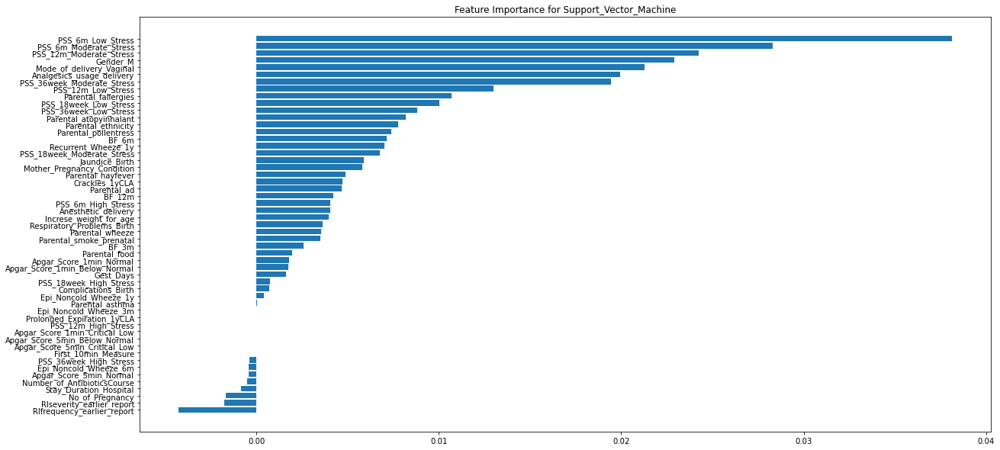

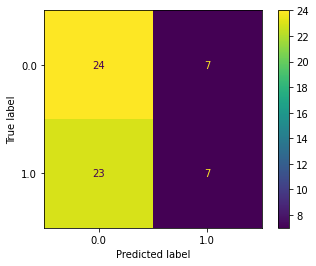

...

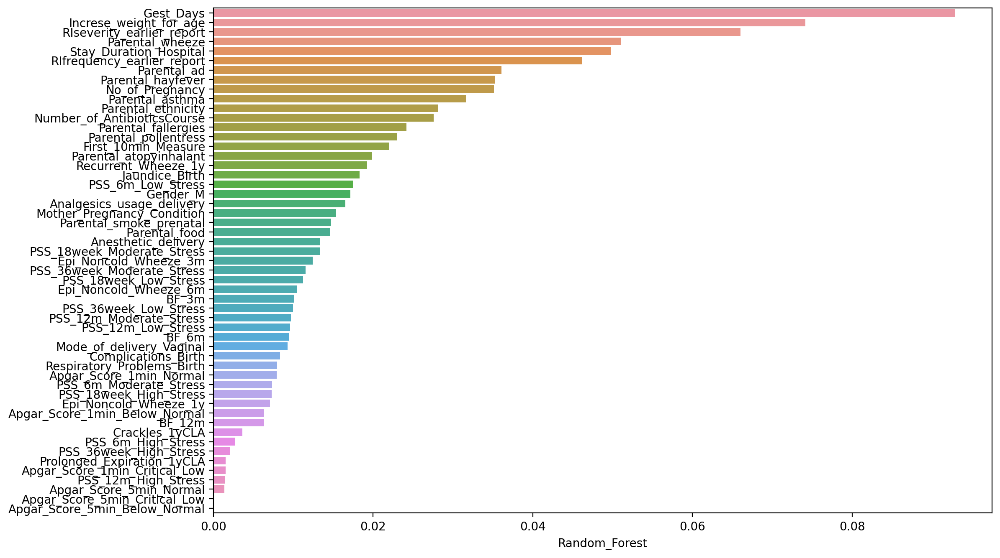

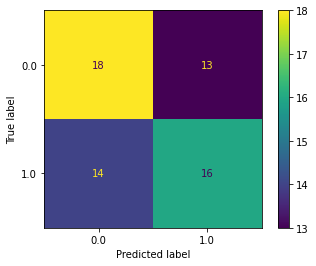

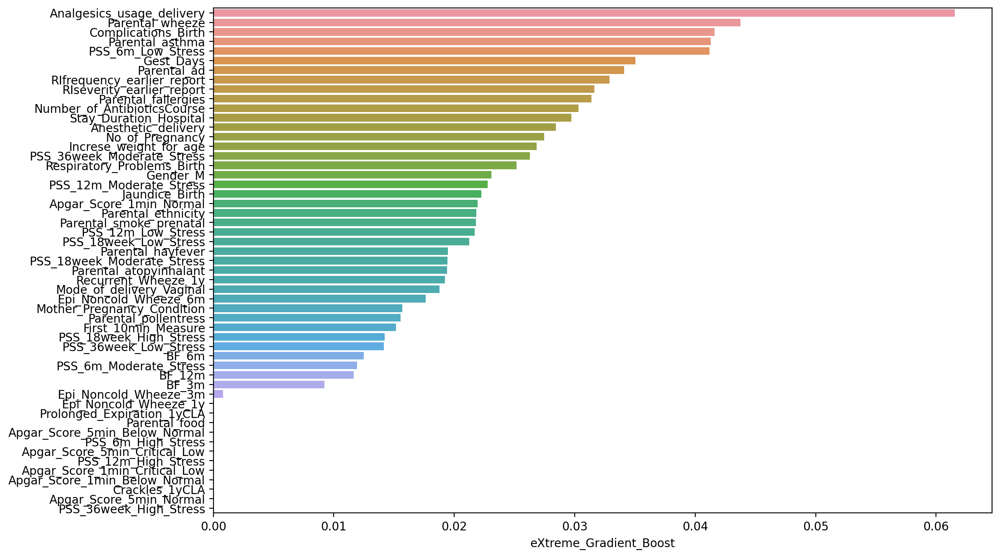

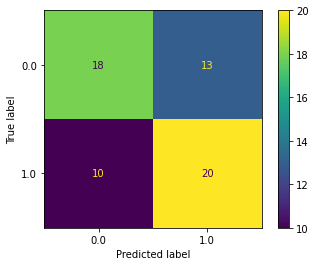

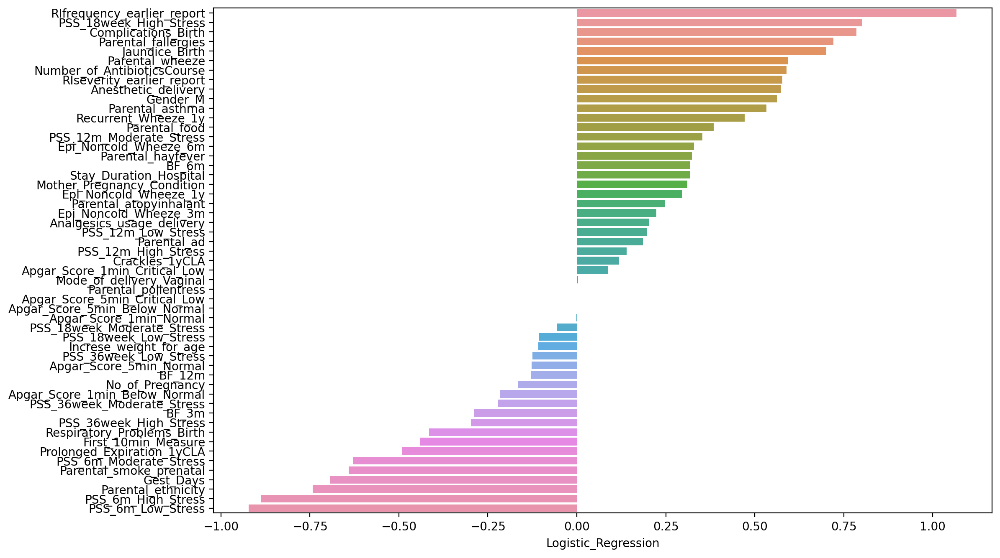

<IPython.core.display.Javascript object>

In [61]:
ml_baseline_result_previous = df_ml_run(X_train, X_test, y_train, y_test)

confussion matrix: [[17  8]
 [11 14]]

The performance score of K_Nearest_Neigbhors: 59.57446808510639 

              precision    recall  f1-score   support

         0.0       0.61      0.68      0.64        25
         1.0       0.64      0.56      0.60        25

    accuracy                           0.62        50
   macro avg       0.62      0.62      0.62        50
weighted avg       0.62      0.62      0.62        50

confussion matrix: [[17  8]
 [11 14]]

The performance score of Support_Vector_Machine: 59.57446808510639 

              precision    recall  f1-score   support

         0.0       0.61      0.68      0.64        25
         1.0       0.64      0.56      0.60        25

    accuracy                           0.62        50
   macro avg       0.62      0.62      0.62        50
weighted avg       0.62      0.62      0.62        50

confussion matrix: [[25  0]
 [21  4]]

The performance score of Naive_Bayes: 27.58620689655173 

              precision    recall  f

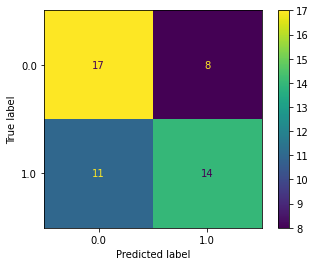

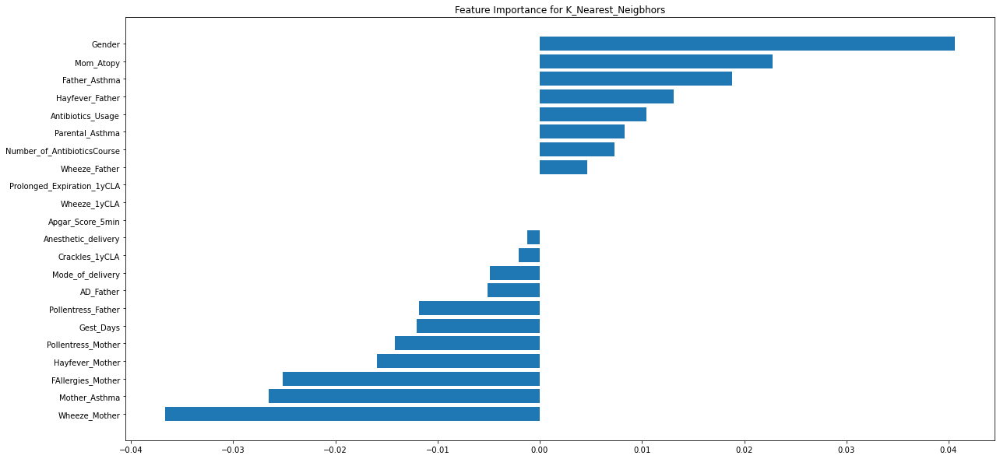

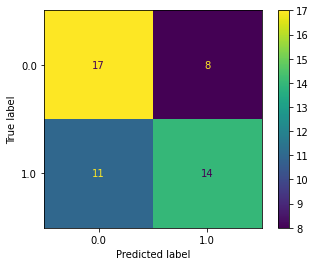

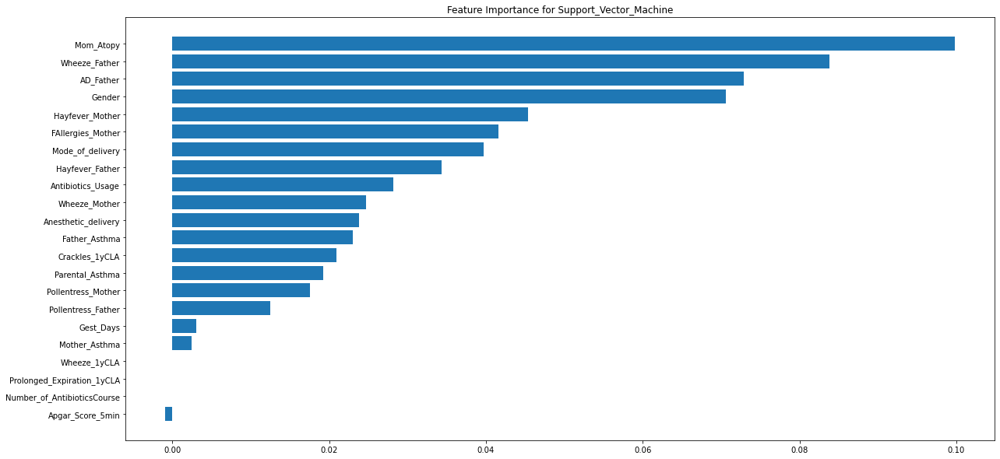

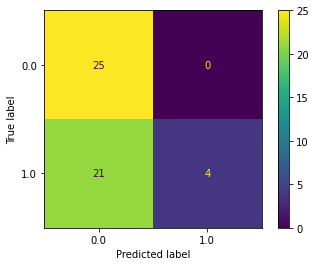

...

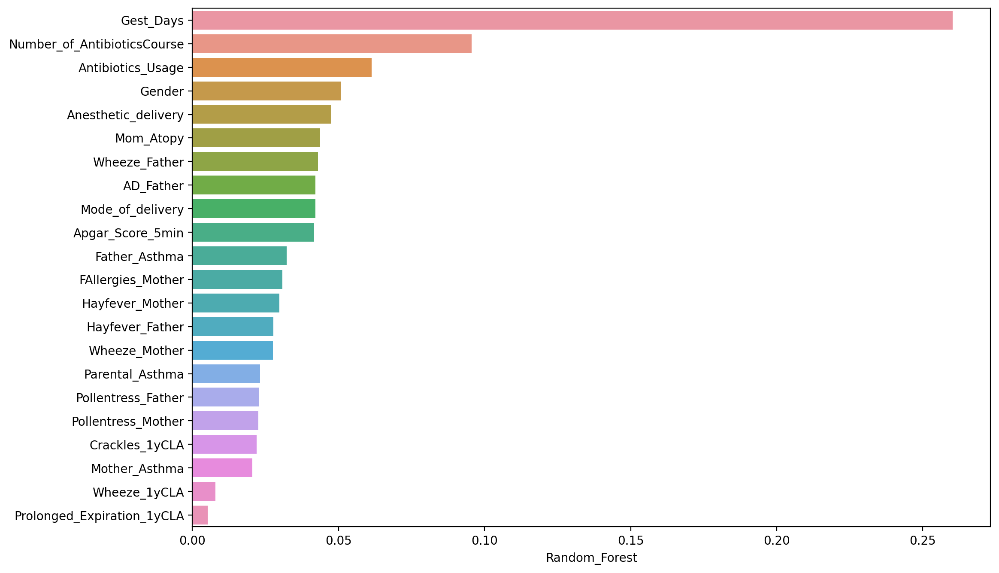

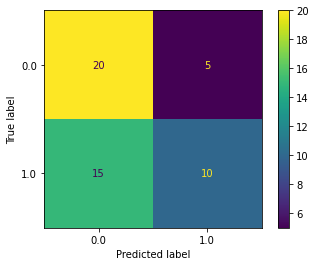

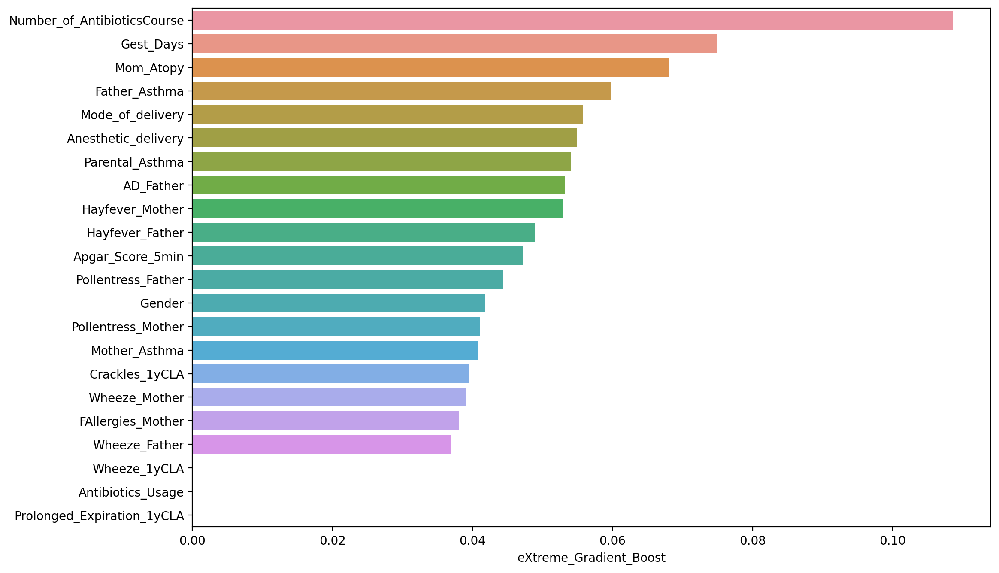

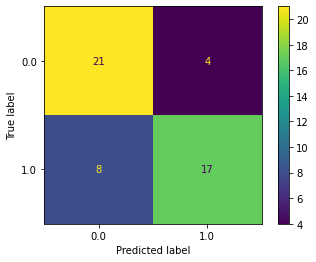

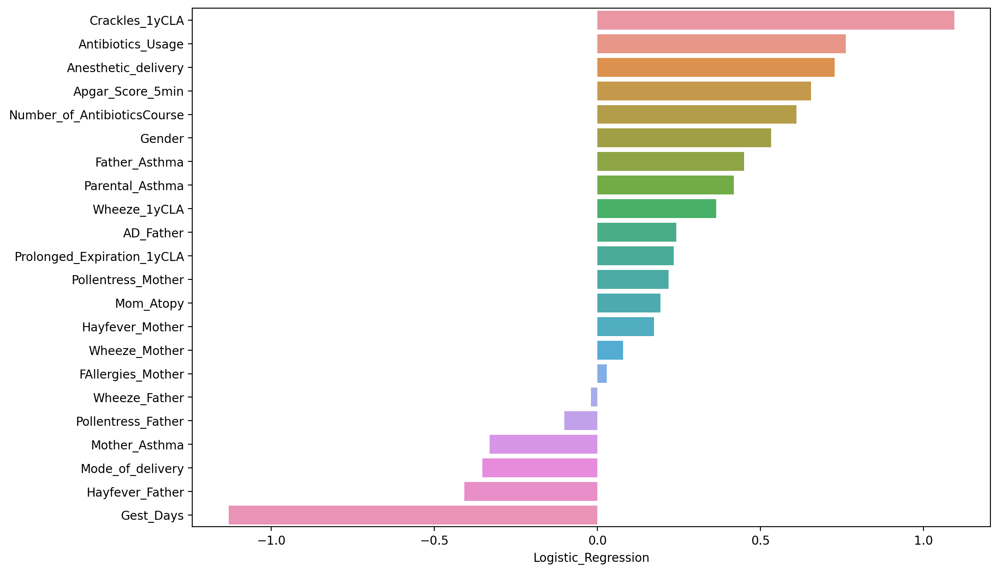

<IPython.core.display.Javascript object>

In [57]:
ml_baseline_result_222 = df_ml_run(X_train, X_test, y_train, y_test)

In [ ]:
ml_baseline_result_auc_333 = df_ml_run(
    X_train, X_test, y_train, y_test, scoring_func=roc_auc_score
)

The number of repeated (redundant) samples in the holdout dataset given your selection of features for modelling are 600 - 588
The number of repeated (redundant) samples in the train, test/eval dataset (rest) given your selection of features for modelling are 1799 - 1718
You can drop duplicates with 'remove_duplicates=True' parameter
confussion matrix: [[15 10]
 [12 13]]

The performance score of K_Nearest_Neigbhors: 55.99999999999999 

              precision    recall  f1-score   support

         0.0       0.56      0.60      0.58        25
         1.0       0.57      0.52      0.54        25

    accuracy                           0.56        50
   macro avg       0.56      0.56      0.56        50
weighted avg       0.56      0.56      0.56        50

confussion matrix: [[14 11]
 [11 14]]

The performance score of Support_Vector_Machine: 56.00000000000001 

              precision    recall  f1-score   support

         0.0       0.56      0.56      0.56        25
         1.0   

NameError: name 'average_precision_score' is not defined

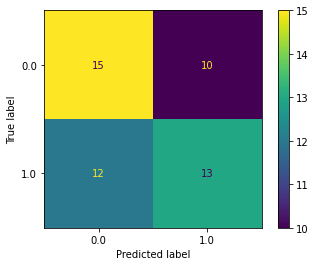

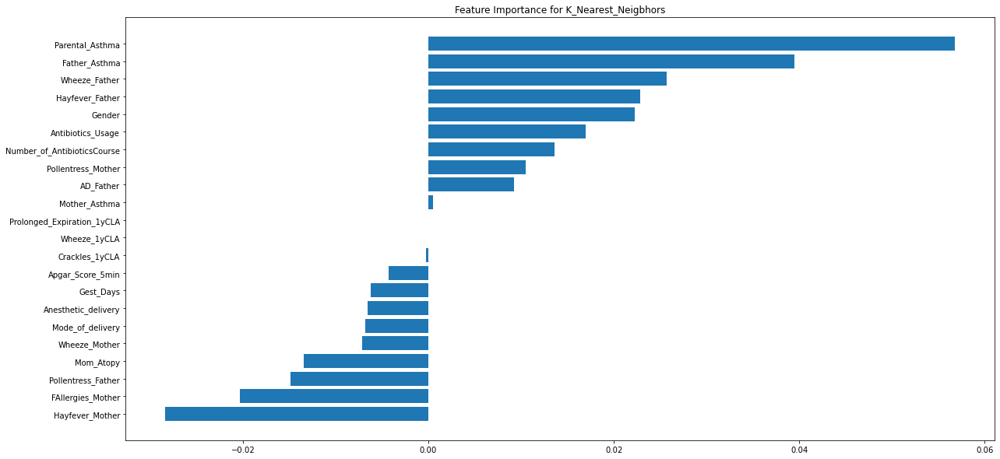

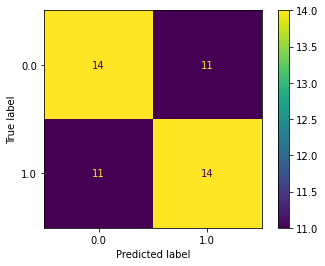

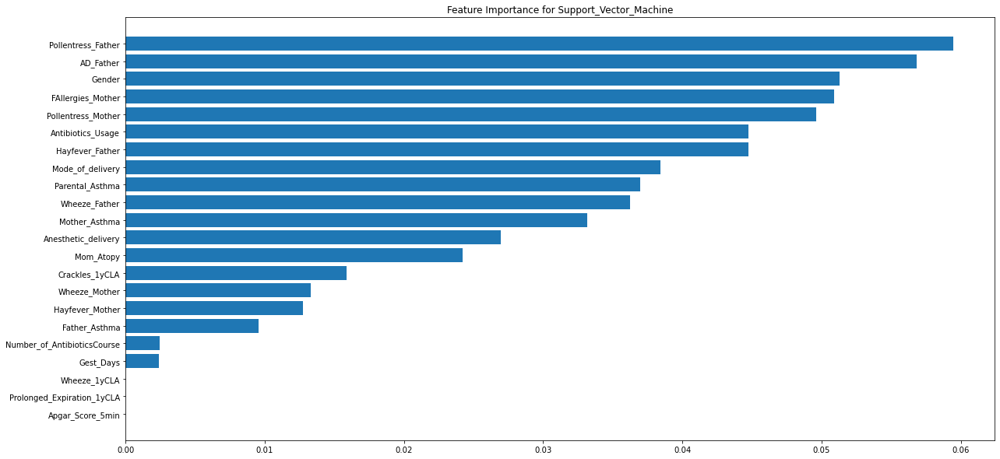

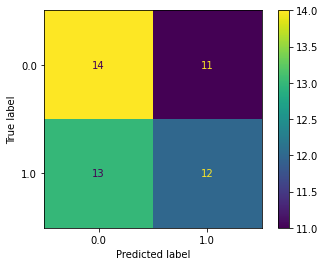

...

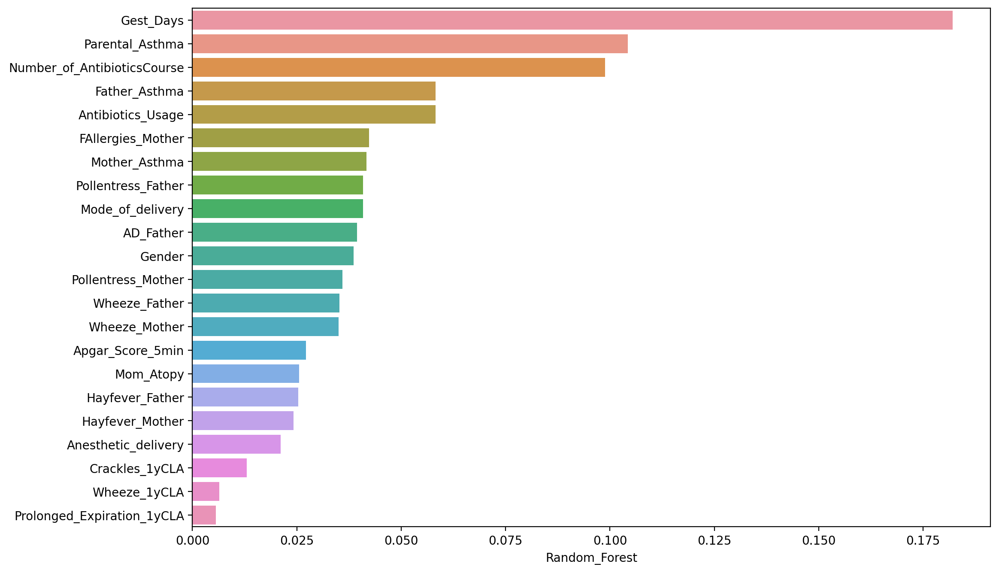

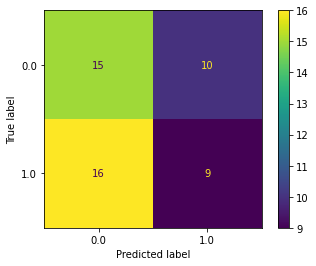

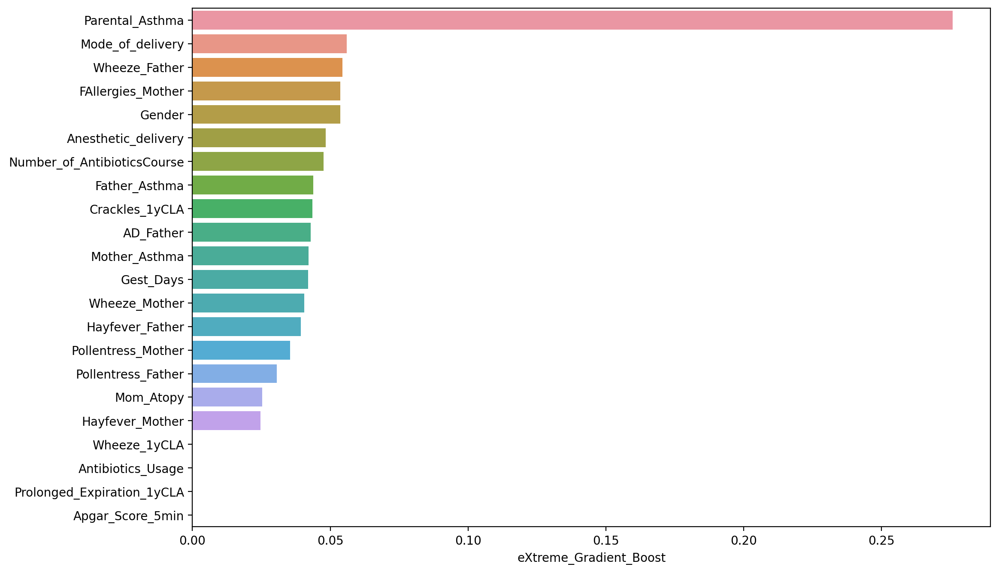

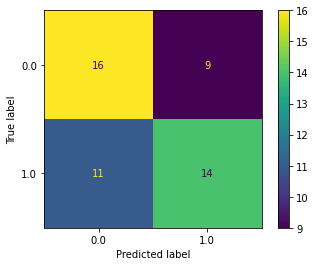

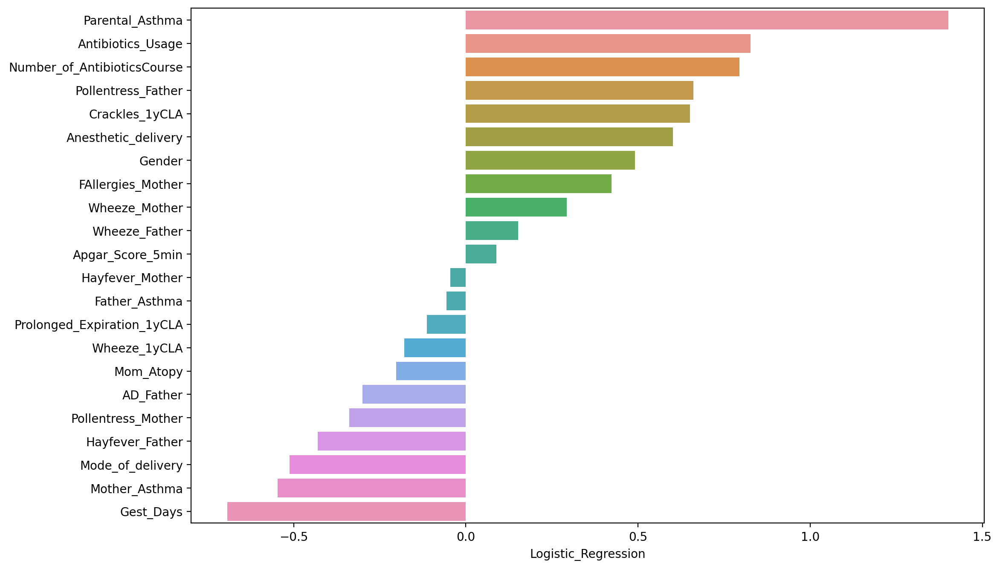

<IPython.core.display.Javascript object>

In [98]:
X_train, X_test, X_holdout, y_train, y_test, y_holdout = df_split(
    df=df_ml_baseline,
    balancing="Under",
    sampling_random_state=4,
    holdout_random_state=4,
    split_random_state=4,
)

ml_baseline_result_auc_444 = df_ml_run(
    X_train, X_test, y_train, y_test, scoring_func=roc_auc_score
)

ml_baseline_result_apr_444 = df_ml_run(
    X_train, X_test, y_train, y_test, scoring_func=average_precision_score
)

confussion matrix: [[18  7]
 [ 7 17]]

The performance score of K_Nearest_Neigbhors: 71.41666666666666 

              precision    recall  f1-score   support

           0       0.72      0.72      0.72        25
           1       0.71      0.71      0.71        24

    accuracy                           0.71        49
   macro avg       0.71      0.71      0.71        49
weighted avg       0.71      0.71      0.71        49

confussion matrix: [[20  5]
 [16  8]]

The performance score of Support_Vector_Machine: 56.666666666666664 

              precision    recall  f1-score   support

           0       0.56      0.80      0.66        25
           1       0.62      0.33      0.43        24

    accuracy                           0.57        49
   macro avg       0.59      0.57      0.54        49
weighted avg       0.58      0.57      0.55        49

confussion matrix: [[24  1]
 [17  7]]

The performance score of Naive_Bayes: 62.583333333333336 

              precision    recall 

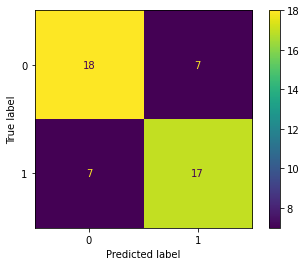

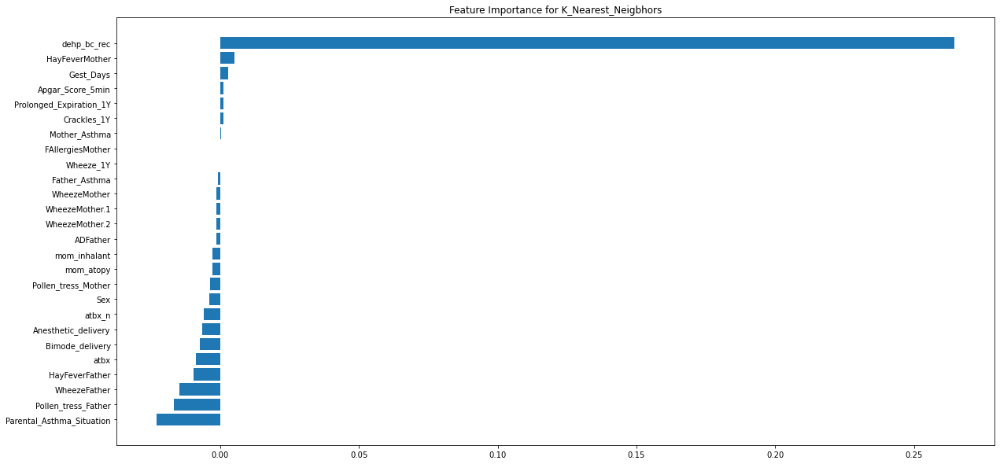

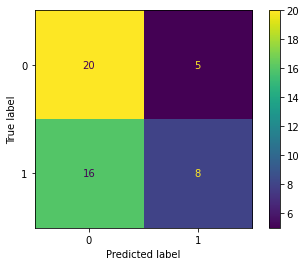

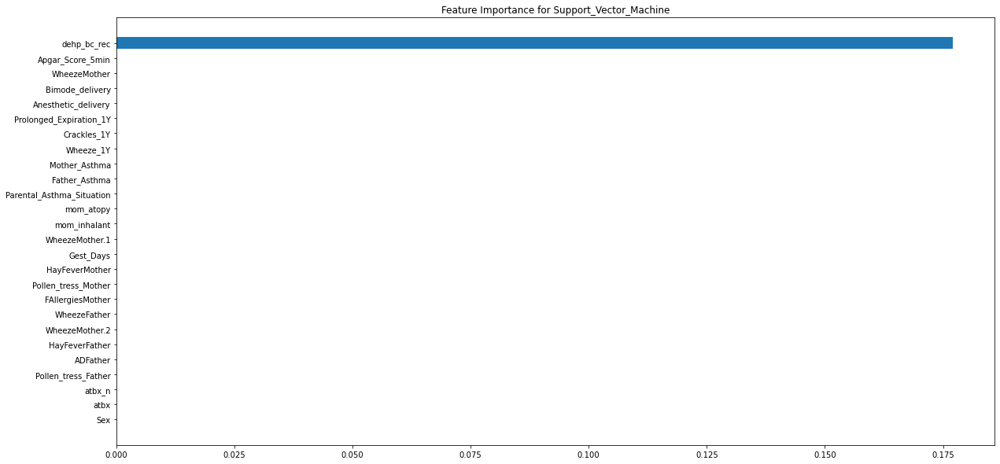

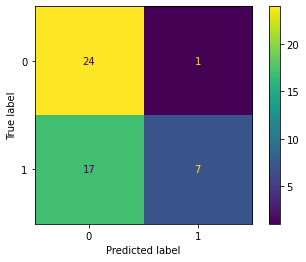

...

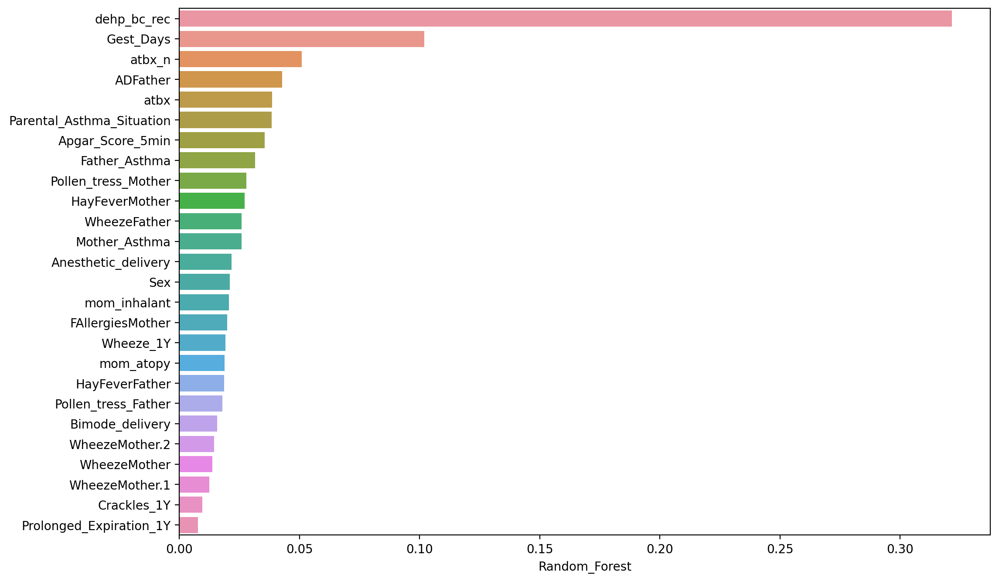

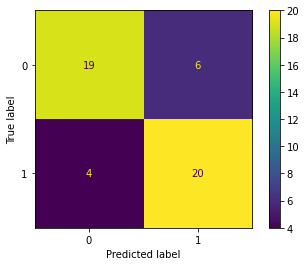

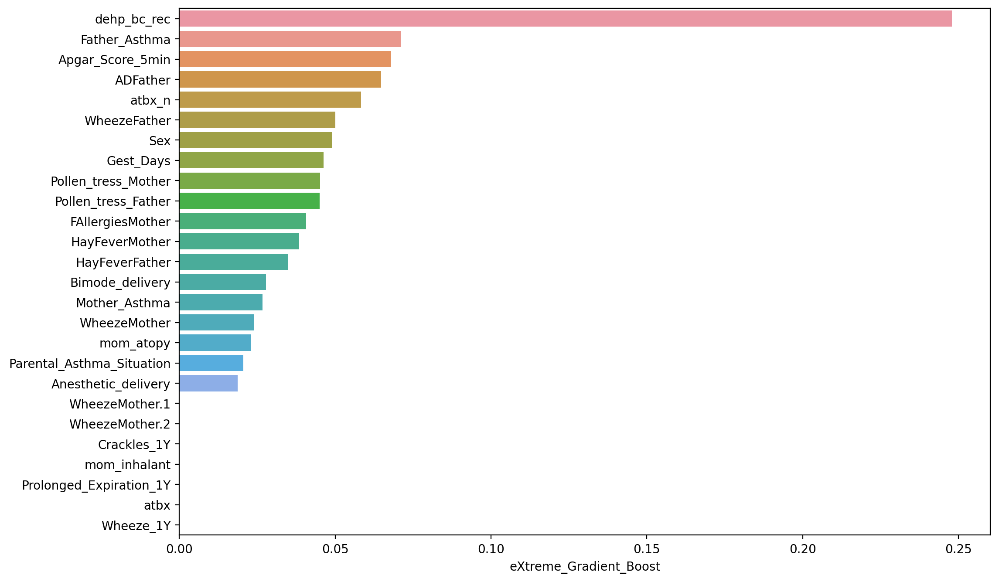

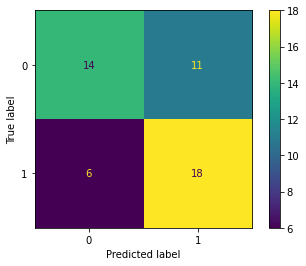

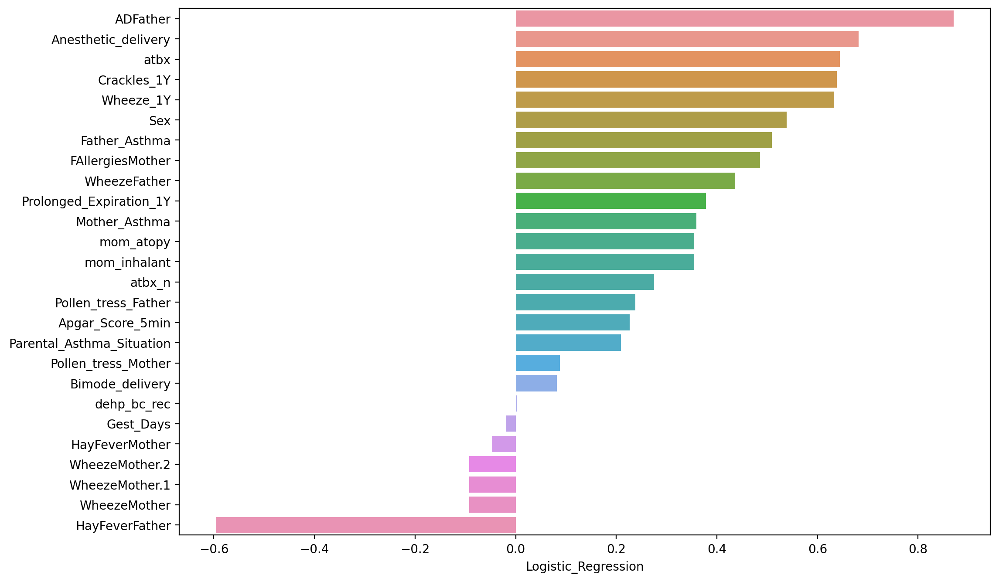

<IPython.core.display.Javascript object>

In [96]:
ml_baseline_result_auc_333 = df_ml_run(
    X_train, X_test, y_train, y_test, scoring_func=roc_auc_score
)

confussion matrix: [[17  8]
 [11 14]]

The performance score of K_Nearest_Neigbhors: 59.57446808510639 

              precision    recall  f1-score   support

         0.0       0.61      0.68      0.64        25
         1.0       0.64      0.56      0.60        25

    accuracy                           0.62        50
   macro avg       0.62      0.62      0.62        50
weighted avg       0.62      0.62      0.62        50

confussion matrix: [[17  8]
 [11 14]]

The performance score of Support_Vector_Machine: 59.57446808510639 

              precision    recall  f1-score   support

         0.0       0.61      0.68      0.64        25
         1.0       0.64      0.56      0.60        25

    accuracy                           0.62        50
   macro avg       0.62      0.62      0.62        50
weighted avg       0.62      0.62      0.62        50

confussion matrix: [[25  0]
 [21  4]]

The performance score of Naive_Bayes: 27.58620689655173 

              precision    recall  f

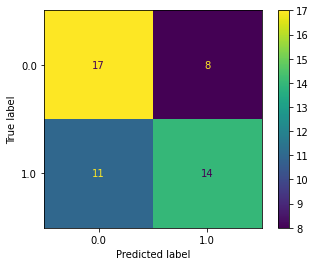

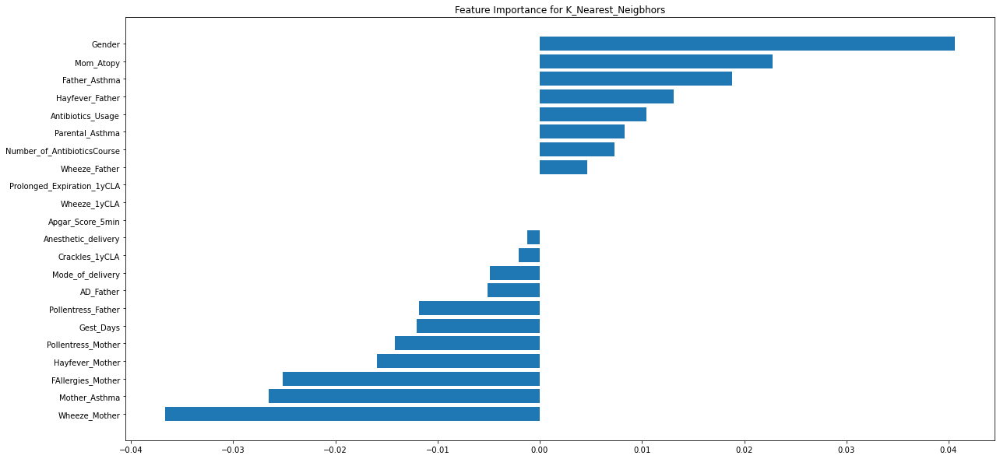

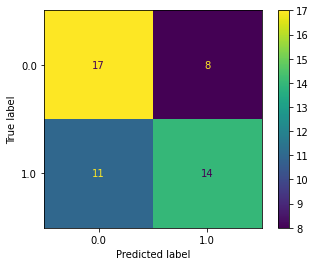

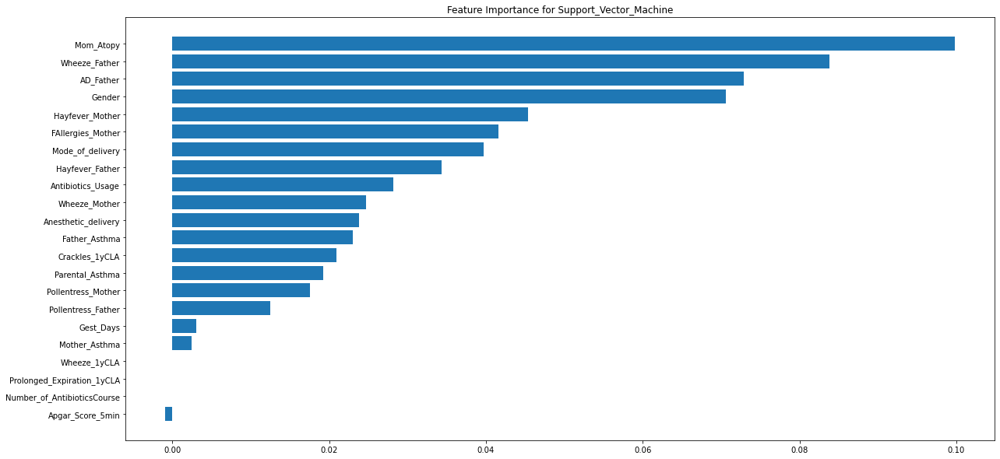

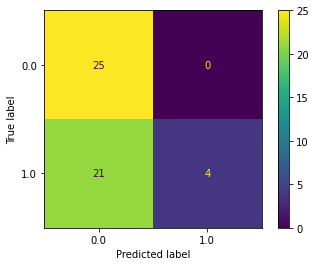

...

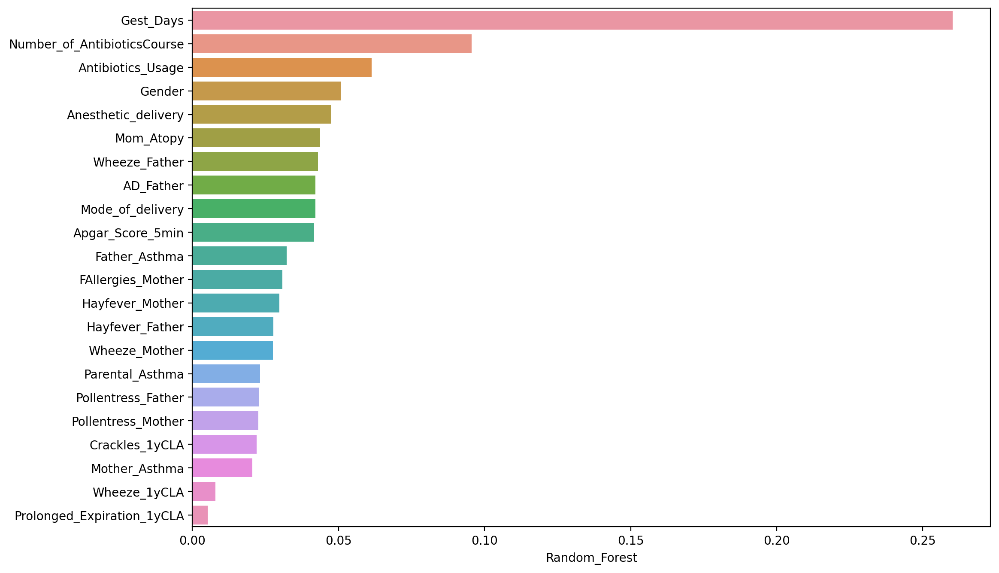

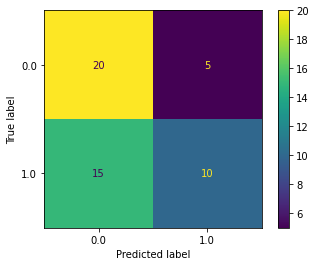

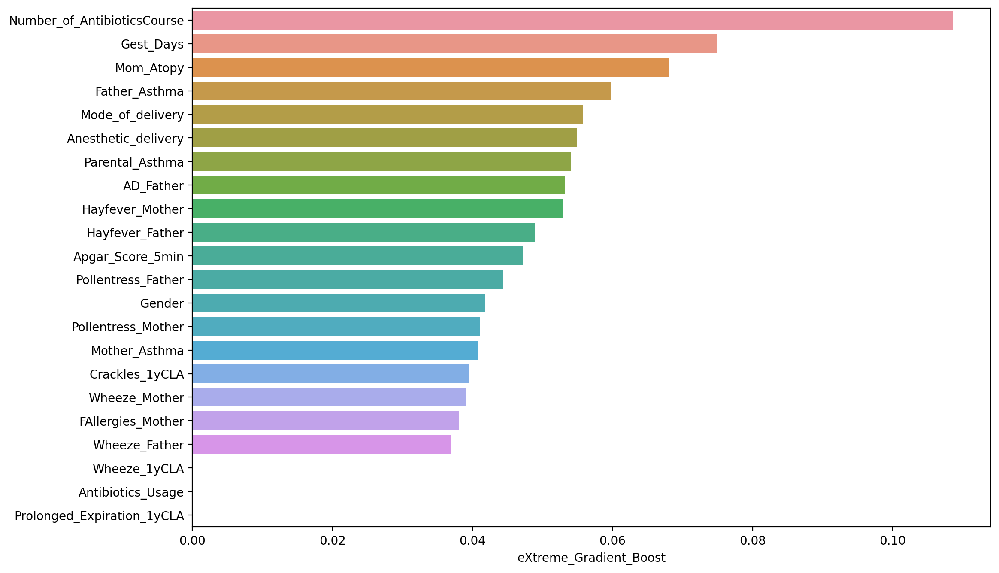

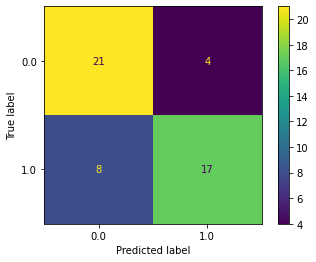

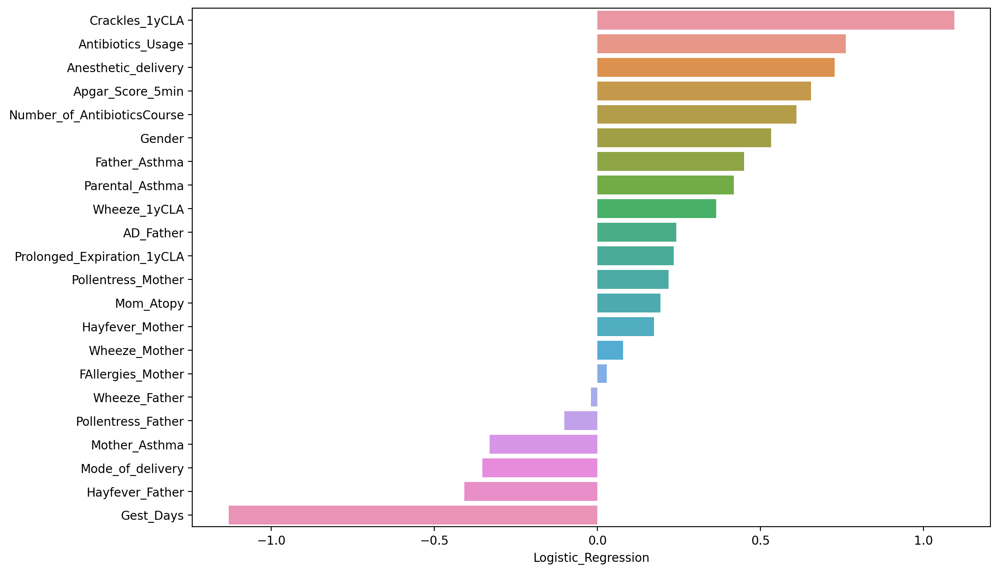

<IPython.core.display.Javascript object>

In [58]:
ml_baseline_result_333 = df_ml_run(X_train, X_test, y_train, y_test)

####  ML Pipeline

In [13]:
preprocessor.fit_transform(df_for_ml)
df_for_ml.rename(
    columns={"Prenatal_Mother_Condition": "Mother_Pregnancy_Condition"}, inplace=True
)
df_for_ml["Increse_weight_for_age"] = (
    df_for_ml.Weight_for_age_12m - df_for_ml.Weight_for_age_3m
)

The output columns will be: RIfrequency_earlier_report, RIseverity_earlier_report, RIfrequency_later_report, RIseverity_later_report
---------------------------------------------------------------------------------------------------
Given the correlation threshhold of 0.99, the columns that will be removed are:['Dad_Inhalant', 'Mom_Atopy']. Please see the following correlation:{'Dad_Inhalant <> Dad_Atopy': 1.0, 'Mom_Atopy <> Mom_Inhalant': 0.9981693591069318}
---------------------------------------------------------------------------------------------------
Given the correlation threshhold of 0.99, the columns that will be considered to be dropped are:['Dad_Inhalant', 'Mom_Atopy']. Please see the following correlation:{'Dad_Inhalant <> Dad_Atopy': 1.0, 'Mom_Atopy <> Mom_Inhalant': 0.9981693591069318}
---------------------------------------------------------------------------------------------------
Given the missingness threshhold of 0.2, the columns that will be considered to be dropp

<IPython.core.display.Javascript object>

In [14]:
df_for_ml_backup = df_for_ml.copy()

<IPython.core.display.Javascript object>

### Feature Engineering

In [16]:
df_for_ml = df_for_ml_backup.copy()
df_for_ml.shape
df_for_ml["Parental_asthma"] = df_for_ml["Father_Asthma"] + df_for_ml["Mother_Asthma"]
df_for_ml["Parental_ethnicity"] = (
    df_for_ml["Father_Caucasian"] + df_for_ml["Mother_Caucasian"]
)
df_for_ml["Parental_food"] = df_for_ml["Dad_Food"] + df_for_ml["Mom_Food"]
df_for_ml["Parental_wheeze"] = df_for_ml["Wheeze_Mother"] + df_for_ml["Wheeze_Father"]
df_for_ml["Parental_atopyinhalant"] = df_for_ml["Mom_Inhalant"] + df_for_ml["Dad_Atopy"]
df_for_ml["Parental_ad"] = df_for_ml["AD_Mother"] + df_for_ml["AD_Father"]
df_for_ml["Parental_pollentress"] = (
    df_for_ml["Pollentress_Mother"] + df_for_ml["Pollentress_Father"]
)
df_for_ml["Parental_hayfever"] = (
    df_for_ml["Hayfever_Mother"] + df_for_ml["Hayfever_Father"]
)
df_for_ml["Parental_fallergies"] = (
    df_for_ml["FAllergies_Mother"] + df_for_ml["FAllergies_Father"]
)
df_for_ml["Parental_smoke_prenatal"] = (
    df_for_ml["Smoke_Prenatal_Maternal"] + df_for_ml["Smoke_Prenatal_Secondhand"]
)

(2268, 149)

<IPython.core.display.Javascript object>

In [17]:
columns_to_drop = (
    set(df_for_ml.columns[df_for_ml.columns.str.contains("Missing")])
    | set(df_for_ml.columns[df_for_ml.columns.str.contains("Home_")])
    | set(df_for_ml.columns[df_for_ml.columns.str.contains("F10min")])
    | set(df_for_ml.columns[df_for_ml.columns.str.contains("Weight_")])
    | set(df_for_ml.columns[df_for_ml.columns.str.contains("^Prenatal_")])
    | set(df_for_ml.columns[df_for_ml.columns.str.contains("^CSED_")])
    | set(df_for_ml.columns[df_for_ml.columns.str.contains("later_report")])
    | set(df_for_ml.columns[df_for_ml.columns.str.contains("Study_Center")])
    | set(
        df_for_ml.columns[df_for_ml.columns.str.contains("BF_Status|Implied_Duration")]
    )
    | set(df_for_ml.columns[df_for_ml.columns.str.contains("Cumulative_|^Noncold_")])
    | set(df_for_ml.columns[df_for_ml.columns.str.contains("Asthma")])
    | set(df_for_ml.columns[df_for_ml.columns.str.contains("Caucas")])
    | set(
        df_for_ml.columns[
            df_for_ml.columns.str.contains(
                "Hayfever_|Pollentress_|AD_|Mom_|Dad_|Wheeze_Mother|Wheeze_Father|FAllergies_"
            )
        ]
    )
    | set(df_for_ml.columns[df_for_ml.columns.str.contains("Usage")])
    | set(df_for_ml.columns[df_for_ml.columns.str.contains("^Wheeze_")])
    | set(df_for_ml.columns[df_for_ml.columns.str.contains("^Smoke_")])
)

len(columns_to_drop)

df_refined = df_for_ml.drop(columns=columns_to_drop)
df_refined_backup = df_refined.copy()

105

<IPython.core.display.Javascript object>

In [18]:
df_refined = df_refined_backup.copy()
df_refined.shape
df_refined.columns

(2268, 54)

Index(['Complications_Birth', 'Crackles_1yCLA', 'Gest_Days', 'BF_3m',
       'Epi_Noncold_Wheeze_1y', 'Prolonged_Expiration_1yCLA',
       'No_of_Pregnancy', 'Number_of_AntibioticsCourse', 'BF_6m',
       'Stay_Duration_Hospital', 'Recurrent_Wheeze_1y', 'BF_12m',
       'Anesthetic_delivery', 'Jaundice_Birth', 'Mother_Pregnancy_Condition',
       'First_10min_Measure', 'y', 'Epi_Noncold_Wheeze_3m',
       'Epi_Noncold_Wheeze_6m', 'Analgesics_usage_delivery',
       'Respiratory_Problems_Birth', 'RIfrequency_earlier_report',
       'RIseverity_earlier_report', 'Gender_M',
       'Apgar_Score_5min_Below_Normal', 'Apgar_Score_5min_Critical_Low',
       'Apgar_Score_5min_Normal', 'PSS_36week_High_Stress',
       'PSS_36week_Low_Stress', 'PSS_36week_Moderate_Stress',
       'Apgar_Score_1min_Below_Normal', 'Apgar_Score_1min_Critical_Low',
       'Apgar_Score_1min_Normal', 'Mode_of_delivery_Vaginal',
       'PSS_18week_High_Stress', 'PSS_18week_Low_Stress',
       'PSS_18week_Moderate_Stress

<IPython.core.display.Javascript object>

In [19]:
view_y_proportions(df_refined, df_refined.columns)

The proportion of definite asthma outcome for general cohorts is 6.7%


,Asthma_Proportion_over_thresh,Asthma_Outcome_over_thresh,Total_Number_over_thresh,Thresh
y,100.00,152.0,152.0,0.0
Epi_Noncold_Wheeze_6m,22.50,9.0,40.0,0.0
Epi_Noncold_Wheeze_1y,20.51,8.0,39.0,0.0
Prolonged_Expiration_1yCLA,20.00,2.0,10.0,0.0
Recurrent_Wheeze_1y,16.96,29.0,171.0,0.0
PSS_18week_High_Stress,16.00,8.0,50.0,0.0
Epi_Noncold_Wheeze_3m,14.29,13.0,91.0,0.0
Crackles_1yCLA,13.33,6.0,45.0,0.0
Number_of_AntibioticsCourse,12.47,49.0,393.0,0.0
PSS_36week_High_Stress,12.20,5.0,41.0,0.0


<IPython.core.display.Javascript object>

In [20]:
a, b, c, d = grouped_feature_generator(df_refined)
c

------------------------------------------------------
The available grouped feature can be one of: 
 dict_keys(['1_weight', '2_mother_condition', '3_first10min', '4_breastfeeding', '5_home', '6_mental', '7_parental', '8_smoke', '9_wheeze', '10_resp', '11_antibiotic', '1_11', '12_misc', '13_remainder'])
------------------------------------------------------
The available time-points for features can be one of: 
 dict_keys(['3m', '6m', '12m', '18m', '24m', '36m', '48m', '60m', '1_9m_2hy', 'after_birth', 'at_birth'])
------------------------------------------------------
Note: Target variable can be one of: 
 {'Wheeze_Traj_Type', 'Medicine_for_Wheeze_5yCLA', 'Viral_Asthma_3yCLA', 'Recurrent_Wheeze_1y', 'Viral_Asthma_5yCLA', 'Triggered_Asthma_3yCLA', 'Recurrent_Wheeze_3y', 'Recurrent_Wheeze_5y', 'Asthma_Diagnosis_3yCLA', 'Asthma_Diagnosis_5yCLA', 'Triggered_Asthma_5yCLA'}
------------------------------------------------------


,Features
Type,
1_weight,{}
2_mother_condition,{}
3_first10min,{First_10min_Measure}
4_breastfeeding,"{BF_6m, BF_3m, BF_12m}"
5_home,{}
6_mental,"{PSS_36week_High_Stress, PSS_18week_Moderate_Stress, PSS_12m_High_Stress, PSS_6m_High_Stress, PSS_12m_Moderate_Stress, PSS_6m_Moderate_Stress, PSS_18week_Low_Stress, PSS_6m_Low_Stress, PSS_12m_Low..."
7_parental,"{Parental_atopyinhalant, Parental_fallergies, Parental_pollentress, Parental_asthma, Parental_hayfever, Mother_Pregnancy_Condition, Parental_food, Parental_smoke_prenatal, Parental_wheeze, Parenta..."
8_smoke,{}
9_wheeze,"{Recurrent_Wheeze_1y, Epi_Noncold_Wheeze_6m, Epi_Noncold_Wheeze_3m, Epi_Noncold_Wheeze_1y}"


<IPython.core.display.Javascript object>

### Scaling

In [21]:
X = df_refined.drop(columns="y")
y = df_refined.y
X = pd.DataFrame(MinMaxScaler().fit_transform(X), columns=X.columns, index=X.index)
df_refined_scaled = pd.concat([X, y], axis=1)

X = df_refined_scaled.drop(columns=["y"])
y = df_refined_scaled.y

df_refined_scaled_backup = df_refined_scaled.copy()

<IPython.core.display.Javascript object>

In [35]:
view_y_proportions(df_refined_scaled, df_refined.columns, 0)

The proportion of definite asthma outcome for general cohorts is 6.7%


,Asthma_Proportion_over_thresh,Asthma_Outcome_over_thresh,Total_Number_over_thresh,Thresh
y,100.00,152.0,152.0,0.0
Epi_Noncold_Wheeze_6m,22.50,9.0,40.0,0.0
Epi_Noncold_Wheeze_1y,20.51,8.0,39.0,0.0
Prolonged_Expiration_1yCLA,20.00,2.0,10.0,0.0
Recurrent_Wheeze_1y,16.96,29.0,171.0,0.0
PSS_18week_High_Stress,16.00,8.0,50.0,0.0
Epi_Noncold_Wheeze_3m,14.29,13.0,91.0,0.0
Crackles_1yCLA,13.33,6.0,45.0,0.0
Number_of_AntibioticsCourse,12.47,49.0,393.0,0.0
PSS_36week_High_Stress,12.20,5.0,41.0,0.0


<IPython.core.display.Javascript object>

In [23]:
# Preprocessing
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder

# Feature selection
from sklearn.feature_selection import (
    SelectPercentile,
    SelectKBest,
    SelectFwe,
    SelectFpr,
    SelectFromModel,
    chi2,
    mutual_info_classif,
    f_classif,
    SequentialFeatureSelector,
    RFECV,
)
from sklearn.inspection import permutation_importance

# Imbalance Learn
from imblearn.over_sampling import RandomOverSampler

# Models
from sklearn.linear_model import LogisticRegression, Lasso, LassoLarsCV, LassoCV
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC

# Ensemble
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier

# Model Metrics, Parameters, Evaluation
from sklearn.model_selection import (
    StratifiedKFold,
    GridSearchCV,
    cross_val_score,
    train_test_split,
)


from sklearn.metrics import (
    confusion_matrix,
    accuracy_score,
    roc_curve,
    classification_report,
    f1_score,
    precision_score,
    recall_score,
    roc_auc_score,
    plot_confusion_matrix,
)

# Pipeline
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline, make_pipeline, FeatureUnion


# Visualization
import matplotlib.pyplot as plt
import seaborn as sns

<IPython.core.display.Javascript object>

In [24]:
# Restore df_refined
df_refined_scaled = df_refined_scaled_backup.copy()

<IPython.core.display.Javascript object>

### Splitting

In [25]:
X_train, X_test, X_holdout, y_train, y_test, y_holdout = df_split(
    df_refined_scaled,
    balancing="None",
    holdout_ratio=0.005,
    sampling_random_state=1,
    holdout_random_state=1,
    split_random_state=1,
    split_ratio=0.225,
    remove_duplicates=False,
)

The number of repeated (redundant) samples in the holdout dataset given your selection of features for modelling are 12 - 12
The number of repeated (redundant) samples in the train, test/eval dataset (rest) given your selection of features for modelling are 2256 - 2256
You can drop duplicates with 'remove_duplicates=True' parameter


<IPython.core.display.Javascript object>

In [26]:
# X_train
y_train.head(5)
y_train.value_counts(normalize=False)
# X_test
y_test.head(5)
y_test.value_counts(normalize=False)
# X_holdout
y_holdout.head(5)
y_holdout.value_counts(normalize=False)

Subject_Number
20663    0.0
41039    0.0
40392    0.0
30415    0.0
20774    0.0
Name: y, dtype: float64

0.0    1631
1.0     117
Name: y, dtype: int64

Subject_Number
40172    0.0
20309    0.0
20405    0.0
50351    0.0
20683    0.0
Name: y, dtype: float64

0.0    474
1.0     34
Name: y, dtype: int64

Subject_Number
40255    0.0
40202    0.0
30746    0.0
40404    0.0
20258    0.0
Name: y, dtype: float64

0.0    11
1.0     1
Name: y, dtype: int64

<IPython.core.display.Javascript object>

In [27]:
df_refined_scaled.shape

(2268, 54)

<IPython.core.display.Javascript object>

### Modelling

In [ ]:
def df_ml_run(
    X_train, X_test, y_train, y_test, scoring_func=f1_score, importance_scoring="f1"
):
    """
    Fast run of a myriad of models and return three very informative dataframes (confusion matrix dataframe,  model performance dataframe
    and colored feature importance dataframe) and one decision tree for visualization

    :param scoring_func: a predefined function, default: f1_score
        model_scoring has to be one of accuracy_score, f1_score, precision_score, recall_score, roc_auc_score
        since it must have the same name of sklearn.metrics functions

    :param importance_scoring: string, default: f1
        importance_scoring has to be one of 'accuracy', 'f1', 'precision', 'recall', 'roc_auc',
        since it must be recognizable as a parameter to be put into permutation importance

    :return: Confusion matrix dataframe, model performance, feature importance

    ------------------------
    Examples:
    ml_result_tuple = df_ml_run(X_train, X_test, y_train, y_test)
    """
    # A dictionary that will store the performance score of models to evaluate feature importance
    model_score = {}

    # A dictionary that will store the confusion matrix results as string to easy comparision
    model_cm = {}

    # A dictionary that will store the feature importance for different models
    model_feature = {}

    # Initializing the model using desired abbreviated names as model instance to train and test
    xgb = XGBClassifier(learning_rate=0.01, n_estimators=100)
    dt = DecisionTreeClassifier(criterion="entropy", random_state=0, max_depth=6)
    rf = RandomForestClassifier(n_estimators=100, random_state=0, max_depth=5)
    knn = KNeighborsClassifier(n_neighbors=5)
    svc = SVC(kernel="rbf", C=6)
    nb = GaussianNB()
    lr = LogisticRegression()

    # A dictionary that stores the full name of model
    model_name = {
        "knn": "K_Nearest_Neigbhors",
        "xgb": "eXtreme_Gradient_Boost",
        "svc": "Support_Vector_Machine",
        "dt": "Decision_Tree",
        "rf": "Random_Forest",
        "nb": "Naive_Bayes",
        "lr": "Logistic_Regression",
    }

    permutation_importance_list = [(knn, "knn"), (svc, "svc"), (nb, "nb")]
    feature_importance_list = [(dt, "dt"), (rf, "rf"), (xgb, "xgb")]
    coefficient_list = [(lr, "lr")]

    model_list = (
        permutation_importance_list + feature_importance_list + coefficient_list
    )

    # 1. Search for most effective predictive models and relevant feature importance
    for model, key in model_list:

        # Train and predict
        model.fit(X_train, y_train)
        predicted = model.predict(X_test)

        # Store result
        model_score[key] = scoring_func(y_test, predicted)
        model_cm[key] = str(
            {
                k: dict(v)
                for k, v in dict(
                    pd.DataFrame(
                        confusion_matrix(y_test, predicted),
                        columns=["Pr0", "Pr1"],
                        index=["Tr0", "Tr1"],
                    )
                ).items()
            }
        )
        # Display model result
        print(f"confussion matrix: {confusion_matrix(y_test, predicted)}\n")
        plot_confusion_matrix(model, X_test, y_test)
        print(
            f"The performance score of {model_name[key]}: {model_score[key] * 100} \n"
        )
        print(classification_report(y_test, predicted))

        # Permutation importance
        if (model, key) in permutation_importance_list:

            # Evaluating Feature importance
            permutation_result = permutation_importance(
                model,
                X_train,
                y_train,
                n_repeats=10,
                random_state=1012,
                scoring=importance_scoring,
            )

            # Storing feature importance
            model_feature[key] = permutation_result.importances_mean.reshape(1, -1)[0]

            # Visualization of feature importance for permutation importance
            perm_sorted_idx = permutation_result.importances_mean.argsort()
            plt.figure(figsize=(20, 10))
            plt.title("Feature Importance for {}".format(model_name[key]))
            plt.barh(
                width=permutation_result.importances_mean[perm_sorted_idx].T,
                y=X_train.columns[perm_sorted_idx],
            )
        # Feature Importance for tree-based models:
        elif (model, key) in feature_importance_list:

            # Storing feature importance
            model_feature[key] = model.feature_importances_.reshape(1, -1)[0]

            # Plot visualization of feature importance for tree-based models
            imp_features = pd.DataFrame(
                data=model.feature_importances_,
                index=X_test.columns,
                columns=[model_name[key]],
            )
            imp_features.sort_values(model_name[key], ascending=False, inplace=True)
            plt.figure(figsize=(12, 8), dpi=200)
            sns.barplot(
                data=imp_features,
                y=imp_features.index,
                x=imp_features[model_name[key]],
            )

        # Feature importance for linear-based models:
        elif (model, key) in coefficient_list:

            # Storing feature importance
            model_feature[key] = model.coef_.reshape(1, -1)[0]

            # Plot visualization of feature importance for linear models
            imp_features = pd.DataFrame(
                data=model.coef_.reshape(1, -1)[0],
                index=X_test.columns,
                columns=[model_name[key]],
            )
            imp_features.sort_values(model_name[key], ascending=False, inplace=True)
            plt.figure(figsize=(12, 8), dpi=200)
            sns.barplot(
                data=imp_features,
                y=imp_features.index,
                x=imp_features[model_name[key]],
            )
        else:
            print(
                "{} is not found in the model_list, please check".format((model, key))
            )

    # 2. Put all metrics together for different models
    score_dict = defaultdict(list)
    models = [lr, nb, rf, knn, dt, svc, xgb]
    models_label = [
        "Logistic Regression",
        "Naive Bayes",
        "Random Forest",
        "K-Nearest Neighbours",
        "Decision Tree",
        "Support Vector Machine",
        "Extreme Gradient Boost",
    ]
    measurements = [
        accuracy_score,
        f1_score,
        precision_score,
        recall_score,
        roc_auc_score,
    ]
    measurement_names = ["Accuracy", "F1 score", "Precision", "Recall", "AUC"]
    for i in range(len(models)):
        score_dict["Model"].append(models_label[i])
        for j in range(len(measurements)):
            score_dict[measurement_names[j]].append(
                measurements[j](y_test, models[i].predict(X_test))
            )
    score_df = pd.DataFrame(score_dict).set_index("Model")

    #    model_score_returned = score_df.style.background_gradient(cmap="Greens")
    model_score_returned = score_df
    # 3. Create feature importance table for various predictors

    # Prepare naming of models
    col_name = []
    for i in model_feature.keys():
        col_name.append(model_name[i])

    # Convert feature importances dictionary into dataframe, and tranpose to view feature importance on rows
    feature_res = pd.DataFrame(
        data=model_feature.values(), columns=X_test.columns, index=model_feature.keys()
    ).T

    # Standardize the columns while retaining signs of coefficients using dividing maximal value
    for col in feature_res.columns:
        feature_res[col] = feature_res[col] / feature_res[col].max()

    # Calculate weighted feature importance using a myriad of models based on their performance
    weighted_feature = sum(
        [feature_res[col].values * score for col, score in list(model_score.items())]
    )

    # Standardize the weighted_importance column
    feature_res["Weighted_Importance"] = weighted_feature / np.max(weighted_feature)
    col_name.append("Weighted_Importance")

    # Renaming the columns to the model's full name
    feature_res.columns = col_name
    #    feature_res_returned = feature_res.style.background_gradient(cmap="Greens")
    feature_res_returned = feature_res

    # 4. View the confusion matrix for details
    model_cm_df = pd.DataFrame(model_cm, index=["Confusion_Matrix_Summary"]).T

    # Add two more columns for easy observation
    model_cm_df["Pred_0"] = model_cm_df.Confusion_Matrix_Summary.apply(
        lambda x: eval(x)["Pr0"]
    )
    model_cm_df["Pred_1"] = model_cm_df.Confusion_Matrix_Summary.apply(
        lambda x: eval(x)["Pr1"]
    )

    index_name = []
    for i in model_cm_df.index:
        index_name.append(model_name[i])
    model_cm_df.index = index_name

    return model_score_returned, feature_res_returned, model_cm_df, dt

In [28]:
X_train_backup = X_train.copy()
y_train_backup = y_train.copy()

<IPython.core.display.Javascript object>

In [29]:
# Restore
X_train = X_train_backup.copy()
y_train = y_train_backup.copy()
y_train.value_counts()

0.0    1631
1.0     117
Name: y, dtype: int64

<IPython.core.display.Javascript object>

#### Modelling without resampling

confussion matrix: [[474   0]
 [ 34   0]]

The performance score of K_Nearest_Neigbhors: 0.0 

              precision    recall  f1-score   support

         0.0       0.93      1.00      0.97       474
         1.0       0.00      0.00      0.00        34

    accuracy                           0.93       508
   macro avg       0.47      0.50      0.48       508
weighted avg       0.87      0.93      0.90       508

confussion matrix: [[470   4]
 [ 33   1]]

The performance score of Support_Vector_Machine: 5.128205128205128 

              precision    recall  f1-score   support

         0.0       0.93      0.99      0.96       474
         1.0       0.20      0.03      0.05        34

    accuracy                           0.93       508
   macro avg       0.57      0.51      0.51       508
weighted avg       0.89      0.93      0.90       508

confussion matrix: [[ 14 460]
 [  3  31]]

The performance score of Naive_Bayes: 11.80952380952381 

              precision    recall  f1-

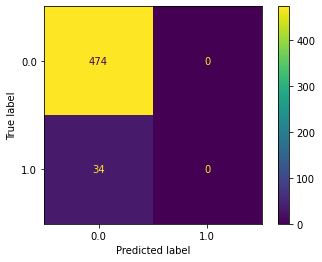

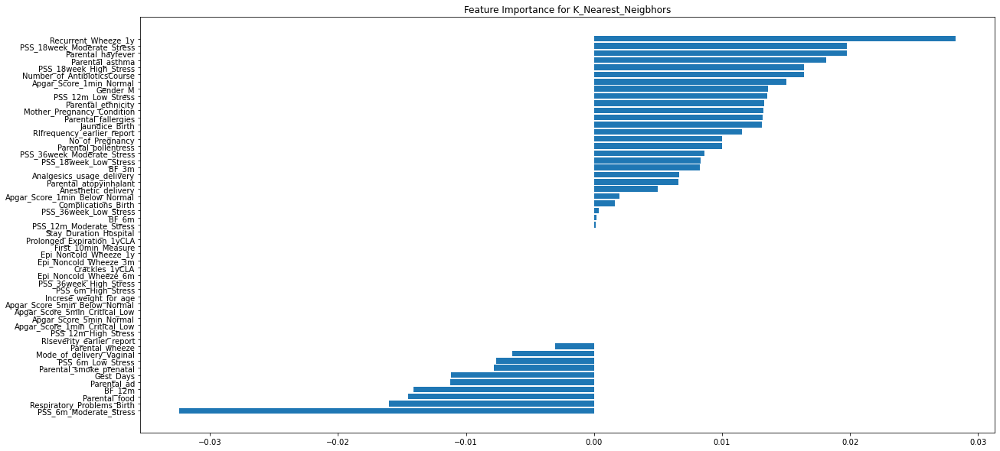

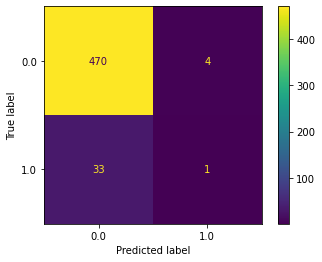

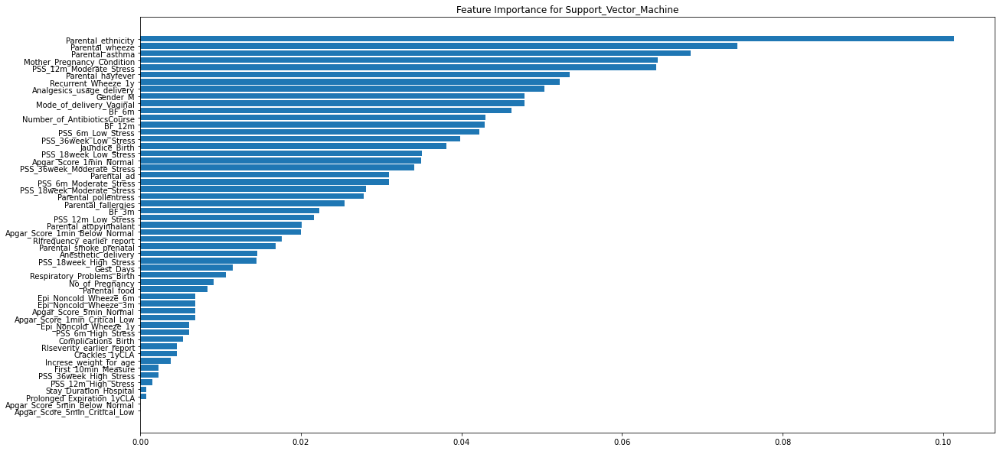

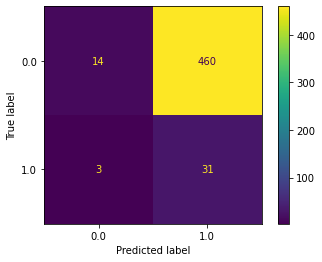

...

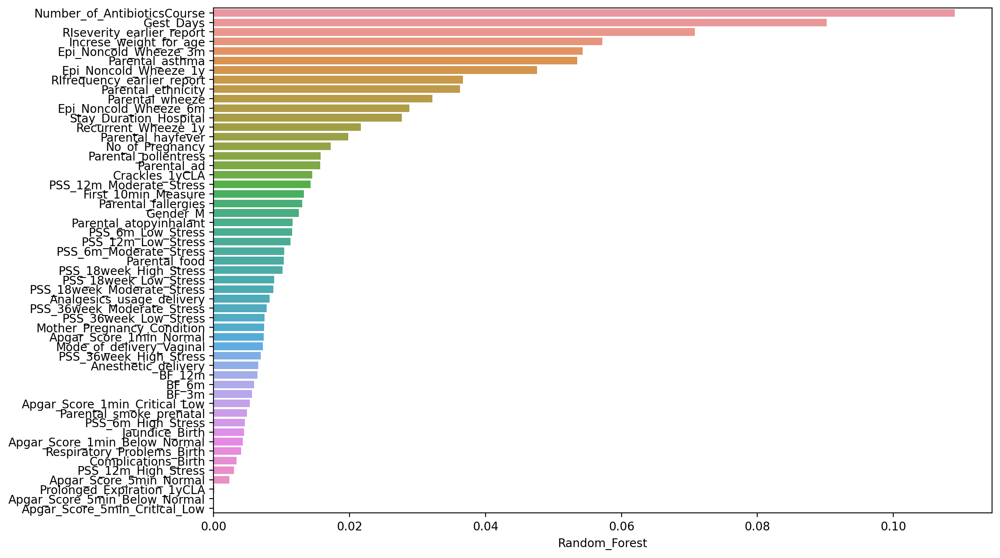

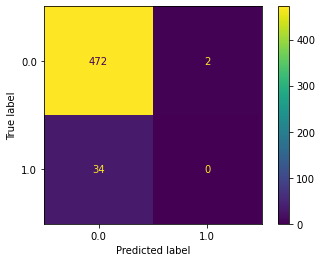

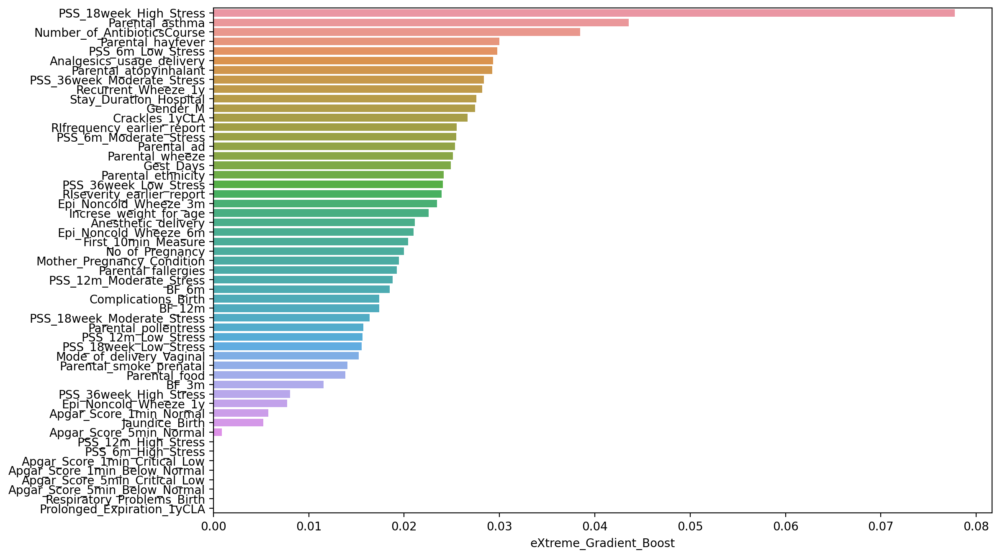

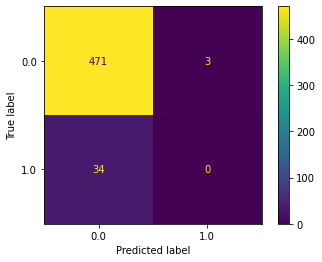

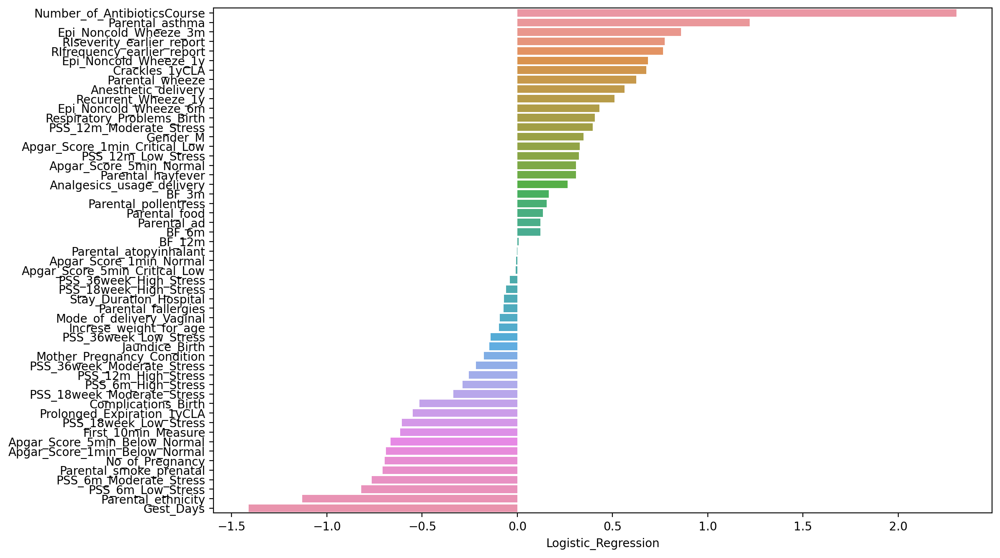

<IPython.core.display.Javascript object>

In [30]:
ml_result_tuple = df_ml_run(X_train, X_test, y_train, y_test)

#### Undersampling 

(1) RandomUnderSampler is a fast and easy way to balance the data by randomly selecting a subset of data for the targeted classes:

0.0    117
1.0    117
Name: y, dtype: int64

confussion matrix: [[292 182]
 [ 20  14]]

The performance score of K_Nearest_Neigbhors: 12.17391304347826 

              precision    recall  f1-score   support

         0.0       0.94      0.62      0.74       474
         1.0       0.07      0.41      0.12        34

    accuracy                           0.60       508
   macro avg       0.50      0.51      0.43       508
weighted avg       0.88      0.60      0.70       508

confussion matrix: [[288 186]
 [ 18  16]]

The performance score of Support_Vector_Machine: 13.559322033898308 

              precision    recall  f1-score   support

         0.0       0.94      0.61      0.74       474
         1.0       0.08      0.47      0.14        34

    accuracy                           0.60       508
   macro avg       0.51      0.54      0.44       508
weighted avg       0.88      0.60      0.70       508

confussion matrix: [[ 23 451]
 [  4  30]]

The performance score of Naive_Bayes: 11.650485436893204 

              precisio

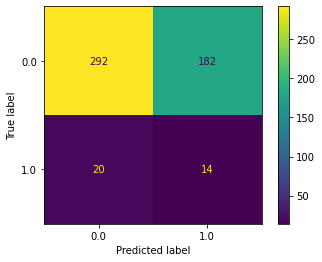

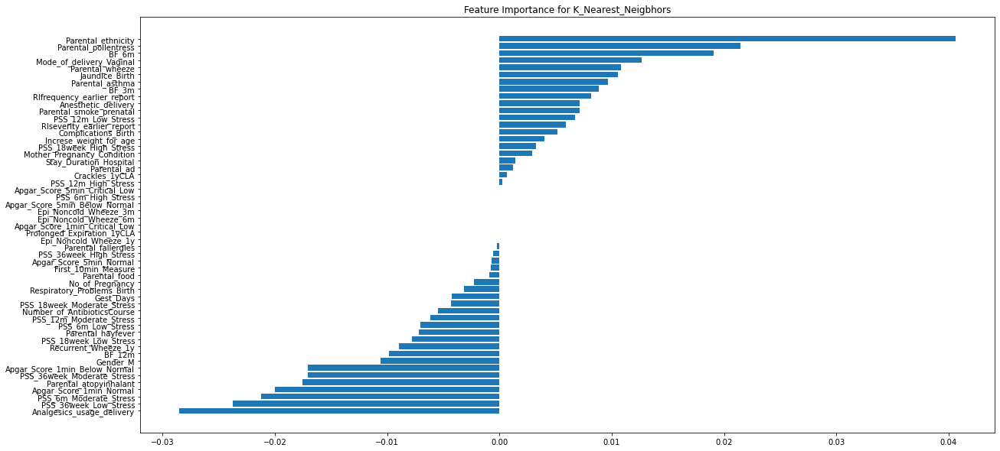

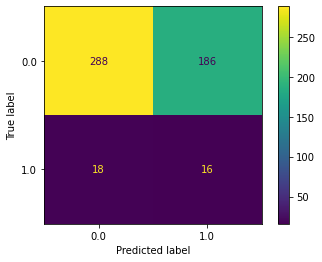

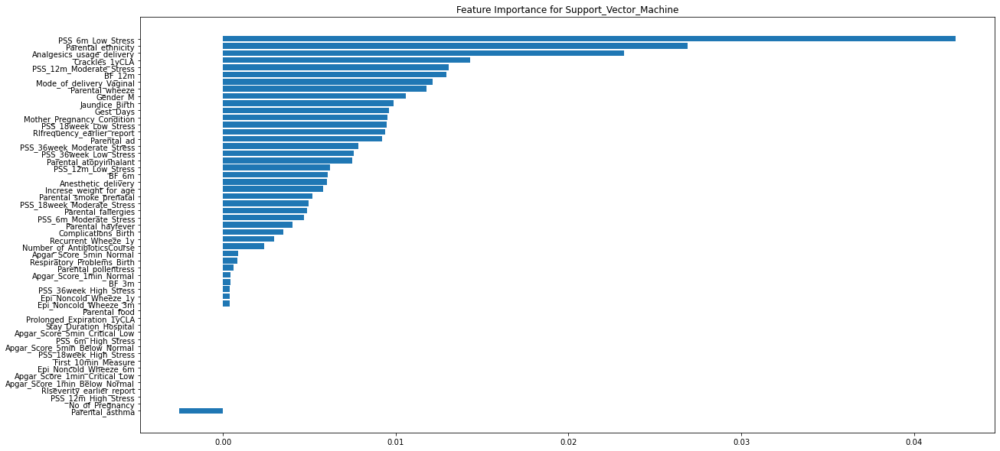

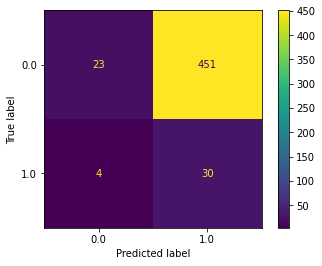

...

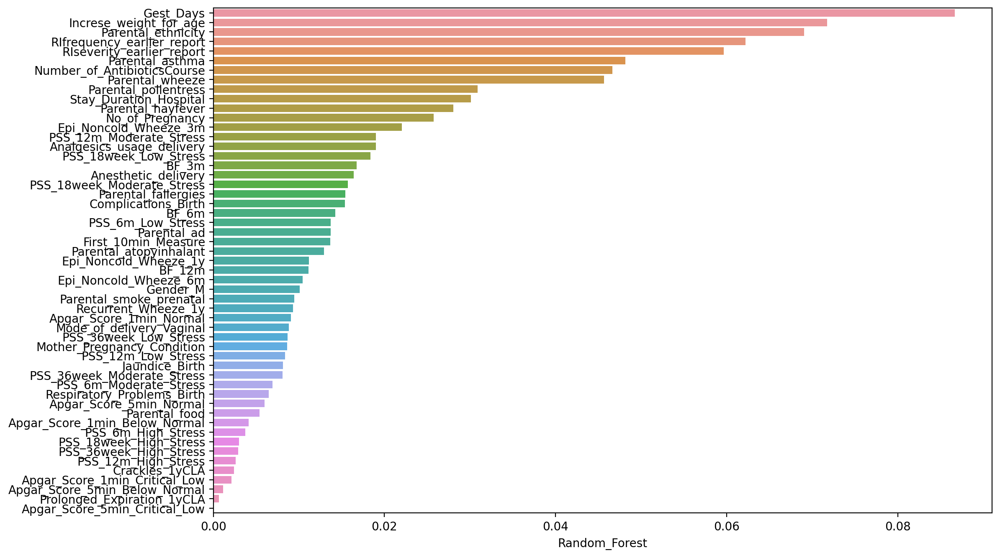

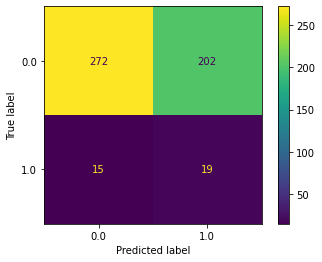

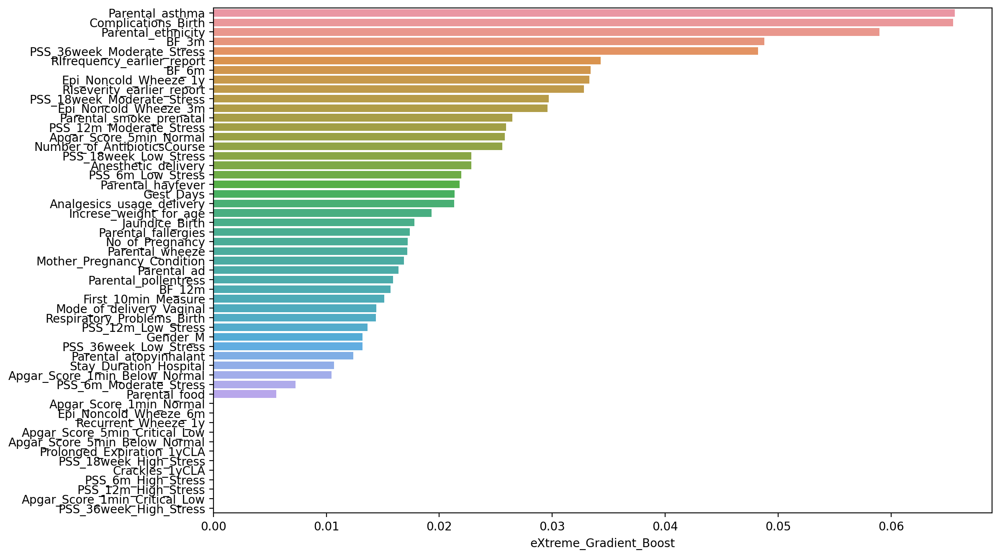

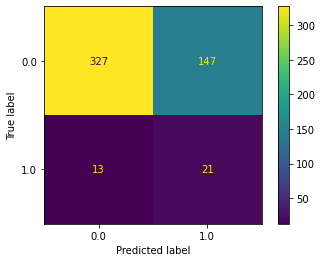

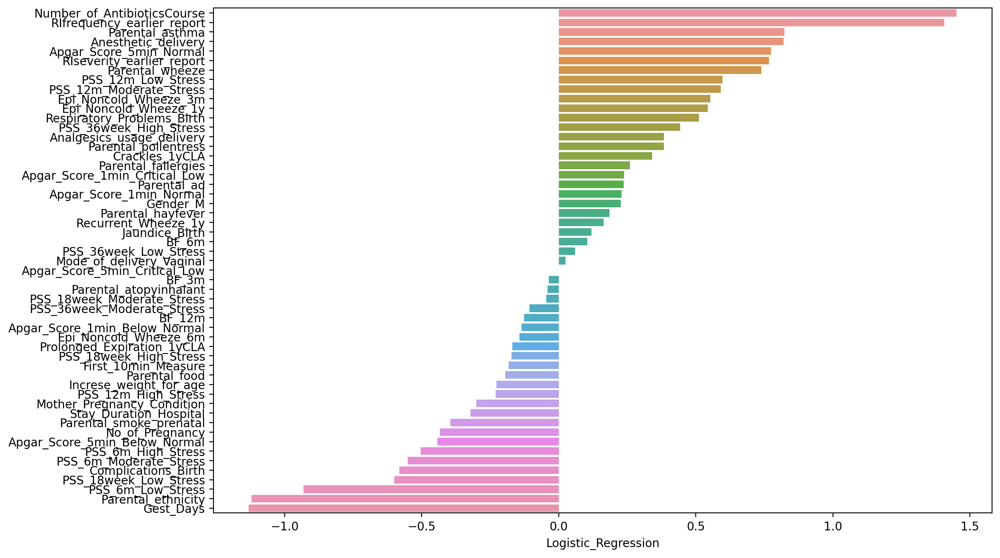

<IPython.core.display.Javascript object>

In [31]:
rus = RandomUnderSampler(random_state=0)
X_train_under, y_train_under = rus.fit_resample(X_train, y_train)
y_train_under.value_counts()
ml_result_tuple_rus = df_ml_run(X_train_under, X_test, y_train_under, y_test)

(2) ClusterCentroids makes use of K-means to reduce the number of samples. Therefore, each class will be synthesized with the centroids of the K-means method instead of the original samples:

0.0    117
1.0    117
Name: y, dtype: int64

confussion matrix: [[469   5]
 [ 33   1]]

The performance score of K_Nearest_Neigbhors: 5.0 

              precision    recall  f1-score   support

         0.0       0.93      0.99      0.96       474
         1.0       0.17      0.03      0.05        34

    accuracy                           0.93       508
   macro avg       0.55      0.51      0.51       508
weighted avg       0.88      0.93      0.90       508

confussion matrix: [[ 33 441]
 [  1  33]]

The performance score of Support_Vector_Machine: 12.992125984251967 

              precision    recall  f1-score   support

         0.0       0.97      0.07      0.13       474
         1.0       0.07      0.97      0.13        34

    accuracy                           0.13       508
   macro avg       0.52      0.52      0.13       508
weighted avg       0.91      0.13      0.13       508

confussion matrix: [[ 11 463]
 [  2  32]]

The performance score of Naive_Bayes: 12.098298676748582 

              precision    recall  f

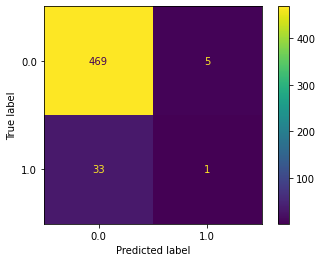

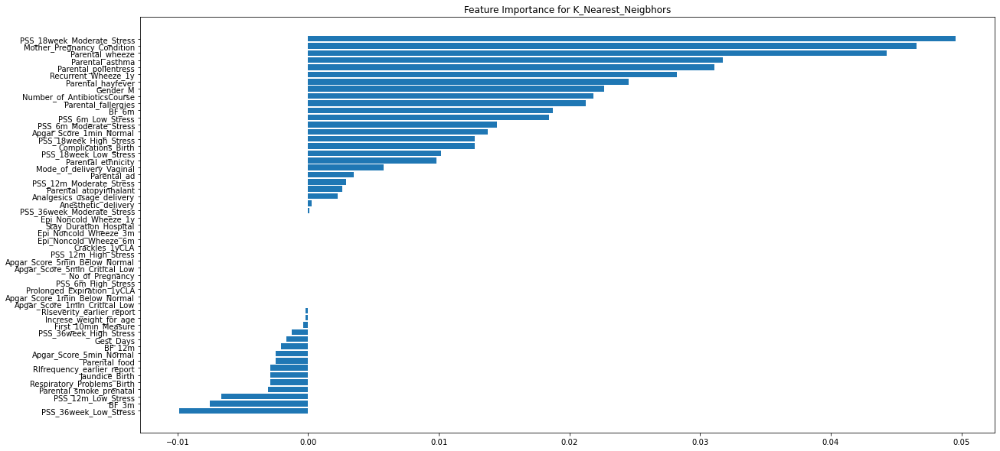

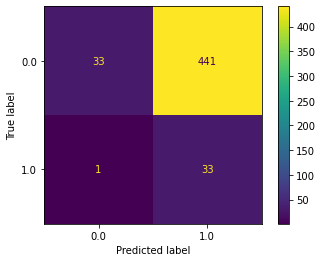

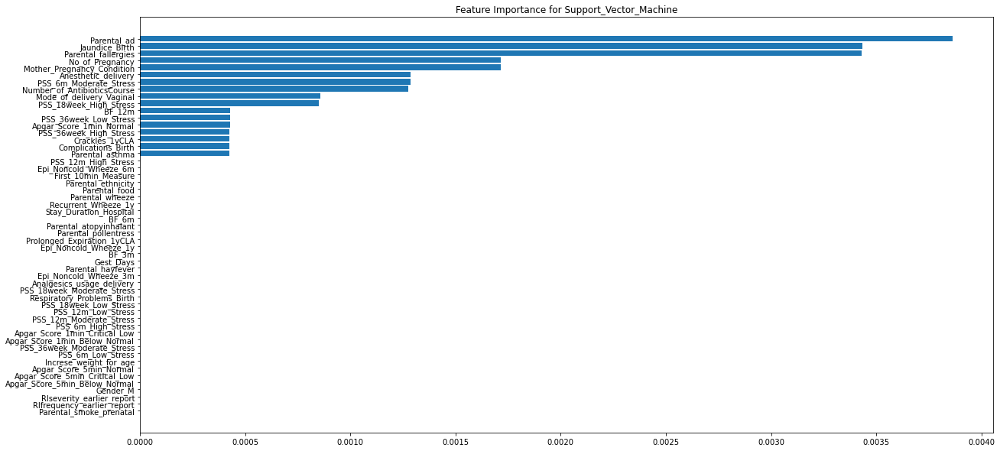

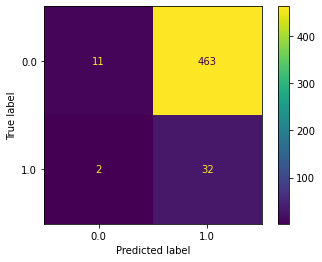

...

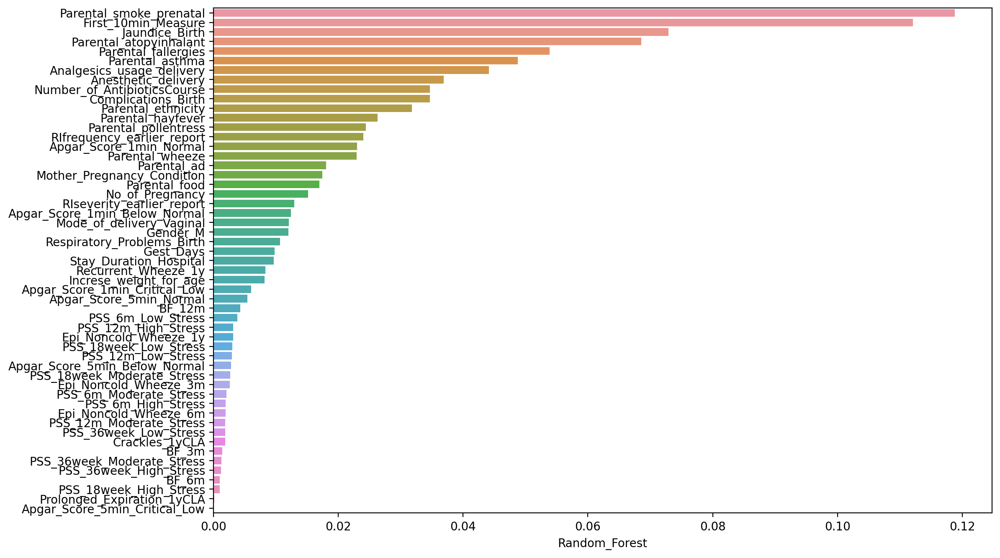

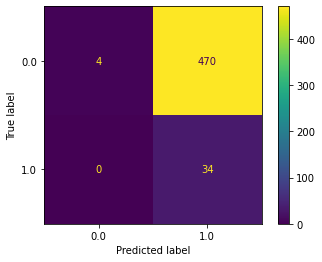

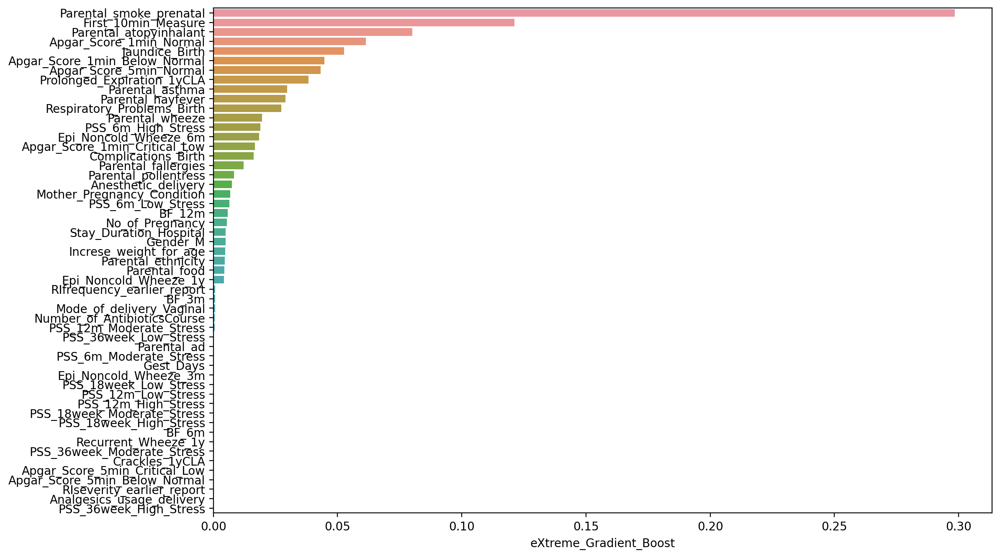

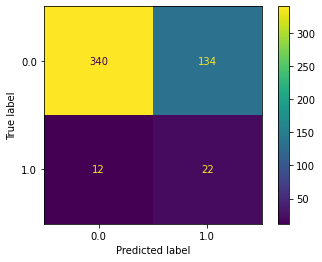

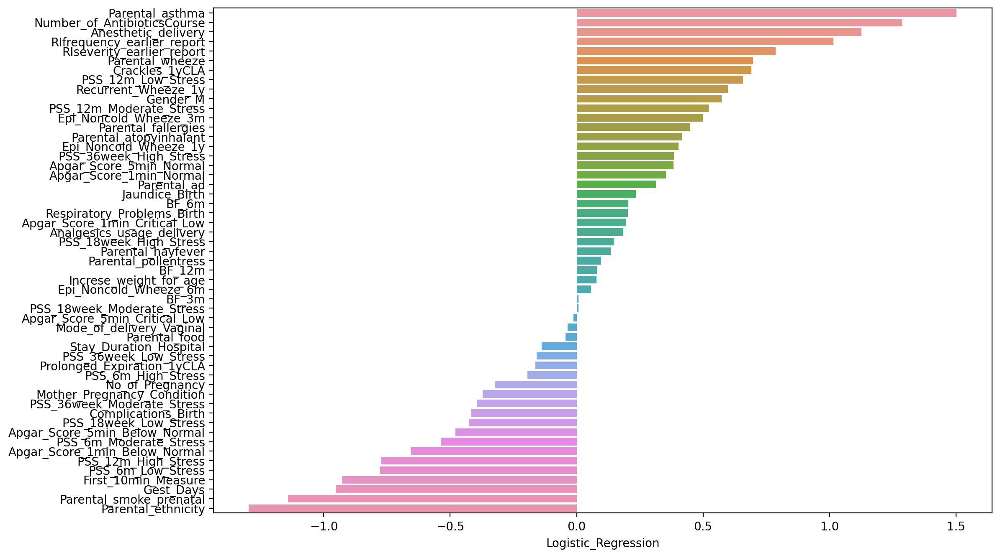

<IPython.core.display.Javascript object>

In [32]:
from imblearn.under_sampling import ClusterCentroids

cc = ClusterCentroids(random_state=5)
X_train_under, y_train_under = cc.fit_resample(X_train, y_train)
y_train_under.value_counts()
ml_result_tuple_cc = df_ml_run(X_train_under, X_test, y_train_under, y_test)

(3) EditedNearestNeighbours applies a nearest-neighbors algorithm and “edit” the dataset by removing samples which do not agree “enough” with their neighboorhood

0.0    1402
1.0     117
Name: y, dtype: int64

confussion matrix: [[473   1]
 [ 34   0]]

The performance score of K_Nearest_Neigbhors: 0.0 

              precision    recall  f1-score   support

         0.0       0.93      1.00      0.96       474
         1.0       0.00      0.00      0.00        34

    accuracy                           0.93       508
   macro avg       0.47      0.50      0.48       508
weighted avg       0.87      0.93      0.90       508

confussion matrix: [[468   6]
 [ 32   2]]

The performance score of Support_Vector_Machine: 9.523809523809524 

              precision    recall  f1-score   support

         0.0       0.94      0.99      0.96       474
         1.0       0.25      0.06      0.10        34

    accuracy                           0.93       508
   macro avg       0.59      0.52      0.53       508
weighted avg       0.89      0.93      0.90       508

confussion matrix: [[ 14 460]
 [  3  31]]

The performance score of Naive_Bayes: 11.80952380952381 

              precision    recall  f1-

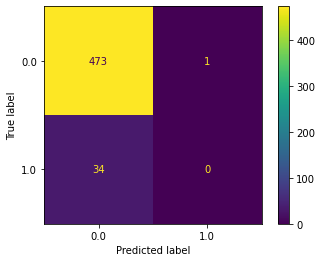

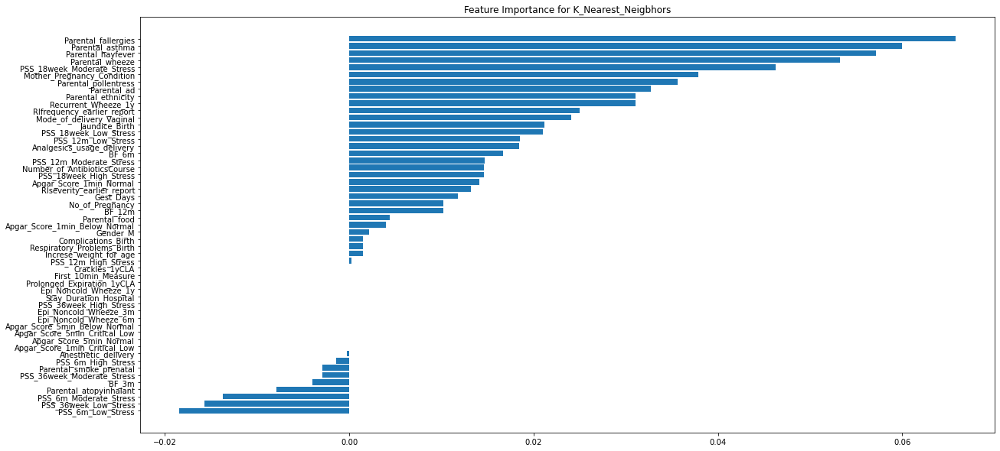

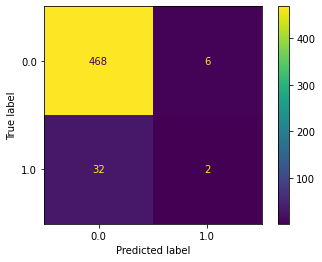

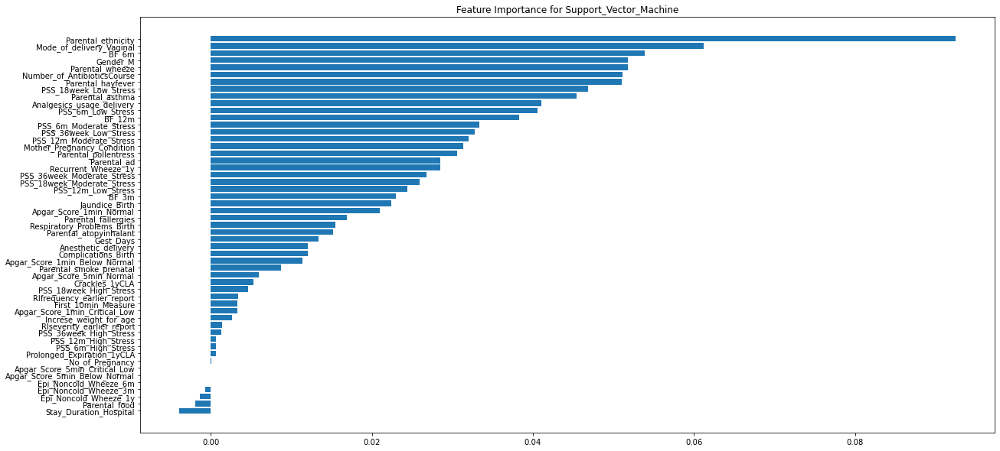

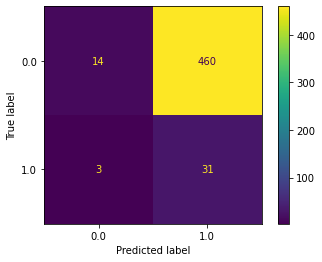

...

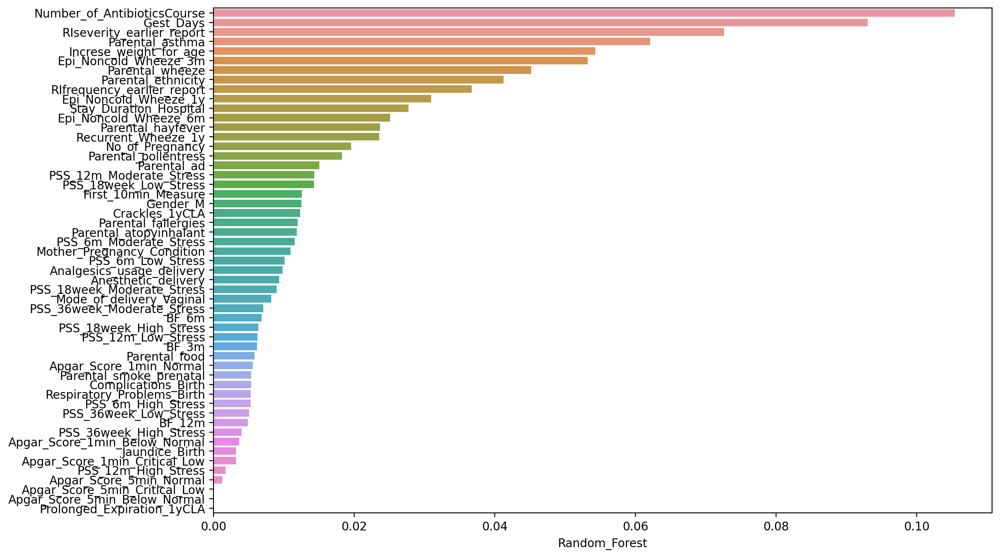

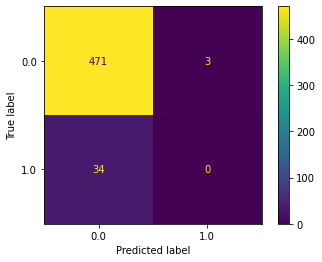

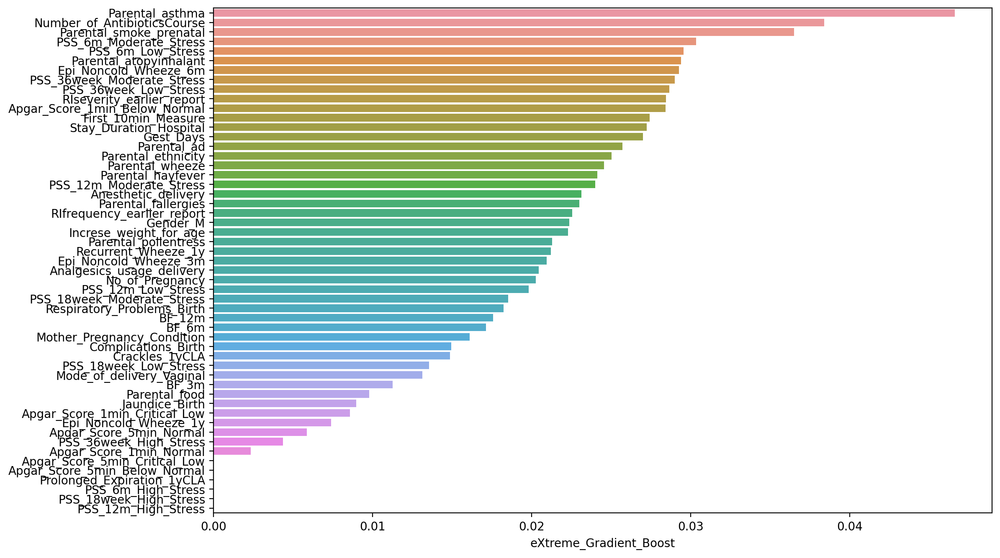

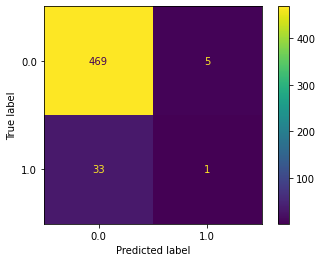

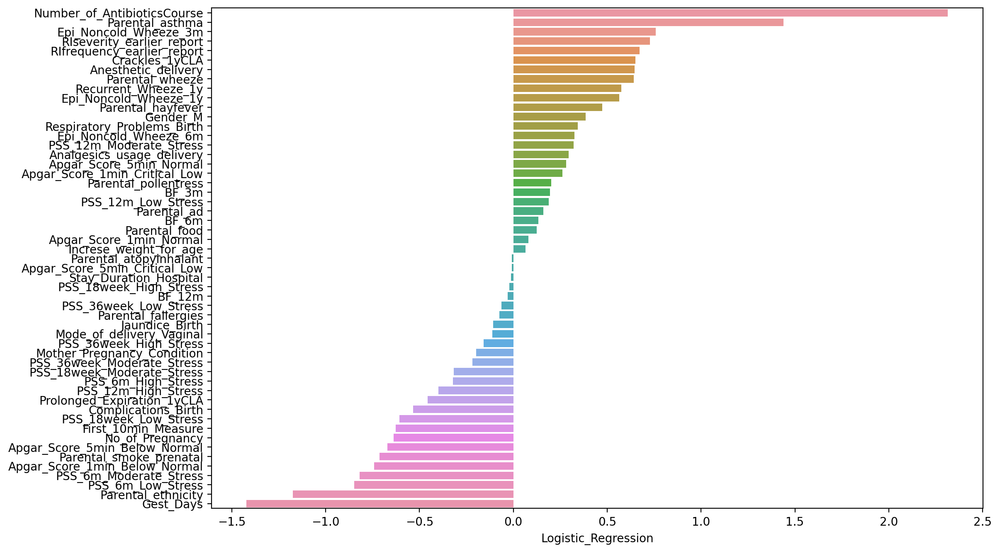

<IPython.core.display.Javascript object>

In [33]:
from imblearn.under_sampling import EditedNearestNeighbours

enn = EditedNearestNeighbours()
X_train_under, y_train_under = enn.fit_resample(X_train, y_train)
y_train_under.value_counts()
ml_result_tuple_enn = df_ml_run(X_train_under, X_test, y_train_under, y_test)

0.0    1337
1.0     117
Name: y, dtype: int64

confussion matrix: [[472   2]
 [ 34   0]]

The performance score of K_Nearest_Neigbhors: 0.0 

              precision    recall  f1-score   support

         0.0       0.93      1.00      0.96       474
         1.0       0.00      0.00      0.00        34

    accuracy                           0.93       508
   macro avg       0.47      0.50      0.48       508
weighted avg       0.87      0.93      0.90       508

confussion matrix: [[465   9]
 [ 31   3]]

The performance score of Support_Vector_Machine: 13.043478260869565 

              precision    recall  f1-score   support

         0.0       0.94      0.98      0.96       474
         1.0       0.25      0.09      0.13        34

    accuracy                           0.92       508
   macro avg       0.59      0.53      0.54       508
weighted avg       0.89      0.92      0.90       508

confussion matrix: [[ 14 460]
 [  3  31]]

The performance score of Naive_Bayes: 11.80952380952381 

              precision    recall  f1

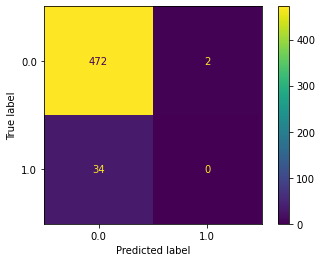

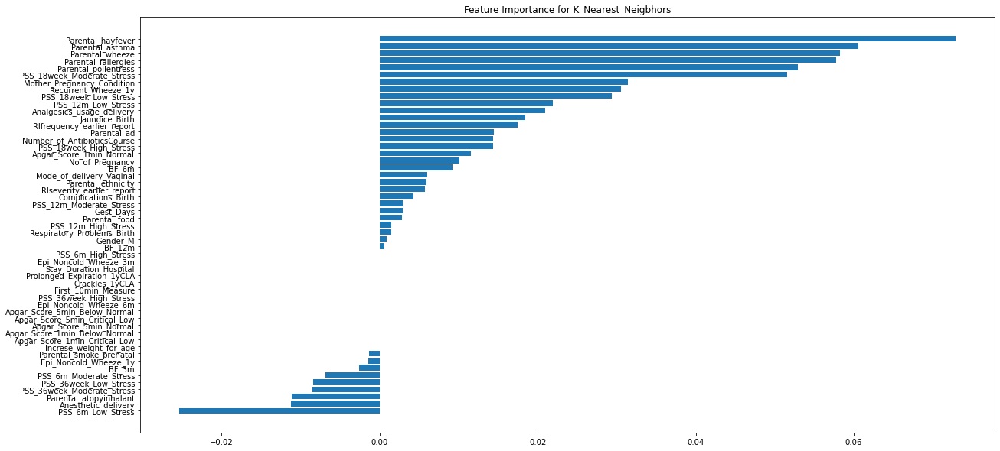

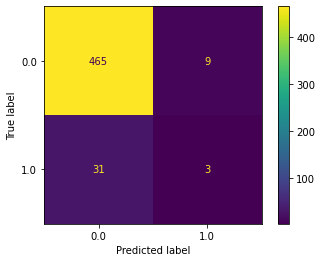

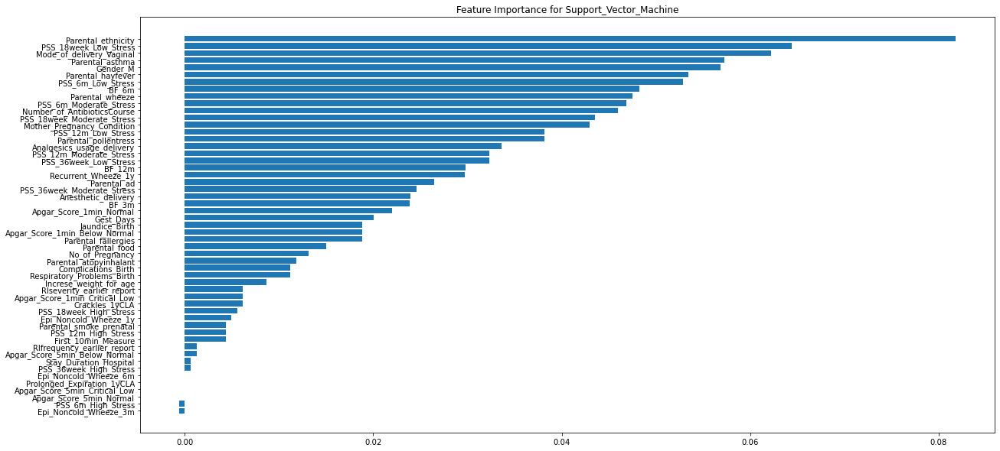

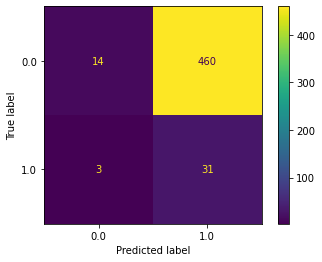

...

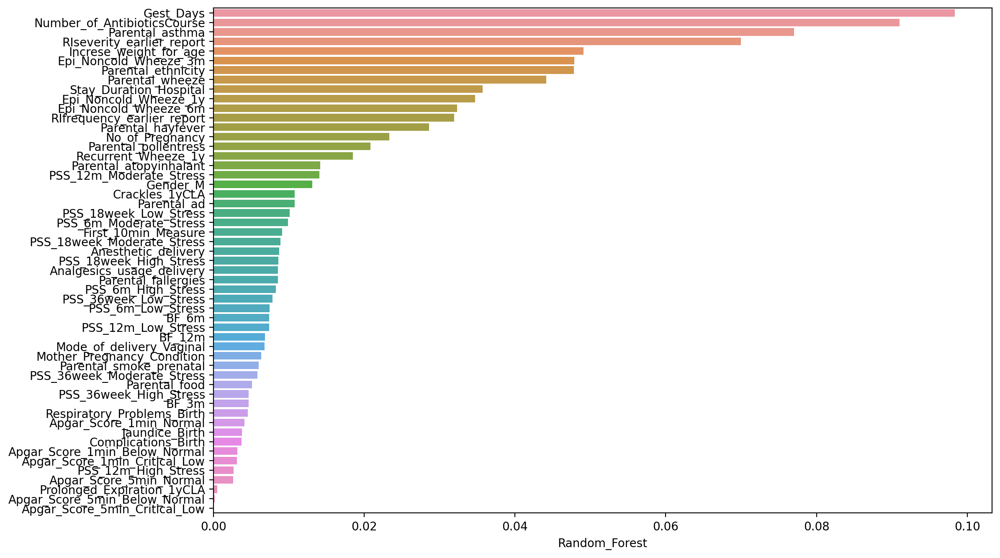

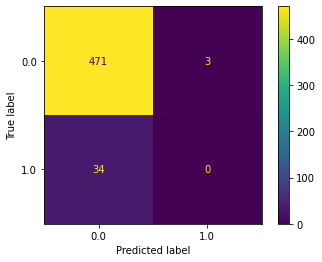

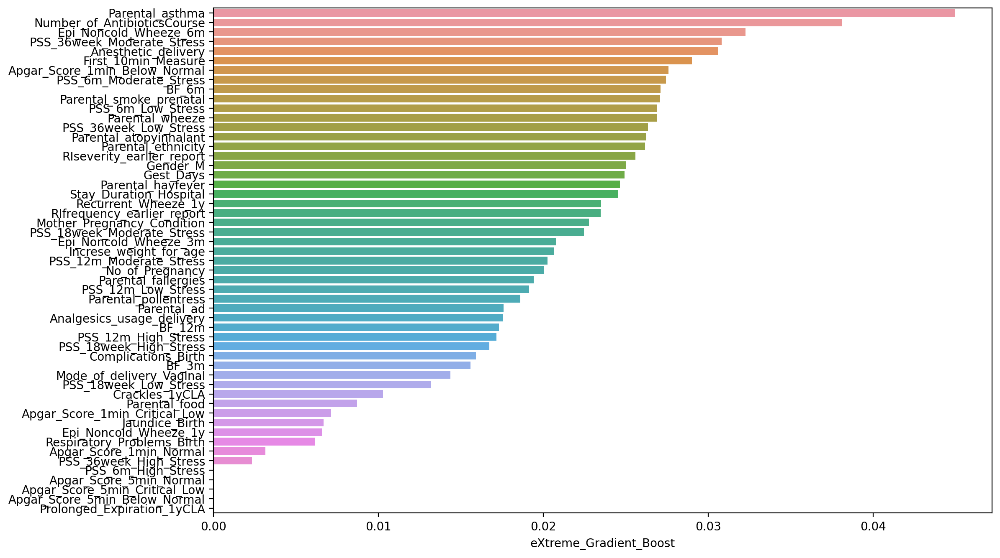

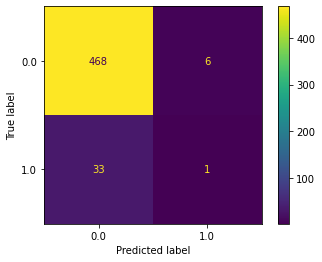

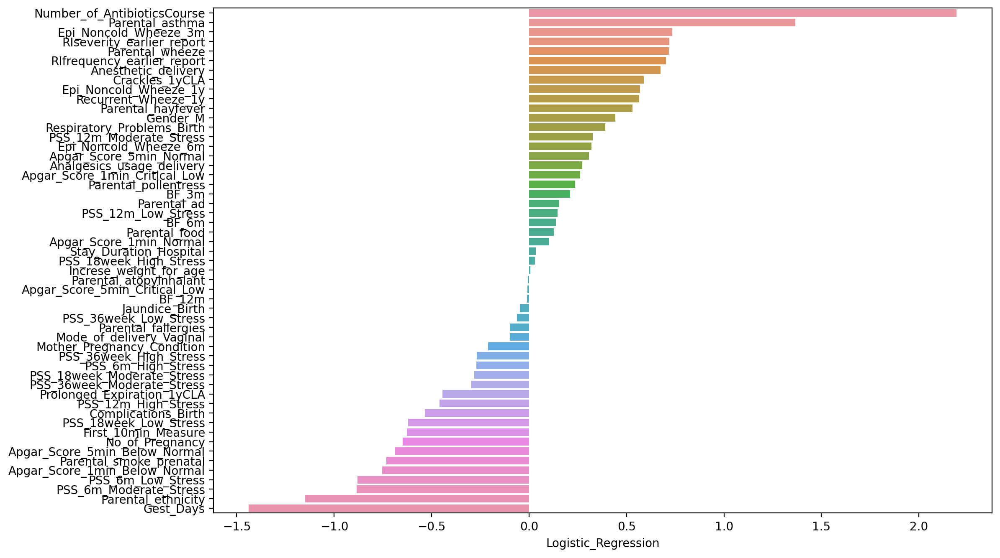

<IPython.core.display.Javascript object>

In [34]:
from imblearn.under_sampling import RepeatedEditedNearestNeighbours

renn = RepeatedEditedNearestNeighbours()
X_train_under, y_train_under = renn.fit_resample(X_train, y_train)
y_train_under.value_counts()
ml_result_tuple_renn = df_ml_run(X_train_under, X_test, y_train_under, y_test)

In [ ]:
from imblearn.under_sampling import TomekLinks

tl = TomekLinks()
X_train_under, y_train_under = tl.fit_resample(X_train, y_train)
y_train_under.value_counts()
ml_result_tuple_tl = df_ml_run(X_train_under, X_test, y_train_under, y_test)

In [ ]:
from imblearn.under_sampling import AllKNN

allknn = AllKNN()
X_train_under, y_train_under = allknn.fit_resample(X_train, y_train)
y_train_under.value_counts()
ml_result_tuple_allknn = df_ml_run(X_train_under, X_test, y_train_under, y_test)

In [ ]:
from imblearn.under_sampling import NeighbourhoodCleaningRule

ncr = NeighbourhoodCleaningRule()
X_train_under, y_train_under = ncr.fit_resample(X_train, y_train)
y_train_under.value_counts()
ml_result_tuple_ncr = df_ml_run(X_train_under, X_test, y_train_under, y_test)

In [ ]:
from imblearn.under_sampling import OneSidedSelection

oss = OneSidedSelection(random_state=0)
X_train_under, y_train_under = oss.fit_resample(X_train, y_train)
y_train_under.value_counts()
ml_result_tuple_oss = df_ml_run(X_train_under, X_test, y_train_under, y_test)

#### Oversampling 

In [ ]:
from imblearn.over_sampling import RandomOverSampler

ros = RandomOverSampler(random_state=0)
X_train_over, y_train_over = ros.fit_resample(X_train, y_train)
y_train_over.value_counts()
ml_result_tuple_ros = df_ml_run(X_train_over, X_test, y_train_over, y_test)

In [ ]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state=0)
X_train_over, y_train_over = smote.fit_resample(X_train, y_train)
y_train_over.value_counts()
ml_result_tuple_smote = df_ml_run(X_train_over, X_test, y_train_over, y_test)

In [ ]:
from imblearn.over_sampling import ADASYN

adasyn = ADASYN(random_state=0)
X_train_over, y_train_over = adasyn.fit_resample(X_train, y_train)
y_train_over.value_counts()
ml_result_tuple_adasyn = df_ml_run(X_train_over, X_test, y_train_over, y_test)

#### Combine Over- and Under- Sampling

In [ ]:
from imblearn.combine import SMOTEENN

sme = SMOTEENN(random_state=42)
X_train_comb, y_train_comb = sme.fit_resample(X_train, y_train)
y_train_comb.value_counts()
ml_result_tuple_comb = df_ml_run(X_train_comb, X_test, y_train_comb, y_test)

In [ ]:
from imblearn.combine import SMOTETomek

smt = SMOTETomek(random_state=42)
X_train_comb, y_train_comb = smt.fit_resample(X_train, y_train)
y_train_comb.value_counts()
ml_result_tuple_smt = df_ml_run(X_train_comb, X_test, y_train_comb, y_test)

#### Ensemble

In [ ]:
X_test_backup = X_test.copy()
y_test_backup = y_test.copy()

In [ ]:
# Restore X_test, y_test
X_test = X_test_backup.copy()
y_test = y_test_backup.copy()

In [ ]:
rus_2 = RandomUnderSampler(random_state=42)
X_test, y_test = rus_2.fit_resample(X_test, y_test)

In [ ]:
y_test.value_counts()

In [ ]:
from imblearn.ensemble import EasyEnsembleClassifier

y_train.value_counts()
eec = EasyEnsembleClassifier(random_state=42)
eec.fit(X_train, y_train)
predicted = eec.predict(X_test)
plot_confusion_matrix(eec, X_test, y_test)
print(f1_score(y_test, predicted))
print(classification_report(y_test, predicted))

#### Lasso Observation

In [ ]:
# Automatic Alphas with StratifiedKfold
skf = StratifiedKFold(n_splits=2, shuffle=True, random_state=1015)
model = LassoLarsCV(cv=skf).fit(X, y)

fig, ax = plt.subplots(figsize=(20, 12))
columns_of_total = X.shape[1]
start = 0
end = X.shape[1]
number_of_display = end - start

cm = iter(plt.get_cmap("Set1")(np.linspace(0, 1, number_of_display)))
for i in range(start, end):
    c = next(cm)
    _ = ax.plot(
        model.alphas_, model.coef_path_.T[:, i], c=c, alpha=0.8, label=X.columns[i]
    )


lassocv_df = pd.DataFrame(
    data=model.coef_path_.T, columns=X.columns, index=model.alphas_
)

y_pos_ser = lassocv_df.iloc[-1:].T.iloc[:, 0][lassocv_df.iloc[-1:].T.iloc[:, 0] != 0]
x_pos = float(lassocv_df.iloc[-1:].T.columns.values)
x_pos_list = [x_pos for i in range(len(y_pos_ser))]

for x_t, y_t, text in zip(x_pos_list, y_pos_ser.values, y_pos_ser.index):
    axtxt = ax.text(
        x_t - 0.00005,
        y_t,
        text,  # Used to format it K representation
        color="black",
        rotation="horizontal",
        size="large",
    )

#ax.legend(X.columns[start:end], bbox_to_anchor=(1, 1))

plt.xlim([0.00035, 0.00125])
plt.ylabel("Lasso Regression CV")
plt.xlabel("Regularization Factor - Alphas")
plt.title("Regression Coefficient Progression for Lasso Path")

#fig.savefig("../images/lasso_progression",dpi=300,bbox_inches='tight')


In [ ]:
view_y_proportions(
    df_for_ml, lassocv_df.sum()[lassocv_df.sum() != 0].sort_values().index, 0.5
)

In [ ]:
coef_dict = {}
for alp in tqdm(np.arange(0.000001, 0.0009, 0.000005)):
    lasso_model = Lasso(alpha=alp).fit(X, y)
    coef_dict[alp] = list(lasso_model.coef_)

res = pd.DataFrame(data=coef_dict.values(), columns=X.columns, index=coef_dict.keys()).T

In [ ]:
# For those with bitter coefficient (impact)
res[0.000001][abs(res[0.000001]) > 0.05].sort_values().index
view_y_proportions(
    df_for_ml, res[0.000001][abs(res[0.000001]) > 0.05].sort_values().index, 0.5
)

In [ ]:
# sns.color_palette("YlOrBr", as_cmap=True)
fig, ax = plt.subplots(figsize=(40, 30))
sns.heatmap(res.iloc[:, :], vmax=0.2, vmin=-0.2, cmap="vlag", ax=ax)

#### Mutual Information Observation

In [ ]:
mic = mutual_info_classif(X, y, random_state=1)
fig, ax = plt.subplots(figsize=(12, 13.5))
mic_df = (
    pd.DataFrame({"feature": X.columns, "vimp": mic})
    .set_index("feature")
    .sort_values(by="vimp", ascending=True)
)
mic_df[mic_df.vimp != 0].shape[0]
mic_df[mic_df.vimp != 0].plot.barh(ax=ax)
mic_df[mic_df.vimp != 0].index.values

#### Chi-Square/F-test 

In [ ]:
clf = Pipeline([("chi2", SelectPercentile(chi2)), ("rfc", RandomForestClassifier())])

skf = StratifiedKFold(n_splits=2, shuffle=True, random_state=1024)
# #############################################################################
# Plot the cross-validation score as a function of percentile of features
score_means = list()
score_stds = list()
percentiles = (1, 5, 10, 15, 20, 30, 40, 60, 80, 90, 100)

for percentile in tqdm(percentiles):
    clf.set_params(chi2__percentile=percentile)
    this_scores = cross_val_score(clf, X, y, cv=skf, scoring="f1_macro")
    score_means.append(this_scores.mean())
    score_stds.append(this_scores.std())


plt.figure(figsize=(12, 8))
plt.errorbar(percentiles, score_means, np.array(score_stds))
plt.title(
    "Performance of the RandomForest-Chi2 varying the percentile of features selected"
)
plt.xticks(np.linspace(0, 100, 11, endpoint=True))
plt.xlabel("Percentile")
plt.ylabel("F1 macro Score")
plt.axis("tight")
plt.show()

In [ ]:
chi_perc = SelectPercentile(chi2, percentile=30)
chi_perc.fit_transform(X, y)

# X.columns[chi_perc.get_support()]
chi_perc.get_feature_names_out()
len(chi_perc.get_feature_names_out())

chi2_res = pd.DataFrame(
    [list(chi_perc.pvalues_), list(chi_perc.scores_)],
    index=["P_value", "Scores"],
    columns=X.columns,
).T

chi2_res[chi2_res.P_value < 0.05].sort_values("Scores", ascending=False)

view_y_proportions(df_refined, chi2_res[chi2_res.P_value < 0.05].index, 0)

#### Recursive Feature Elimination

In [ ]:
res_index = res[0.000001][abs(res[0.000001]) > 0.08].sort_values().index
res_index
lasso_index = lassocv_df.sum()[lassocv_df.sum() != 0].index
lasso_index

In [ ]:
from yellowbrick.model_selection import RFECV

res_index = res[0.000001][abs(res[0.000001]) > 0.08].sort_values().index

lasso_index = lassocv_df.sum()[lassocv_df.sum() != 0].index

cv = StratifiedKFold(2)
# visualizer = RFECV(RandomForestClassifier(), cv=cv, scoring="average_precision")
# visualizer1 = RFECV(RandomForestClassifier(), cv=cv, scoring="precision_weighted")
visualizer = RFECV(RandomForestClassifier(), cv=cv, scoring="f1_macro")
visualizer.fit(
    X[list(set(list(res_index) + list(lasso_index)))], y
)  # Fit the data to the visualizer
visualizer.show()  # Finalize and render the figure

In [ ]:
print(
    f"The original feature matrix is:\n {X[list(set(list(res_index) + list(lasso_index)))].iloc[1].index}"
)
print(
    f"\n\nThe feature matrix that generated the maximal precision are:\n{X[list(set(list(res_index) + list(lasso_index)))].iloc[1].index[visualizer.support_]}"
)

pd.DataFrame(
    data=visualizer.ranking_,
    index=X[list(set(list(res_index) + list(lasso_index)))].columns,
    columns=["ranking"],
).sort_values(by="ranking")

In [ ]:
from yellowbrick.model_selection import RFECV

res_index = res[0.000001][abs(res[0.000001]) > 0.05].sort_values().index

lasso_index = lassocv_df.sum()[lassocv_df.sum() != 0].index

cv = StratifiedKFold(2)
# visualizer = RFECV(RandomForestClassifier(), cv=cv, scoring="average_precision")
# visualizer1 = RFECV(RandomForestClassifier(), cv=cv, scoring="precision_weighted")
visualizer = RFECV(LogisticRegression(), cv=cv, scoring="f1_macro")
visualizer.fit(
    X[list(set(list(res_index) + list(lasso_index)))], y
)  # Fit the data to the visualizer
visualizer.show()  # Finalize and render the figure

In [ ]:
print(
    f"The original feature matrix is:\n {X[list(set(list(res_index) + list(lasso_index)))].iloc[1].index}"
)
print(
    f"\n\nThe feature matrix that generated the maximal precision are:\n{X[list(set(list(res_index) + list(lasso_index)))].iloc[1].index[visualizer.support_]}"
)

pd.DataFrame(
    data=visualizer.ranking_,
    index=X[list(set(list(res_index) + list(lasso_index)))].columns,
    columns=["ranking"],
).sort_values(by="ranking")

#### SelectFromModel

In [ ]:
sfm = SelectFromModel(estimator=XGBClassifier())
sfm.fit(X, y)

sfm.get_feature_names_out()

X.columns[sfm.get_support()]
sfm.estimator_.feature_importances_

coef_ser = pd.Series(
    sfm.estimator_.feature_importances_.reshape(len(X.columns),),
    index=X.columns,
    name="feature_importance",
)
coef_ser = coef_ser[abs(coef_ser) > 0.003]

importance = np.abs(coef_ser.values)
feature_names = np.array(coef_ser.index)
plt.figure(figsize=(12, 18))
plt.barh(width=importance, y=feature_names)
plt.title("Feature importances via XGBClassifier")
plt.xticks(rotation=90)
plt.show()

In [ ]:
sfm = SelectFromModel(estimator=LassoCV(cv=skf))
sfm.fit(X, y)

sfm.get_feature_names_out()

X.columns[sfm.get_support()]
sfm.estimator_.coef_

coef_ser = pd.Series(
    sfm.estimator_.coef_.reshape(len(X.columns),), index=X.columns, name="coef"
)
coef_ser = coef_ser[abs(coef_ser) > 0]

importance = np.abs(coef_ser.values)
feature_names = np.array(coef_ser.index)
plt.bar(height=importance, x=feature_names)
plt.title("Feature importances via Lasso Regression")
plt.xticks(rotation=90)
plt.show()

In [ ]:
# Fast ML Run

In [ ]:
X_train, X_test, X_holdout, y_train, y_test, y_holdout = df_split(
    df_refined, balancing="None", split_random_state=2
)

In [ ]:
ml_result_tuple = df_ml_run(X_train, X_test, y_train, y_test)

In [ ]:
ml_result_tuple[0]
ml_result_tuple[1]
ml_result_tuple[2]

In [ ]:
X_train, X_test, X_holdout, y_train, y_test, y_holdout = df_split(
    df_refined[list(set(list(res_index) + list(lasso_index) + list("y")))],
    balancing="Under",
    split_random_state=3,
)

In [ ]:
ml_result_tuple = df_ml_run(X_train, X_test, y_train, y_test)

In [ ]:
ml_result_tuple[1].

In [ ]:
ml_result_tuple[1]

In [ ]:
rfe_columns = X_train.columns[visualizer.support_]

In [ ]:
from sklearn.model_selection import StratifiedKFold
from yellowbrick.model_selection import RFECV

cv = StratifiedKFold(2)
# visualizer = RFECV(RandomForestClassifier(), cv=cv, scoring="average_precision")
# visualizer1 = RFECV(RandomForestClassifier(), cv=cv, scoring="precision_weighted")
visualizer = RFECV(RandomForestClassifier(), cv=cv, scoring="f1_weighted")
visualizer.fit(X_train, y_train)  # Fit the data to the visualizer
visualizer.show()  # Finalize and render the figure

In [ ]:
df_baseline = df_targeted[FEATURE_SELECTED_BASELINE]

In [ ]:
# Basic engineering of Gender and Mode of Delivery
df_baseline.Gender = df_baseline.Gender.replace({"F": 0, "M": 1})
df_baseline.Mode_of_delivery = df_baseline.Mode_of_delivery.replace(
    {6: 0, 7: 0, 8: 0, 9: 0, 1: 1, 2: 1, 3: 1, 4: 1, 11: 1}
)

In [ ]:
df_baseline_imputed = df_simpleimputer_scaled(df_baseline)

In [ ]:
def df_split(
    df,
    balancing="None",
    holdout_ratio=0.25,
    sampling_random_state=8,
    holdout_random_state=8,
    split_random_state=8,
    split_ratio=0.2,
):
    """Generate X_train, X_test, X_holdout, y_train, y_test, y_holdout for machine learning
    :param df: DataFrame that has been engineered, imputed, and scaled
    :param balancing: string, 'None', 'Over', 'Under'
    :param holdout_ratio: float
    :param sampling_random_state: integer
    :param holdout_random_state: integer
    :param split_random_state: integer
    :param split_ratio: float
    :return: Split dataframe ready to be trained, tested

    --------------------------------------------------------
    Examples:
    X_train, X_test, X_holdout, y_train, y_test, y_holdout = df_split(df=df)
    """

    # Holdout for final model test
    holdout_df_withtarget1 = df[df.y == 1].sample(
        frac=holdout_ratio, replace=False, random_state=holdout_random_state
    )
    holdout_df_withtarget0 = df[df.y == 0].sample(
        frac=holdout_ratio, replace=False, random_state=holdout_random_state
    )
    holdout_df = pd.concat([holdout_df_withtarget0, holdout_df_withtarget1])
    X_holdout = holdout_df.drop("y", 1)
    y_holdout = holdout_df["y"]

    # Model will be tuned using the rest samples
    df_rest = pd.concat(
        [df, holdout_df_withtarget1, holdout_df_withtarget0]
    ).drop_duplicates(keep=False)

    X = df_rest.drop("y", 1)
    y = df_rest.y

    # Begin split
    if balancing == "None":
        X_train, X_test, y_train, y_test = train_test_split(
            X, y, test_size=split_ratio, stratify=y, random_state=split_random_state
        )
    elif balancing == "Under":
        undersampler = RandomUnderSampler(
            sampling_strategy="majority", random_state=sampling_random_state
        )
        X_under, y_under = undersampler.fit_resample(X, y)
        X_train, X_test, y_train, y_test = train_test_split(
            X_under,
            y_under,
            test_size=split_ratio,
            stratify=y_under,
            random_state=split_random_state,
        )
    elif balancing == "Over":
        X_train, X_test, y_train, y_test = train_test_split(
            X, y, test_size=split_ratio, stratify=y, random_state=split_random_state
        )
        oversampler = RandomOverSampler(
            sampling_strategy="minority", random_state=sampling_random_state
        )
        X_train, y_train = oversampler.fit_resample(X_train, y_train)
        X_test, y_test = oversampler.fit_resample(X_test, y_test)

    else:
        print("Wrong input of 'balancing', please see docstring")
        return

    return X_train, X_test, X_holdout, y_train, y_test, y_holdout

In [ ]:
X_train, X_test, X_holdout, y_train, y_test, y_holdout = df_split(
    df=df_baseline_imputed, balancing="Under"
)
ml_result_tuple = df_ml_run(X_train, X_test, y_train, y_test)

ml_result_tuple[0]
ml_result_tuple[1]

## Reproduce previous performance

In [ ]:
df_previous = df_raw[
    [
        "Gender",
        "Mode_of_delivery",
        "Anesthetic_delivery",
        "Prolonged_Expiration_1yCLA",
        "Crackles_1yCLA",
        "Wheeze_1yCLA",
        "Mother_Asthma",
        "Father_Asthma",
        "Parental_Asthma",
        "Mom_Atopy",
        #        "Mom_Inhalant",
        "Wheeze_Mother",
        "Hayfever_Mother",
        "Pollentress_Mother",
        "FAllergies_Mother",
        "Wheeze_Father",
        "Hayfever_Father",
        "AD_Father",
        "Pollentress_Father",
        "Number_of_AntibioticsCourse",
        "Antibiotics_Usage",
        #        "Home_DEHP_3m",
        "Gest_Days",
        "Apgar_Score_5min",
        #         "Epi_Noncold_Wheeze_3m",
        "Asthma_Diagnosis_5yCLA",
    ]
]

# Define target & Basic Engineer of Gender, and Delivery
df_previous_5y = df_previous[
    (df_previous.Asthma_Diagnosis_5yCLA.notna())
    & (df_previous.Asthma_Diagnosis_5yCLA != 2)
].rename(columns={"Asthma_Diagnosis_5yCLA": "y"})
df_previous_5y.Gender = df_previous_5y.Gender.replace({"F": 0, "M": 1})
df_previous_5y.Mode_of_delivery = df_previous_5y.Mode_of_delivery.replace(
    {6: 0, 7: 0, 8: 0, 9: 0, 1: 1, 2: 1, 3: 1, 4: 1, 11: 1}
)

# See correlation heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(df_previous_5y.corr())

df = df_simpleimputer_scaled(df_previous_5y)
df

In [ ]:
X_train, X_test, X_holdout, y_train, y_test, y_holdout = df_split(
    df,
    balancing="Under",
    holdout_ratio=0.2,
    sampling_random_state=3,
    holdout_random_state=3,
    split_random_state=4,
    split_ratio=0.3,
)
y_train.value_counts()
y_test.value_counts()
y_holdout.value_counts()

ml_res = df_ml_run(X_train, X_test, y_train, y_test)
ml_res[0]
ml_res[1]

In [ ]:
df = df_previous_ml.rename(columns={"Asthma_Diagnosis_5yCLA": "y"}).copy()


# Holdout for test
holdout_df_withtarget1 = df[df.y == 1].sample(frac=0.25, replace=False, random_state=1)
holdout_df_withtarget1.shape
holdout_df_withtarget0 = df[df.y == 0].sample(frac=0.04, replace=False, random_state=1)
holdout_df_withtarget0.shape
holdout_df = pd.concat([holdout_df_withtarget0, holdout_df_withtarget1])
holdout_df

# Define X and y
df_rest = pd.concat(
    [df, holdout_df_withtarget1, holdout_df_withtarget0]
).drop_duplicates(keep=False)
df_rest.shape

X = df_rest.drop("y", 1)
y = df_rest.y

X = pd.DataFrame(
    MinMaxScaler().fit_transform(X), columns=X.columns, index=X.index,
).copy()

# Undersampling
from imblearn.under_sampling import RandomUnderSampler

# define undersample strategy
undersample = RandomUnderSampler(sampling_strategy="majority", random_state=1)
# fit and apply the transform
X_under, y_under = undersample.fit_resample(X, y)
y_under.value_counts()


# Libraries
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    confusion_matrix,
    accuracy_score,
    roc_curve,
    classification_report,
    f1_score,
    precision_score,
    recall_score,
    roc_auc_score,
)
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC

from sklearn.inspection import permutation_importance

X_train, X_test, y_train, y_test = train_test_split(
    X_under, y_under, test_size=0.2, stratify=y_under, random_state=0
)
X_train.columns
y_test.value_counts()


m1 = "Logistic Regression"
lr = LogisticRegression()
model = lr.fit(X_train, y_train)
lr_predict = lr.predict(X_test)
lr_conf_matrix = confusion_matrix(y_test, lr_predict)
lr_prec_score = precision_score(y_test, lr_predict)
print("confussion matrix")
print(lr_conf_matrix)
print("\n")
print("Precison of Logistic Regression:", lr_prec_score * 100, "\n")
print(classification_report(y_test, lr_predict))
lr.coef_


features_imp = lr.coef_.reshape((-1, 1))
imp_features = pd.DataFrame(
    index=X.columns, data=features_imp, columns=["Logistic Regression Coefficient"]
)
imp_features.sort_values(
    "Logistic Regression Coefficient", ascending=False, inplace=True
)
plt.figure(figsize=(12, 8), dpi=200)
sns.barplot(
    data=imp_features,
    y=imp_features.index,
    x=imp_features["Logistic Regression Coefficient"],
)

In [ ]:
from imblearn.over_sampling import RandomOverSampler

# define oversampling strategy
oversample = RandomOverSampler(sampling_strategy="minority")
# fit and apply the transform
X_over, y_over = oversample.fit_resample(X_train, y_train)

y_over.value_counts()
X_over_test, y_over_test = oversample.fit_resample(X_test, y_test)

In [ ]:
from sklearn.metrics import plot_confusion_matrix

# Logistic Regression

In [ ]:
lr.coef_.reshape(1, -1)[0]

In [ ]:
result.importances_mean.reshape(1, -1)[0]

In [ ]:
result.importances_mean.reshape(1, -1)[0]

In [ ]:
lr.coef_.reshape(1, -1)[0]

In [ ]:
pd.DataFrame(
    [lr.coef_.reshape(1, -1)[0], result.importances_mean.reshape(1, -1)[0]],
    columns=X_test.columns,
    index=["LR", "NB"],
).T.sort_values(by="LR", ascending=False)

In [ ]:
lr.coef_

In [ ]:
result.importances_mean

In [ ]:
model_feature =

In [ ]:
# pd.merge(imp_features_lr, imp_features_NB)
res = imp_features_lr.join(imp_features_NB)

In [ ]:
from sklearn.preprocessing import RobustScaler

In [ ]:
# Scaling through normalize the max impact to be 1
for col in res.columns:
    res[col] = res[col] / res[col].max()


In [ ]:
res

In [ ]:
res.rename(
    columns={"Logistic Regression Coefficient": "Logistic_Regression_Coefficient"},
    inplace=True,
)

In [ ]:
res_performance = {}
res_performance["Logistic_Regression_Coefficient"] = 0.6
res_performance["GaussianNB_Permutation_Importance"] = 0.7

In [ ]:
m = [res[col].values * score for col, score in list(res_performance.items())]

In [ ]:
m

In [ ]:
res["Weighted_importance"] = sum(m)
res["Weighted_importance"] = (
    res["Weighted_importance"] / res["Weighted_importance"].max()
)

In [ ]:
res

In [ ]:
res_performance
res['Weighted_importance'] = res[col] + res[]

In [ ]:
RobustScaler().fit_transform(res)

In [ ]:
StandardScaler().fit_transform(res)

# Random Forest Classfier

In [ ]:
m3 = "Random Forest Classfier"
rf = RandomForestClassifier(n_estimators=20, random_state=12, max_depth=5)
rf.fit(X_train, y_train)
rf_predicted = rf.predict(X_test)
rf_conf_matrix = confusion_matrix(y_test, rf_predicted)
rf_prec_score = precision_score(y_test, rf_predicted)
rf_auc_score = roc_auc_score(y_test, rf_predicted)
print("confussion matrix")
print(rf_conf_matrix)
print("\n")
print("Precision of Random Forest:", rf_prec_score * 100, "\n")
print("ROC_AUC of Random Forest:", rf_auc_score * 100, "\n")
print(classification_report(y_test, rf_predicted))

In [ ]:
imp_features_lr = imp_features.copy()

In [ ]:
rf.feature_importances_.reshape(1, -1)[0]

In [ ]:
features_imp = rf.feature_importances_
imp_features = pd.DataFrame(index=X.columns, data=features_imp, columns=["importance"])
imp_features.sort_values("importance", ascending=False, inplace=True)
plt.figure(figsize=(12, 8), dpi=200)
sns.barplot(data=imp_features, y=imp_features.index, x=imp_features["importance"])

In [ ]:
m4 = "K-NeighborsClassifier"
knn = KNeighborsClassifier(n_neighbors=12)
knn.fit(X_train, y_train)
knn_predicted = knn.predict(X_test)
knn_conf_matrix = confusion_matrix(y_test, knn_predicted)
knn_prec_score = precision_score(y_test, knn_predicted)
print("confussion matrix")
print(knn_conf_matrix)
print("\n")
print("Precison of K-NeighborsClassifier:", knn_prec_score * 100, "\n")
print(classification_report(y_test, knn_predicted))

In [ ]:
knn.

In [ ]:
mm = "55"

In [ ]:
scoring = "f1_score"

In [ ]:
vars()[scoring]

In [ ]:
m5 = "DecisionTreeClassifier"
dt = DecisionTreeClassifier(criterion="entropy", random_state=0, max_depth=6)
dt.fit(X_train, y_train)
dt_predicted = dt.predict(X_test)
dt_conf_matrix = confusion_matrix(y_test, dt_predicted)
dt_prec_score = precision_score(y_test, dt_predicted)
print("confussion matrix")
print(dt_conf_matrix)
print("\n")
print("Precison of DecisionTreeClassifier:", dt_prec_score * 100, "\n")
print(classification_report(y_test, dt_predicted))

In [ ]:
m6 = "Support Vector Classifier"
svc = SVC(kernel="rbf", C=6)
svc.fit(X_train, y_train)
svc_predicted = svc.predict(X_test)
svc_conf_matrix = confusion_matrix(y_test, svc_predicted)
svc_prec_score = precision_score(y_test, svc_predicted)
print("confussion matrix")
print(svc_conf_matrix)
print("\n")
print("Precison of Support Vector Classifier:", svc_prec_score * 100, "\n")
print(classification_report(y_test, svc_predicted))

In [ ]:
m7 = "Extreme Gradient Boost"
xgb = XGBClassifier(
    learning_rate=0.01,
    n_estimators=25,
    max_depth=15,
    gamma=0.6,
    subsample=0.52,
    colsample_bytree=0.6,
    seed=27,
    reg_lambda=2,
    booster="dart",
    colsample_bylevel=0.6,
    colsample_bynode=0.5,
)
xgb.fit(X_train, y_train)
xgb_predicted = xgb.predict(X_test)
xgb_conf_matrix = confusion_matrix(y_test, xgb_predicted)
xgb_prec_score = precision_score(y_test, xgb_predicted)
print("confussion matrix")
print(xgb_conf_matrix)
print("\n")
print("Precison of Extreme Gradient Boost:", xgb_prec_score * 100, "\n")
print(classification_report(y_test, xgb_predicted))

In [ ]:
features_imp = xgb.feature_importances_
imp_features = pd.DataFrame(index=X.columns, data=features_imp, columns=["importance"])
imp_features.sort_values("importance", ascending=False, inplace=True)
plt.figure(figsize=(12, 8), dpi=200)
sns.barplot(data=imp_features, y=imp_features.index, x=imp_features["importance"])

In [ ]:
model_ev = pd.DataFrame(
    {
        "Model": [
            "Logistic Regression",
            "Naive Bayes",
            "Random Forest",
            "K-Nearest Neighbour",
            "Decision Tree",
            "Support Vector Machine",
            "Extreme Gradient Boost",
        ],
        "Precison": [
            lr_prec_score * 100,
            nb_prec_score * 100,
            rf_prec_score * 100,
            knn_prec_score * 100,
            dt_prec_score * 100,
            svc_prec_score * 100,
            xgb_prec_score * 100,
        ],
    }
)
model_ev.sort_values(by="Precison", ascending=False)

In [ ]:
from collections import defaultdict

score_dict = defaultdict(list)

models = [lr, nb, rf, knn, dt, svc, xgb]
model_names = [
    "Logistic Regression",
    "Naive Bayes",
    "Random Forest",
    "K-Nearest Neighbour",
    "Decision Tree",
    "Support Vector Machine",
    "Extreme Gradient Boost",
]
measurements = [accuracy_score, f1_score, precision_score, recall_score, roc_auc_score]
measurement_names = ["Accuracy", "F1 score", "Precision", "Recall", "AUC"]

for i in range(len(models)):
    score_dict["Model"].append(model_names[i])
    for j in range(len(measurements)):
        score_dict[measurement_names[j]].append(
            measurements[j](y_test, models[i].predict(X_test))
        )

score_df = pd.DataFrame(score_dict)
score_df = score_df.set_index("Model")
score_df.style.background_gradient(cmap="Greens")

In [ ]:
# Run various models
def ml_run(
    X_train, X_test, y_train, y_test, scoring_func=f1_score, importance_scoring="f1"
):
    """
    ML run for a myriad of ML models for predictive modelling and views results
    
    :param scoring_func: a predefined function, default: f1_score
        model_scoring has to be one of accuracy_score, f1_score, precision_score, recall_score, roc_auc_score
        since it must have the same name of sklearn.metrics functions

    :param importance_scoring: string, default: f1
        importance_scoring has to be one of 'accuracy', 'f1', 'precision', 'recall', 'roc_auc',
        since it must be recognizable as a parameter to be put into permutation importance

    :return: Confusion matrix dataframe, model performance, feature importance
    """
    # A dictionary that will store the performance score of models to evaluate feature importance
    model_score = {}
    
    # A dictionary that will store the confusion matrix results as string to easy comparision
    model_cm = {}
    
    # ---------------------------------------------------------------------------
    # Logistic Regression
    # ---------------------------------------------------------------------------
    model_lr = "Logistic_Regression"
    lr = LogisticRegression()
    lr.fit(X_train, y_train)    
    predicted = lr.predict(X_test)
    
    model_score[model_lr] = scoring_func(y_test, predicted)
    model_cm[model_lr] = str(
            {
                k: dict(v)
                for k, v in dict(
                    pd.DataFrame(
                        confusion_matrix(y_test, predicted),
                        columns=["Pred_0", "Pred_1"],
                        index=["True_0", "True_1"],
                    )
                ).items()
            }
        )    

    print(f"confussion matrix: {confusion_matrix(y_test, predicted)}\n")
    print(f"The performance score of Logistic Regression: {model_score[model_lr] * 100} \n")
    print(classification_report(y_test, lr_predict))

    # Define feature importance matrix - for lr 
    imp_features_lr = pd.DataFrame(
        data=lr.coef_.reshape((-1, 1)),
        index=X.columns,
        columns=[model_lr],
    )

    # Only for visualization of feature importance
    imp_features_lr.sort_values(
        model_lr, ascending=False, inplace=True
    )
    plt.figure(figsize=(12, 8), dpi=200)
    sns.barplot(
        data=imp_features_lr,
        y=imp_features_lr.index,
        x=imp_features_lr[model_lr],
    )
    
    
    # ---------------------------------------------------------------------------
    # Logistic Regression
    # ---------------------------------------------------------------------------

In [ ]:
ml_run(X_train, X_test, y_train, y_test, scoring_func=f1_score, importance_scoring="f1")

In [ ]:
from sklearn.metrics import (
    confusion_matrix,
    accuracy_score,
    roc_curve,
    classification_report,
    f1_score,
    precision_score,
    recall_score,
    roc_auc_score,
)

### 1. Previous 1y -> 5y prediction

In [ ]:
# Preferences of autoformatting & Multiple Output
%load_ext nb_black
from IPython.core.interactiveshell import InteractiveShell

InteractiveShell.ast_node_interactivity = "all"
# Preferences - II
import warnings

warnings.filterwarnings("ignore")

import pandas as pd
import seaborn as sns
import numpy as np

#### 1.1 Prepare dataset

In [ ]:
!ls